In [1]:
import pandas as pd
import numpy as np
import seaborn
import matplotlib
import statistics
from sklearn.decomposition import PCA
from sklearn.decomposition import KernelPCA
from sklearn.manifold import TSNE
from sklearn.manifold import MDS
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
import math
import glob
from itertools import combinations
from matplotlib import pyplot as plt
from Bio import Phylo
import biotite
from pca_plot import *
from pyranges import PyRanges

# Documentation 


We got CNV data from 3 softwares; CNVnator, QDNASeq and WiseCondor for the 279 samples of Simmons diversity project.
    
The 279 files of CNVs from CNVnator were merged with this command: 
```
!awk 'BEGIN{OFS="\t"} {print FILENAME,$0}' * > CNVnator_results.txt ```

in /branchinecta/jbazanwilliamson/CNVnator directory 


Telomeres and centromeres coordinates were extracted in Genome Table Browser

Gene anotation was extracted in Genome Table Browser(GENECODE V39/KnownGene)

In [2]:
anotation = pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=1)
telomeres = pd.read_table('../data/telomere_hg38')
centromeres = pd.read_table('../data/centromeres_hg38')
hm3_cnv_data = pd.read_table('../data/hm3_cnv_submission.txt')
header_list = ['Sample_name','Type', 'Position', 'Lenght', 'RD', 'T-TEST-EVAL', 'GAUSSIAN-EVAL', 'T-TEST-EVAL(MIDDLE)','GAUSSIAN-EVAL(MIDDLE)', 'FRAQ-READ-QUALITY' ]
cnvnator_data = pd.read_table('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/CNVnator/CNVnator_results.txt', names=header_list)

telomeres['chrom'] = telomeres['chrom'].str.replace('chr', '')


centromeres['chrom'] = centromeres['chrom'].str.replace('chr', '')

#Table browser is 0-based coordinates, changed to 1-based for compability with CNV data
telomeres['chromStart'] = telomeres['chromStart'] + 1

centromeres['chromStart'] = centromeres['chromStart'] + 1

hm3_cnv_data['chr'] = hm3_cnv_data['chr'].astype(str)

black_header = ['Chromosome','Start', 'End', 'Type']
blacklist = pd.read_table('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/bin_anotation/hg19-blacklist.v2.bed', names=black_header)
blacklist['Chromosome'] = blacklist['Chromosome'].str.replace('chr', '')

blacklist

,Chromosome,Start,End,Type
0,10,38726200,42489100,High Signal Region
1,10,42524900,42819200,High Signal Region
2,10,98560400,98562500,High Signal Region
3,10,135437600,135534700,High Signal Region
4,11,0,196300,High Signal Region
...,...,...,...,...
829,X,154528900,154616300,High Signal Region
830,X,155038500,155270500,High Signal Region
831,Y,7432700,13491000,High Signal Region
832,Y,13633400,14289000,High Signal Region


,Sample_name,Type,Position,Lenght,RD,T-TEST-EVAL,GAUSSIAN-EVAL,T-TEST-EVAL(MIDDLE),GAUSSIAN-EVAL(MIDDLE),FRAQ-READ-QUALITY
1498,LP6005441-DNA_A01,duplication,5:10001-11800,1800.0,96.0883,0.000036,0.000000e+00,1.000000e+00,1.000000e+00,1
1876,LP6005441-DNA_A01,duplication,6:58776201-58779800,3600.0,240.9260,0.000070,8.625340e-114,6.149640e+00,0.000000e+00,1
2549,LP6005441-DNA_A01,duplication,8:46847801-46851800,4000.0,91.0099,0.049930,4.055890e+06,9.104630e+00,1.426030e+04,1
4639,LP6005441-DNA_A01,duplication,16:46385801-46435600,49800.0,105.1270,0.000000,2.562190e+09,0.000000e+00,2.573930e+09,1
5714,LP6005441-DNA_A01,duplication,X:58567001-58582000,15000.0,69.7822,0.000000,2.159930e-147,0.000000e+00,1.415530e-126,1
...,...,...,...,...,...,...,...,...,...,...
2651609,SS6004480,duplication,hs37d5:27031901-27049400,17500.0,54.8327,0.000448,8.002610e+08,6.121430e-04,9.260570e+08,1
2651652,SS6004480,duplication,hs37d5:27807801-27819700,11900.0,52.1034,0.000138,2.434700e+09,1.443290e-02,2.503090e+09,1
2651657,SS6004480,duplication,hs37d5:27899201-27917100,17900.0,51.9522,0.000035,3.555200e-03,7.008020e-05,0.000000e+00,1
2651709,SS6004480,duplication,hs37d5:29143101-29155600,12500.0,56.5016,0.000169,2.573310e+09,2.724670e-02,2.618780e+09,1


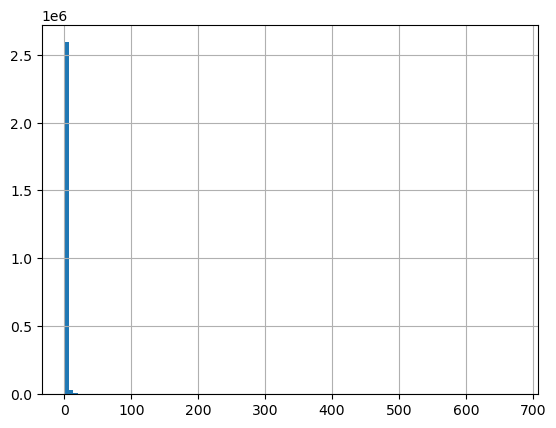

In [3]:
cnvnator_data['RD'].hist(bins=100)
#cnvnator_data['T-TEST-EVAL'].hist(bins=100)
cnvnator_data['Lenght'].describe()

cnvnator_data[cnvnator_data['RD'] > 50]

## Filtration


<AxesSubplot:>

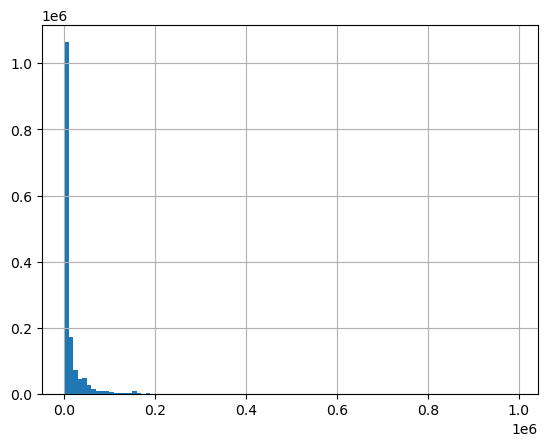

In [4]:
#FILTRATION BY SIGNIFICANCE 

cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL'] <= 0.05]
#cnvnator_data = cnvnator_data[cnvnator_data['T-TEST-EVAL(MIDDLE)'] <= 5.14E-11]

## Filtering by size 
cnvnator_data = cnvnator_data[cnvnator_data['Lenght'] >= 1000] #more than 1kb 
cnvnator_data = cnvnator_data.loc[(cnvnator_data['Lenght'] < 1000000),:] #less than 1 Mb

##GAUSIAN DISTRIBUTION
#deletion = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] < 0.0003]
#duplicatons = cnvnator_data[cnvnator_data['GAUSSIAN-EVAL'] > 4.550540e+04]

cnvnator_data['Lenght'].hist(bins=100)

In [5]:
#SEPARATE COORDINATES
coordinates = cnvnator_data['Position'].str.split(':', expand=True)
CHROMOSOME = coordinates[0]

split_position = coordinates[1].str.split('-', expand=True)
START = split_position[0]
STOP = split_position[1]

cnvnator_style= pd.DataFrame()
cnvnator_style['Sample_ID'] = cnvnator_data['Sample_name']
cnvnator_style['Chromosome'] = CHROMOSOME
cnvnator_style['Start'] = START
cnvnator_style['End'] = STOP
cnvnator_style['CNV_value'] = cnvnator_data['Type']

cnvnator_style['CNV_value'].replace('deletion', 1, inplace=True)
cnvnator_style['CNV_value'].replace('duplication', 3, inplace=True)
cnvnator_style
cnvnator_style['Start'] = cnvnator_style['Start'].astype(int)
cnvnator_style['End'] = cnvnator_style['End'].astype(int)
cnvnator_style['CNV_value'] = cnvnator_style['CNV_value'].astype(float)

cnvnator_style['Type'] = cnvnator_data['Type']

cnvnator_style['RD'] = cnvnator_data['RD']
cnvnator_style['Lenght'] = cnvnator_data['Lenght']
cnvnator_style['T-TEST-EVAL'] = cnvnator_data['T-TEST-EVAL']
cnvnator_style['GAUSSIAN-EVAL'] = cnvnator_data['GAUSSIAN-EVAL']
cnvnator_style


#Removing another reference chromosomes
chromosomes= ['1','2','3','4','5','6','7','8','9','10','11','12','13','14','15','16','17','18','19','20','21','22','X','Y']

cnvnator_style = cnvnator_style[cnvnator_style.Chromosome.isin(chromosomes)]

cnvnator_style.value_counts("Sample_ID")


# NOTE: 
# This result were used as output for CNVR detection for CNVnator

Sample_ID
LP6005592-DNA_G03    98448
LP6005443-DNA_E10    23169
LP6005442-DNA_E04    18722
LP6005443-DNA_F10    12604
SS6004472             6747
                     ...  
LP6005441-DNA_H11     2837
LP6005441-DNA_D11     2808
LP6005442-DNA_H09     2808
LP6005442-DNA_B12     2803
LP6005441-DNA_B12     2775
Length: 279, dtype: int64

In [6]:
#REMOVE SAMPLES WITH ABERRATIONS
samples_with_aberrations = ['LP6005441-DNA_B03', ' LP6005443-DNA_G01', 'LP6005441-DNA_G09', 'LP6005441-DNA_D04'] 

cnvnator_style = cnvnator_style[~cnvnator_style.Sample_ID.isin(samples_with_aberrations)]

cnvnator_style = cnvnator_style
cnvnator_style.value_counts("Sample_ID")

Sample_ID
LP6005592-DNA_G03    98448
LP6005443-DNA_E10    23169
LP6005442-DNA_E04    18722
LP6005443-DNA_F10    12604
SS6004472             6747
                     ...  
LP6005441-DNA_H11     2837
LP6005442-DNA_H09     2808
LP6005441-DNA_D11     2808
LP6005442-DNA_B12     2803
LP6005441-DNA_B12     2775
Length: 276, dtype: int64

In [7]:
## Filter by chromosomes
cnvnator_data_df_x = cnvnator_style[cnvnator_style.Chromosome == 'X']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chromosome != 'Y']
cnvnator_data_df_no_sex_chr = cnvnator_style[cnvnator_style.Chromosome != 'X']

cnvnator_data_df_x


,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
5612,LP6005441-DNA_A01,X,1,60000,1.0,deletion,0.000000,60000.0,2.656210e-12,0.000000e+00
5613,LP6005441-DNA_A01,X,60001,63600,3.0,duplication,1.747000,3600.0,4.427010e-09,1.358200e+00
5614,LP6005441-DNA_A01,X,65501,144900,1.0,deletion,0.050844,79400.0,2.007210e-12,3.474740e-28
5615,LP6005441-DNA_A01,X,155001,156300,3.0,duplication,2.260460,1300.0,1.583960e-02,5.962230e-30
5616,LP6005441-DNA_A01,X,157001,175600,3.0,duplication,1.770210,18600.0,0.000000e+00,2.512670e+09
...,...,...,...,...,...,...,...,...,...,...
2650122,SS6004480,X,154746101,154751600,3.0,duplication,1.605410,5500.0,4.260570e-05,7.501830e+08
2650123,SS6004480,X,154798801,154804000,1.0,deletion,0.315173,5200.0,3.064860e-11,2.713240e+05
2650124,SS6004480,X,154930601,155237300,3.0,duplication,2.051740,306700.0,0.000000e+00,1.357150e-06
2650125,SS6004480,X,155251101,155255500,3.0,duplication,3.818850,4400.0,3.778070e-06,2.850670e+09


In [8]:
# Filter inviduals that have less than 100 CNVs
cnvnator_style#.groupby('Sample_ID').filter(lambda x : (x['Sample_ID'].count()<=2000).any())

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
1,LP6005441-DNA_A01,1,11601,18400,3.0,duplication,1.885520,6800.0,0.000000e+00,2.870330e+09
2,LP6005441-DNA_A01,1,39901,48200,1.0,deletion,0.491248,8300.0,1.920150e-11,1.170970e+04
4,LP6005441-DNA_A01,1,51201,64200,1.0,deletion,0.269762,13000.0,1.225940e-11,7.811940e+03
6,LP6005441-DNA_A01,1,69401,70900,1.0,deletion,0.367025,1500.0,6.353720e-03,3.957490e-06
...,...,...,...,...,...,...,...,...,...,...
2650199,SS6004480,Y,28811601,28819400,3.0,duplication,22.740800,7800.0,0.000000e+00,1.677210e+09
2650201,SS6004480,Y,58819401,58917600,3.0,duplication,152.129000,98200.0,0.000000e+00,3.350000e+08
2650202,SS6004480,Y,58917601,58967800,1.0,deletion,0.020383,50200.0,3.174750e-12,2.871000e+09
2650203,SS6004480,Y,58969301,59034000,3.0,duplication,6.555290,64700.0,0.000000e+00,9.377560e-16


<h2> Removing blacklist regions 

In [9]:
blacklist_ranges = PyRanges(blacklist)
cnvnator_style_ranges = PyRanges(cnvnator_style)
blacklist_ranges

,Chromosome,Start,End,Type
0,1,0,750100,High Signal Region
1,1,814500,845200,High Signal Region
2,1,2052400,2056000,High Signal Region
3,1,2582800,2693900,High Signal Region
4,1,4362200,4364300,High Signal Region
...,...,...,...,...
829,X,154528900,154616300,High Signal Region
830,X,155038500,155270500,High Signal Region
831,Y,7432700,13491000,High Signal Region
832,Y,13633400,14289000,High Signal Region


In [10]:
cnvnator_style_df = cnvnator_style_ranges.overlap(blacklist_ranges, invert=True)
#cnvnator_style_df = cnvnator_style_df.as_df()
cnvnator_style_df#.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,912001,913500,1.0,deletion,0.279937,1500.0,6.982630e-05,3.198940e-15
1,LP6005441-DNA_A01,1,954801,956500,1.0,deletion,0.622383,1700.0,3.328280e-02,2.050770e+04
2,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
3,LP6005441-DNA_A01,1,1223401,1225300,1.0,deletion,0.354554,1900.0,4.901130e-03,1.499170e+07
4,LP6005441-DNA_A01,1,1285401,1286800,1.0,deletion,0.080614,1400.0,6.272450e-08,1.827930e-45
...,...,...,...,...,...,...,...,...,...,...
687608,SS6004480,Y,22494701,22496000,1.0,deletion,0.385241,1300.0,1.351890e-02,8.937770e-05
687609,SS6004480,Y,22497301,22500100,1.0,deletion,0.483505,2800.0,2.311780e-02,1.459540e+09
687610,SS6004480,Y,22507701,22512200,3.0,duplication,4.054850,4500.0,4.986960e-04,1.226960e-04
687611,SS6004480,Y,23901401,23951400,1.0,deletion,0.000130,50000.0,3.187450e-12,0.000000e+00


In [11]:
cnvnator_style_df['RD'].hist(bins=100)
cnvnator_style_df['GAUSSIAN-EVAL'].hist(bins=100)
cnvnator_style_df['T-TEST-EVAL'].describe()

AttributeError: ('PyRanges object has no attribute', 'hist')

AttributeError: ('PyRanges object has no attribute', 'groupby')

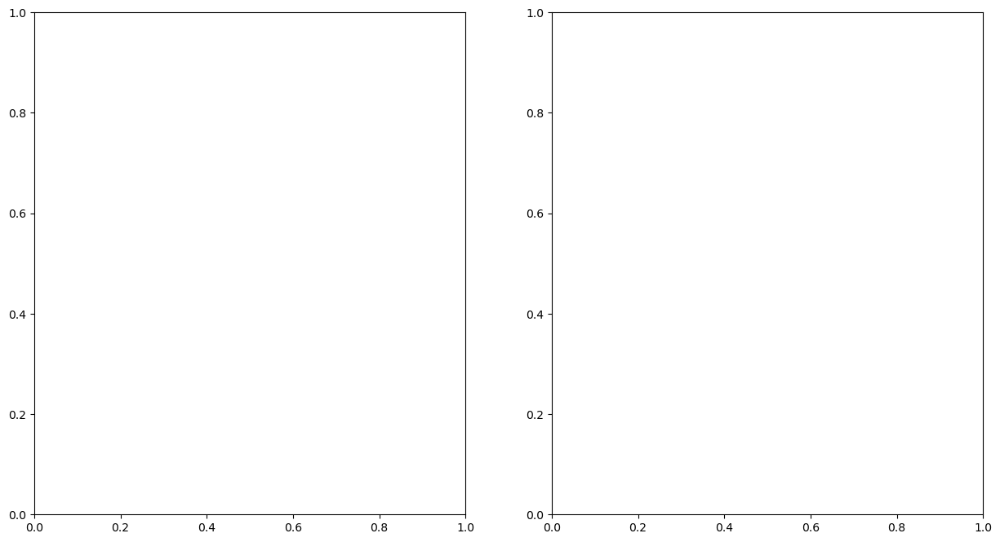

In [12]:
fig, axs = plt.subplots(1, 2, figsize=(15, 8))

df_plot= cnvnator_style_df.groupby(['Type'])['Lenght']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[0]) # alpha for transparency

plt.xscale('log')
#plt.show()

df_plot = cnvnator_style_df.groupby(['Type'])['Lenght']

df_plot.plot(kind='hist',stacked=True, bins=100, legend=True, ax=axs[1]) # alpha for transparency

plt.show()

In [13]:
# SAMPLE TO COMPARE 
samples = cnvnator_style.loc[cnvnator_style['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chromosome']== '1'].head(20)

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
748649,LP6005442-DNA_B01,1,1,10000,1.0,deletion,0.000000,10000.0,1.593730e-11,0.000000e+00
748650,LP6005442-DNA_B01,1,11601,18800,3.0,duplication,2.584290,7200.0,0.000000e+00,2.151340e+09
748651,LP6005442-DNA_B01,1,33701,35000,3.0,duplication,1.776580,1300.0,9.453060e-03,7.643420e-22
748652,LP6005442-DNA_B01,1,45101,76800,3.0,duplication,1.531770,31700.0,0.000000e+00,2.749280e+09
748653,LP6005442-DNA_B01,1,122301,124000,3.0,duplication,1.622440,1700.0,2.902750e-02,2.552690e-04
748654,LP6005442-DNA_B01,1,137401,139700,3.0,duplication,1.829610,2300.0,1.344550e-06,3.399330e-13
748655,LP6005442-DNA_B01,1,177201,227700,1.0,deletion,0.005085,50500.0,3.155890e-12,5.091920e-194
748656,LP6005442-DNA_B01,1,230901,237000,3.0,duplication,1.622360,6100.0,1.065970e-08,5.870810e+03
748657,LP6005442-DNA_B01,1,248701,267400,3.0,duplication,1.300410,18700.0,0.000000e+00,5.179740e+08
748658,LP6005442-DNA_B01,1,267401,318300,1.0,deletion,0.009539,50900.0,3.131090e-12,1.261630e-195


In [14]:
samples = cnvnator_style_df.loc[cnvnator_style_df['Sample_ID'] == "LP6005442-DNA_B01"]
samples.loc[samples['Chromosome']== '4']

AttributeError: ('PyRanges object has no attribute', 'loc')

<h1> Adaptative introgression paper data 
    
https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6860971/

In [15]:
#pd.set_option('display.max_rows', 400)


archaic_data = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/NIHMS1057227-CNVs.csv')
archaic_data = archaic_data.drop(columns=['name'])

header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
archaic_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_anotation.csv', names=header, index_col=3)

papers_names_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_cnv_anotation.csv', index_col=0)

archaic_data['Chromosome'] = archaic_data['chr'].str.replace('chr', '')
archaic_data = archaic_data.drop(columns=['chr'])
first_column = archaic_data.pop('Chromosome')
archaic_data.insert(0, 'Chromosome', first_column)
#archaic_data#['MEL_Papuan_HGDP00554_F']

a = archaic_anotation.merge(papers_names_anotation, left_index=True, right_index=True)
a = a.set_index("Biosample")
b= pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1',  index_col=0)
c = a.merge(b, left_index=True, right_index=True)
c = c.set_index("Sample")
c = c.loc[:,["Region", "Country", "3-Illumina_ID"]]


archaic_data.loc[archaic_data['Chromosome'] == '1'].sort_values(by='start').head(100)

,Chromosome,start,end,AFR_BantuSEHerero_HGDP01028_M,AFR_BantuSEHerero_HGDP01035_M,AFR_BantuKenya_HGDP01414_F,AFR_BantuKenya_HGDP01417_M,AFR_BantuSETswana_HGDP01030_M,AFR_BantuSETswana_HGDP01034_M,AFR_Biaka_HGDP00457_M,...,Pongo_abelii.SB550_Sibu,Pongo_pygmaeus.A939_Nonja,Pongo_pygmaeus.A942_Gusti,Pongo_pygmaeus.A943_Tilda,Pongo_pygmaeus.A944_Napoleon,Pongo_pygmaeus.KB4204_Dinah,Pongo_pygmaeus.KB5404_Billy,Pongo_pygmaeus.KB5405_Louis,Pongo_pygmaeus.KB5406_Doris,Pongo_pygmaeus.KB5543_Baldy
4,1,228416,267160,25.356205,26.947875,21.402028,25.119371,33.538046,26.208535,27.854900,...,1.755784,1.789332,1.999602,1.819331,1.627895,1.772766,1.798521,1.943588,1.570548,1.682988
12,1,521526,568203,17.875750,16.406981,15.916677,14.211191,19.301836,16.930978,15.724644,...,1.892335,1.638105,2.045797,1.794610,1.664672,1.814563,1.833169,1.636279,1.932070,1.646897
13,1,563872,572534,592.654016,875.917401,814.583338,1230.985097,815.557291,985.870941,616.571378,...,17.363798,21.377159,25.211293,21.957171,20.817677,21.065862,131.051664,72.480488,98.266840,10.111808
29,1,899742,901754,1.687674,1.908226,1.612003,1.943254,1.892704,1.885649,1.831222,...,1.668851,0.393950,0.436527,0.459743,0.742526,1.631311,1.355506,1.677574,1.552956,1.763860
56,1,974768,978161,1.723267,1.738481,1.735712,1.518285,1.500395,1.698948,1.784821,...,2.248982,0.572580,0.429163,0.446511,0.476026,2.277004,1.326295,2.170298,1.422584,1.692004
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
391,1,17231801,17255960,4.327506,4.056273,4.234895,4.519720,5.473090,5.346427,3.926636,...,3.137796,2.916423,2.959828,3.349385,3.128180,3.472536,3.737584,3.728429,3.436526,3.013456
406,1,17593888,17624343,2.033922,1.929866,1.902173,2.040466,1.892829,2.028957,1.951667,...,2.245410,2.170467,2.627667,2.427087,2.458161,2.084938,2.187453,2.156249,2.100986,2.000427
410,1,18810014,18811469,1.772283,2.065152,1.996543,1.896283,1.991792,1.973519,1.755632,...,1.745370,2.053511,2.516821,2.040989,2.425419,2.356334,1.936186,2.176461,2.260968,1.987367
428,1,19741516,19743850,2.080887,1.766208,1.922307,2.060330,2.144232,1.907029,2.244147,...,2.101368,1.959792,1.961492,1.803808,2.014573,1.883629,1.978415,2.129439,1.806490,1.595120


In [16]:
counts = archaic_data.iloc[:,3:254]
counts = counts.T 
counts = c.merge(counts, left_index=True, right_index=True)
counts = counts.set_index("3-Illumina_ID")
counts = counts.drop(columns=['Region', 'Country'])

counts_a = counts.T
#counts_a
#counts_a['LP6005442-DNA_B01'].sort_values()

In [17]:
counts = archaic_data
counts = counts.T 
counts = c.merge(counts, left_index=True, right_index=True)
counts = counts.set_index("3-Illumina_ID")
counts = counts.drop(columns=['Region', 'Country'])

counts = counts.T

counts.insert(0, 'Chromosome', archaic_data['Chromosome'])
counts.insert(1, 'Start', archaic_data['start'])
counts.insert(2, 'End', archaic_data['end'])

same_name_archaic =  counts
same_name_archaic

3-Illumina_ID,Chromosome,Start,End,LP6005519-DNA_C05,LP6005442-DNA_B01,LP6005443-DNA_B10,LP6005441-DNA_F09,LP6005442-DNA_G01,LP6005441-DNA_D07,LP6005441-DNA_A04,...,LP6005519-DNA_B06,LP6005677-DNA_F01,LP6005441-DNA_H09,LP6005441-DNA_B11,LP6005441-DNA_D02,LP6005441-DNA_H07,LP6005441-DNA_D06,LP6005443-DNA_H01,LP6005441-DNA_A06,LP6005592-DNA_B01
0,1,21910306,21913877,2.401028,1.998262,1.99382,1.954707,1.954912,1.744118,1.974834,...,1.985123,1.808764,1.852649,1.8203,1.768439,1.837633,1.829354,1.853747,1.975165,1.78793
1,1,101212616,101214920,2.016179,2.002721,1.957054,2.004279,1.92147,1.917796,2.127451,...,1.860985,1.935829,1.841631,1.828189,1.951551,1.964953,2.027913,2.04401,2.04998,2.031175
2,1,147384646,147386567,2.139658,1.747312,1.877853,1.727462,1.933126,2.134733,1.815096,...,1.860781,1.816506,1.817291,2.038003,2.068898,1.77547,1.944979,2.065557,1.83025,1.841507
3,1,195013533,195020996,2.346854,1.804865,1.996412,1.94836,1.825581,1.814401,1.905848,...,1.889087,1.59252,1.762702,1.806363,1.819496,1.025321,2.155907,1.949125,1.678309,1.772575
4,1,228416,267160,28.275513,22.632874,25.19126,25.47146,25.607324,26.130299,24.47818,...,25.270744,26.448447,21.417776,26.617903,24.307306,27.64258,28.186419,27.282453,25.899915,19.172355
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5130,22,31678952,31682546,2.192174,2.10464,1.983139,1.790199,1.739021,2.016616,2.079623,...,2.020915,2.075747,2.271578,2.12772,1.929148,1.953169,1.945864,2.001003,1.931213,1.803273
5131,22,32112132,32113222,2.268124,1.905573,1.59166,1.93206,2.0577,2.037391,1.956664,...,1.662585,1.85905,1.835675,2.17907,1.904821,2.000083,1.873114,1.847847,1.921276,1.763232
5132,22,50252755,50261847,2.383905,2.145915,2.18008,1.865969,2.096408,2.019804,2.063512,...,1.877926,1.976315,2.017628,1.91006,1.940184,1.798868,1.840821,1.947781,2.076042,1.991117
5133,22,33050377,33056621,2.362471,1.908293,1.98927,1.937375,1.909353,1.810818,1.891251,...,2.011201,1.9498,2.013586,1.913698,1.801449,1.97971,1.9702,1.94429,1.829112,2.022726


In [18]:
count = counts_a.T
#features = archaic_anotation.merge(count, left_index=True, right_index=True)
#features = features.loc[:,["Region", "Country"]]
#features

#imputation and normalization 
imp = SimpleImputer(missing_values=np.nan, strategy='mean')
X = imp.fit_transform(counts_a.T)

x = StandardScaler().fit_transform(X)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=count.index)




df_pca = anotation.merge(df_pca, left_index=True, right_index=True)
df_pca

,2-ena_id,4-reich_id,5-ena_ftp_bam_ptr,6-Sequencing_Panel,7-Gender,8-Population_ID,9-Contributor,10-Region,11-Country,12-Town,...,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
3-Illumina_ID,,,,,,,,,,,,,,,,,,,,,
LP6005443-DNA_B06,SAMEA3302859,S_Icelandic-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...,C,F,Icelandic,Coriell,WestEurasia,Iceland,Cell_line_repository_sampling_location_unknown,...,-2.064271,1.268795,7.582690,-5.185535,-7.447556,1.596381,-4.004878,-5.905261,-3.162426,-2.405749
LP6005442-DNA_D08,SAMEA3302837,S_Icelandic-1,ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...,C,F,Icelandic,Coriell,WestEurasia,Iceland,Cell_line_repository_sampling_location_unknown,...,-6.634009,2.742635,4.229136,-4.668586,-8.644561,2.062876,-4.173370,-6.220340,-2.552730,2.785929
LP6005441-DNA_D07,SAMEA3302616,S_Makrani-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324870/LP6005...,C,F,Makrani,Howard Cann,SouthAsia,Pakistan,?,...,-14.023536,6.777031,12.867001,-4.697996,-5.955991,0.993445,-1.199326,0.302613,-3.612099,5.493540
LP6005441-DNA_C07,SAMEA3302771,S_Makrani-1,ftp.sra.ebi.ac.uk/vol1/ERZ312/ERZ312785/LP6005...,C,M,Makrani,Howard Cann,SouthAsia,Pakistan,?,...,-8.518061,5.182573,12.797774,-10.492917,-8.230364,0.710195,2.231050,-2.850502,-0.188765,-4.634354
LP6005442-DNA_F12,SAMEA3302764,S_Tubalar-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324267/LP6005...,C,F,Tubalar,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Artybash and Kebezen, Altai-Sayan Upland",...,-4.072285,-3.532626,-15.023071,3.220266,-0.393450,0.265467,-1.930237,-1.538084,1.718161,-6.525963
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005441-DNA_H06,SAMEA3302662,S_Karitiana-2,ftp.sra.ebi.ac.uk/vol1/ERZ312/ERZ312827/LP6005...,C,F,Karitiana,Howard Cann,America,Brazil,?,...,-10.391385,4.163947,8.757112,12.066631,2.791701,0.065846,-0.128339,14.950991,-4.671546,-6.962437
LP6005441-DNA_H10,SAMEA3302766,S_Russian-2,ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125631/srt.al...,C,F,Russian,Howard Cann,WestEurasia,Russia,Vologda Administrative Region,...,-13.943043,8.615522,16.901374,-2.208598,-9.165552,2.825861,-5.806622,-0.141962,-3.240336,1.439514
LP6005519-DNA_A06,SAMEA3302692,S_Burmese-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324351/LP6005...,C,M,Burmese,Toomas Kivisild / Joseph Wee Tien Seng,EastAsia,Myanmar,Yangon (sampled in Singapore),...,-0.836253,-8.722601,-14.597678,1.457794,-0.912955,-4.683471,5.070260,-7.603825,6.855916,-7.628422


                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia           ftp.sra.ebi.ac.uk/vol1/E

Count of groups by factor: 7
                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia      

                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia           ftp.sra.ebi.ac.uk/vol1/E

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia           ftp.sra.ebi.ac.uk/vol1/E

                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia           ftp.sra.ebi.ac.uk/vol1/E

Count of groups by factor: 7
                        2-ena_id     4-reich_id  \
10-Region                                         
WestEurasia         SAMEA3302859  S_Icelandic-2   
WestEurasia         SAMEA3302837  S_Icelandic-1   
SouthAsia           SAMEA3302616    S_Makrani-2   
SouthAsia           SAMEA3302771    S_Makrani-1   
CentralAsiaSiberia  SAMEA3302764    S_Tubalar-1   
...                          ...            ...   
America             SAMEA3302662  S_Karitiana-2   
WestEurasia         SAMEA3302766    S_Russian-2   
EastAsia            SAMEA3302692    S_Burmese-2   
EastAsia            SAMEA3302895    S_Burmese-1   
Africa              SAMEA3302716      S_Mbuti-2   

                                                    5-ena_ftp_bam_ptr  \
10-Region                                                               
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324295/LP6005...   
WestEurasia         ftp.sra.ebi.ac.uk/vol1/ERZ125/ERZ125657/srt.al...   
SouthAsia      

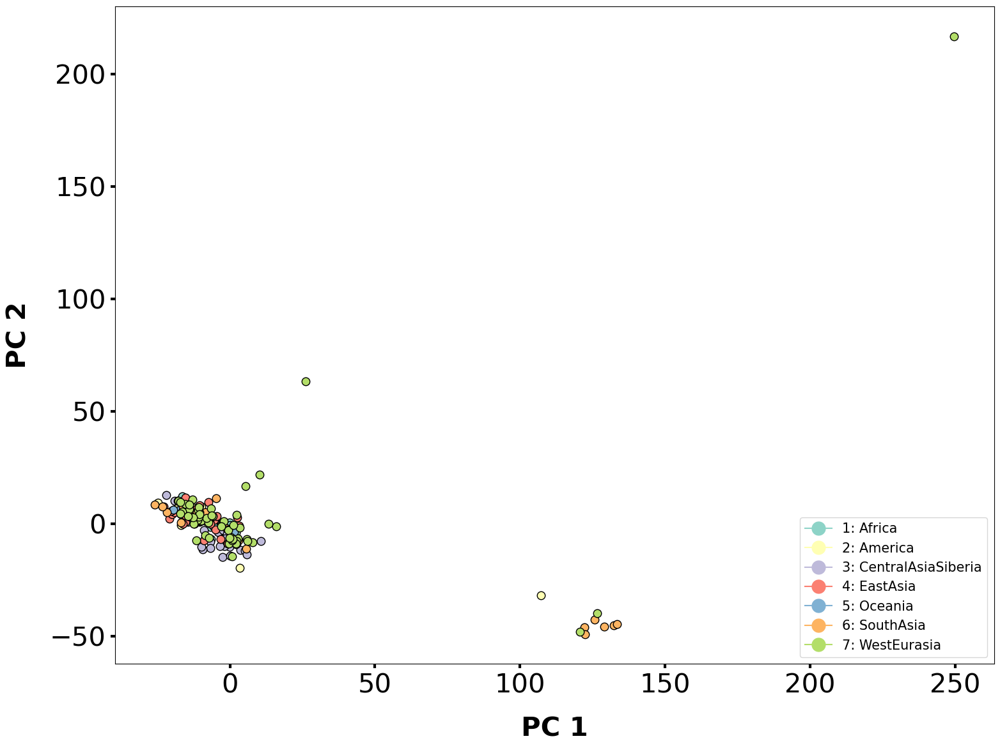

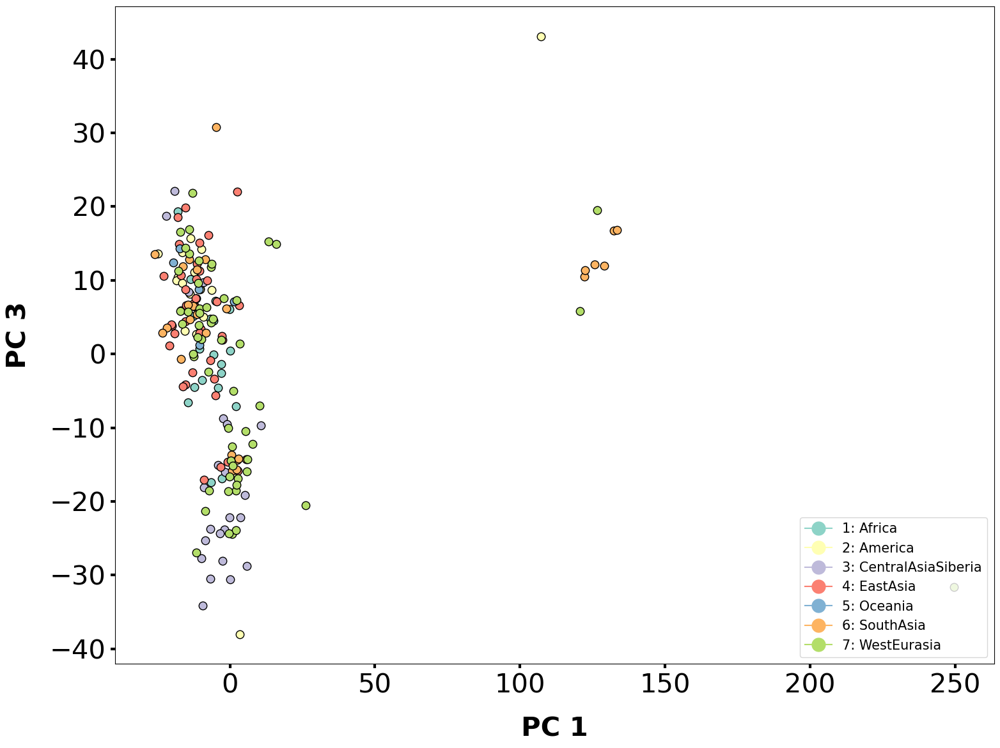

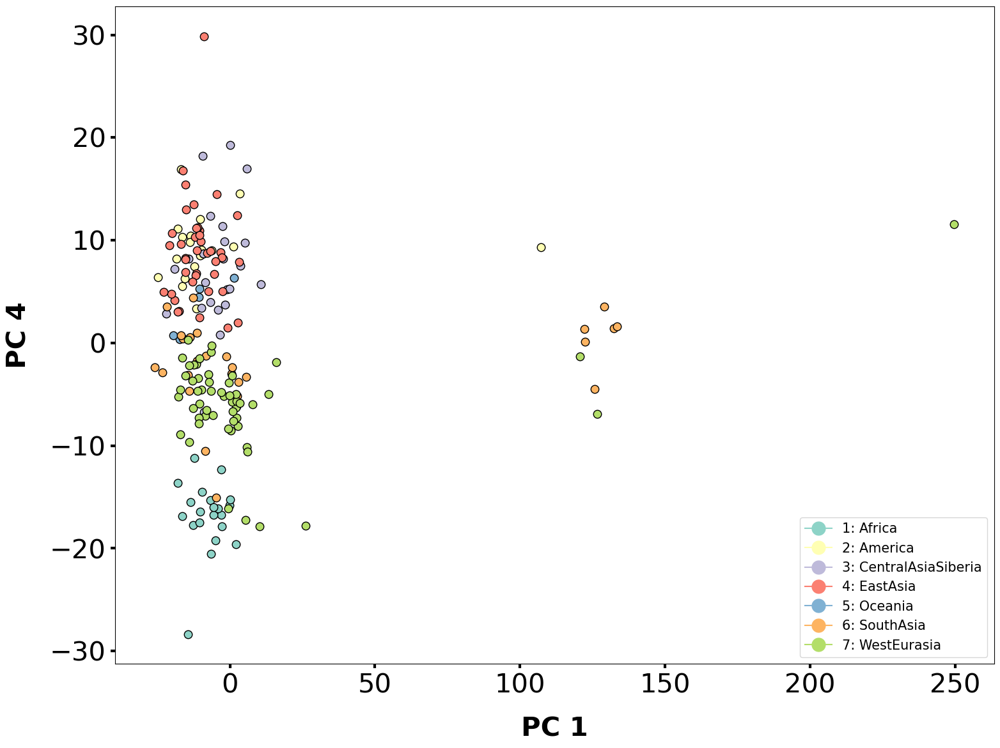

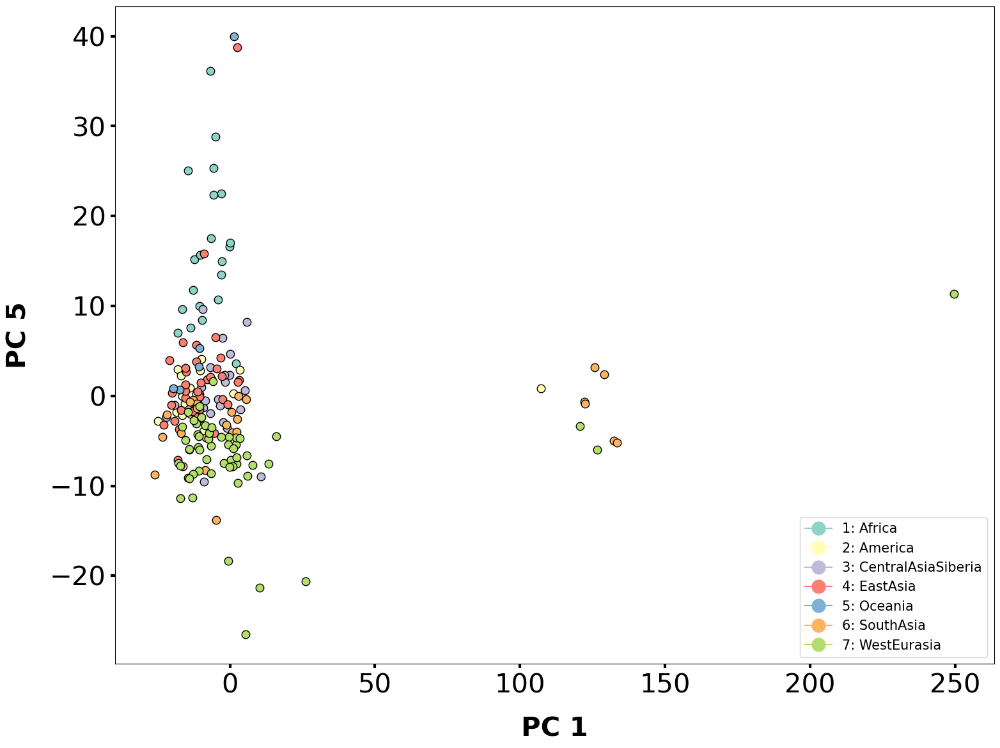

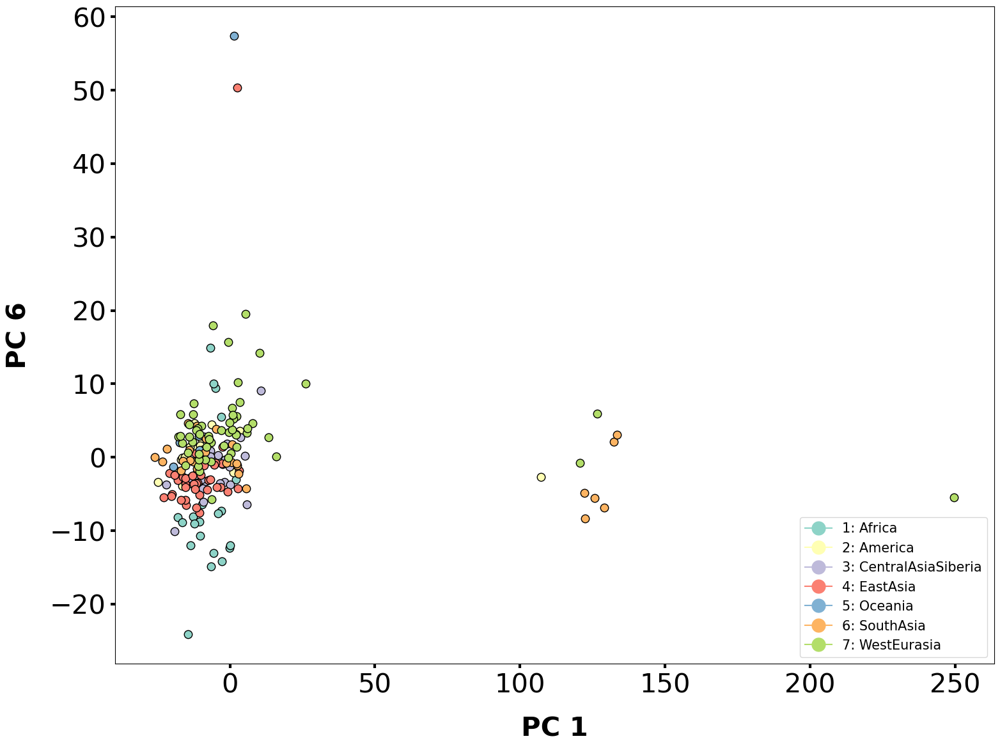

...

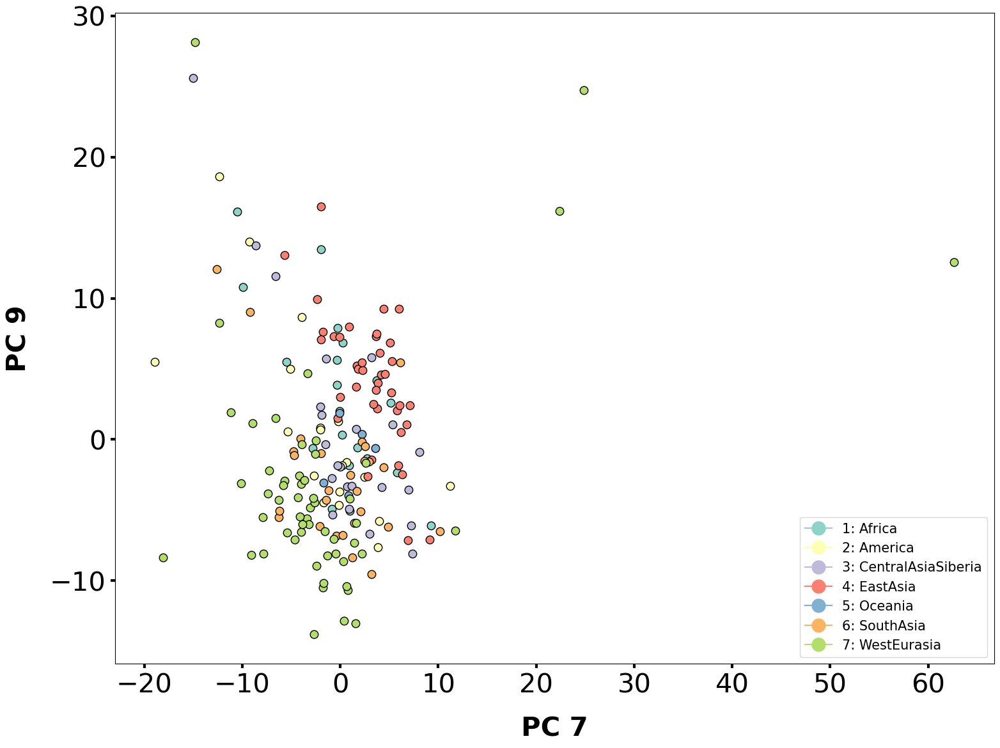

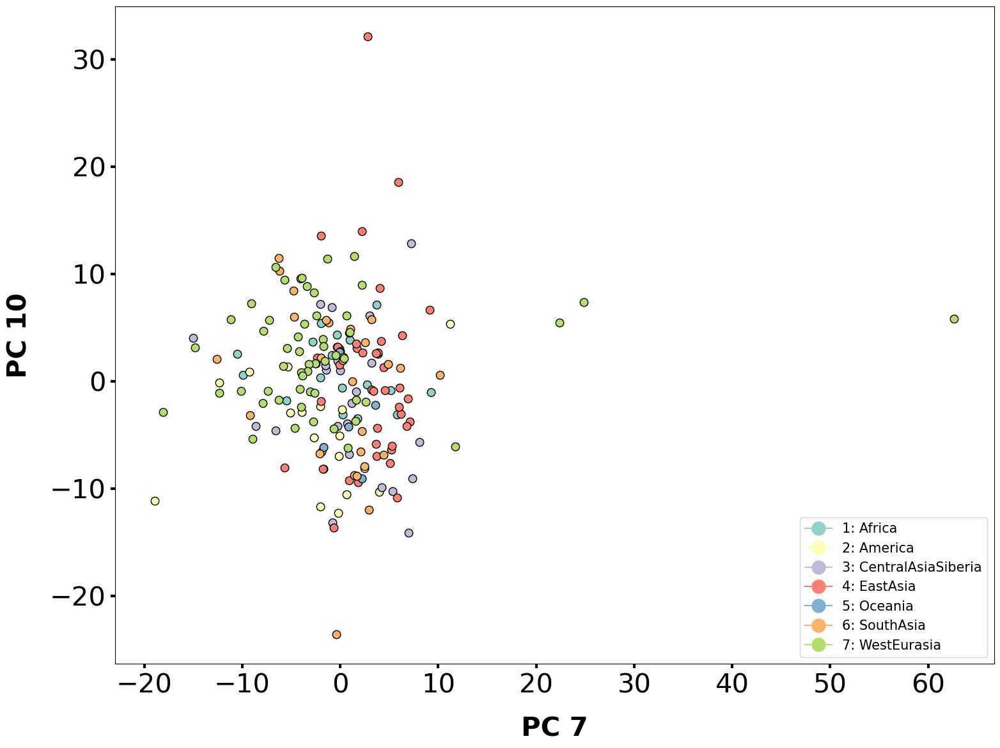

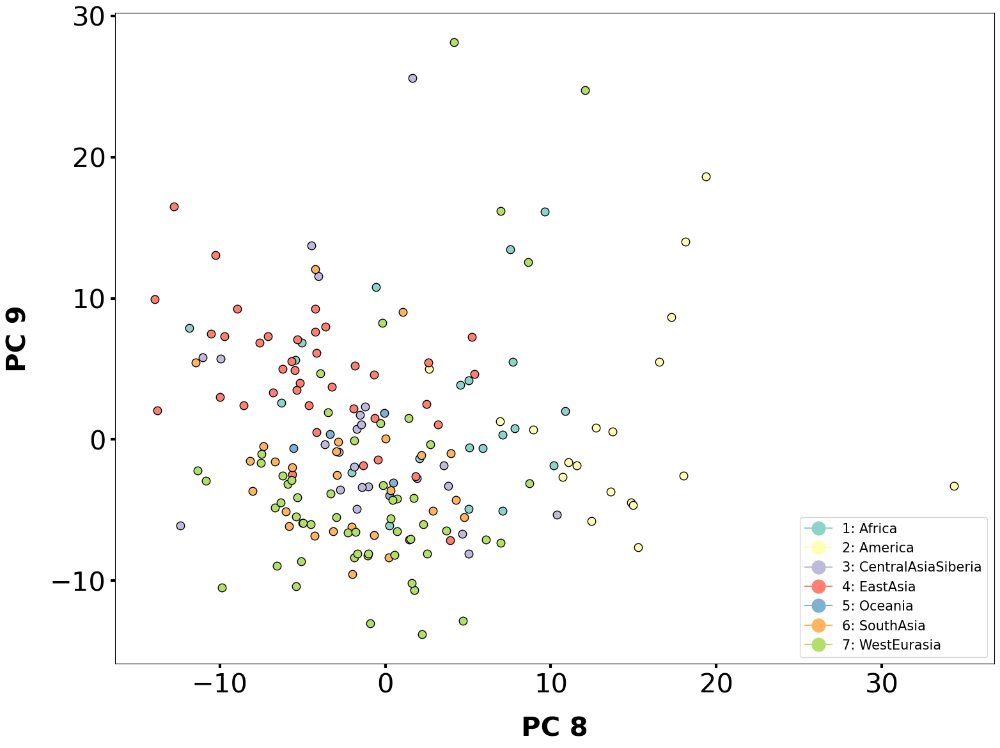

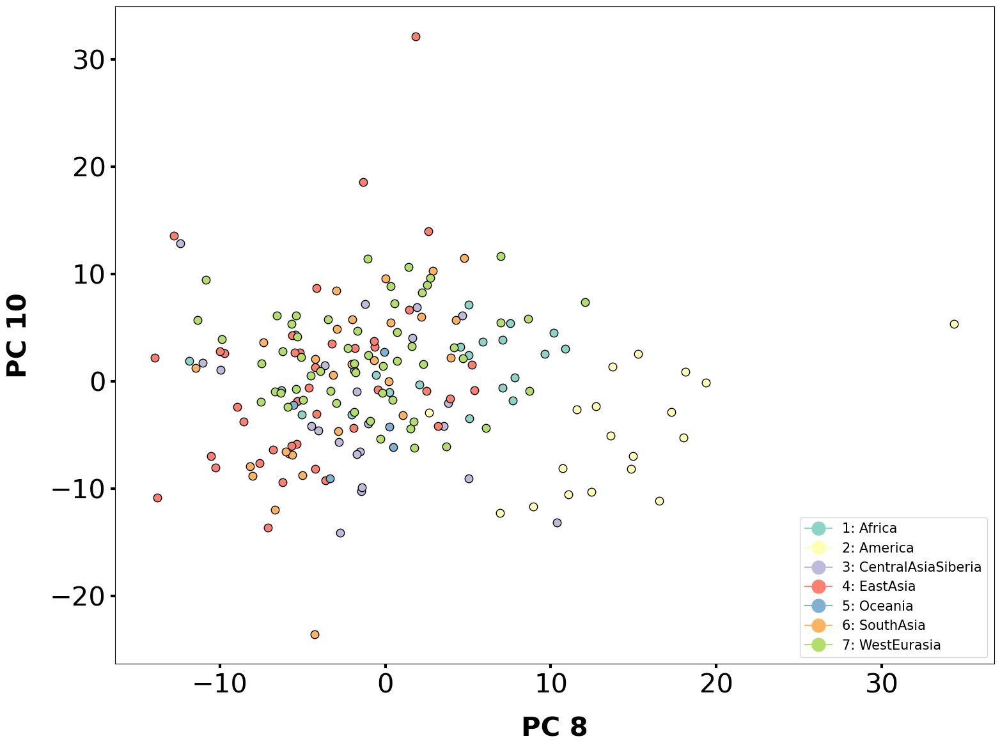

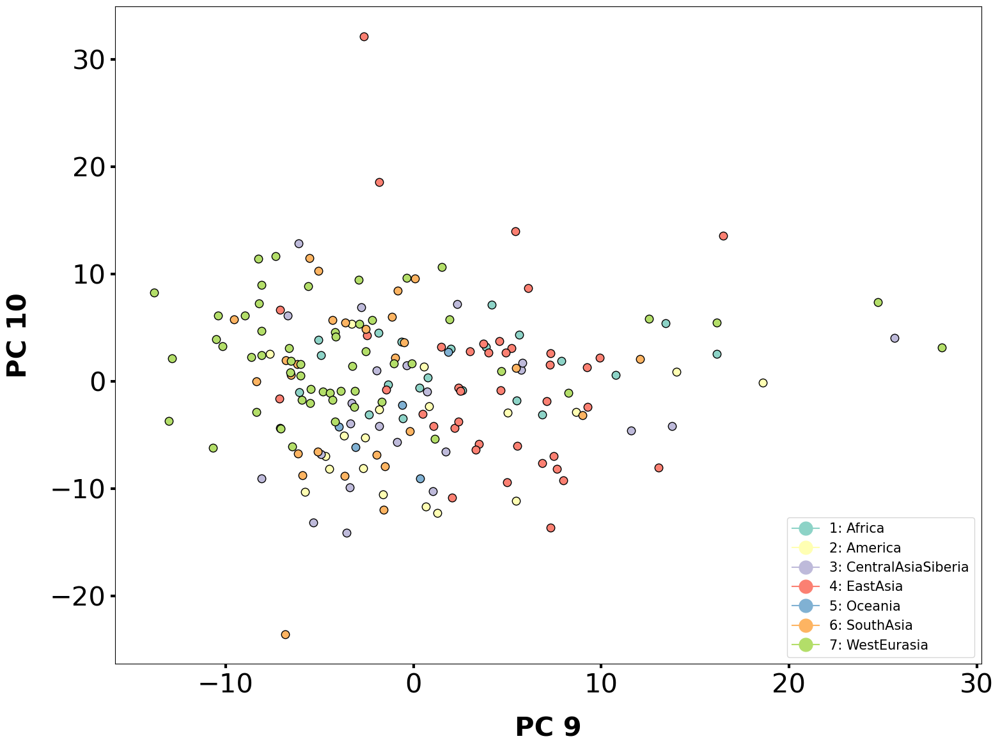

In [19]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)


In [20]:
pca.explained_variance_ratio_

array([0.23088838, 0.07848437, 0.03907977, 0.01819508, 0.01630781,
       0.01227405, 0.01054722, 0.01034488, 0.00985096, 0.00871451])

<h2> Filtering my CNVs only in archaic papers CNVs

In [25]:
archaic_ranges = PyRanges(same_name_archaic)

qdnaseq_df = cnvnator_style_ranges.overlap(archaic_ranges, invert=False)
qdnaseq_df = qdnaseq_df.as_df()

qdnaseq_df = qdnaseq_df.sort_values(by=['Sample_ID','Chromosome', 'Start'])
qdnaseq_df#.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,561401,563700,1.0,deletion,0.515678,2300.0,6.286550e-06,1.378130e-10
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,1642401,1646800,1.0,deletion,0.479367,4400.0,3.622100e-11,3.265140e-04
...,...,...,...,...,...,...,...,...,...,...
169426,SS6004480,9,140195901,140197300,1.0,deletion,0.137698,1400.0,1.095710e-04,3.893360e-11
169427,SS6004480,9,141040501,141042900,1.0,deletion,0.531346,2400.0,1.641130e-03,1.328480e+03
169428,SS6004480,9,141073601,141076000,3.0,duplication,2.142220,2400.0,4.586490e-02,4.818780e-17
169429,SS6004480,9,141081401,141116700,3.0,duplication,1.328760,35300.0,0.000000e+00,2.834580e+09


In [26]:
qdnaseq_df['T-TEST-EVAL'].describe()

count    2.971060e+05
mean     2.507576e-03
std      8.199603e-03
min      0.000000e+00
25%      8.227800e-13
50%      3.187450e-11
75%      6.982225e-06
max      4.999600e-02
Name: T-TEST-EVAL, dtype: float64

In [27]:
#samples = qdnaseq_df.loc[qdnaseq_df['Sample_ID'] == "LP6005442-DNA_B01"]
#samples.loc[samples['Chromosome']== '1']
deletions['End']

1            551200
2            563700
3           1014200
4           1646800
5           4127700
            ...    
169422    136452500
169424    138217600
169425    138480200
169426    140197300
169427    141042900
Name: End, Length: 167090, dtype: int32

In [28]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = qdnaseq_df[qdnaseq_df['Type'] == 'deletion'] 
duplications= qdnaseq_df[qdnaseq_df['Type'] == 'duplication'] 


In [29]:
#deletions = deletions.astype(np.uint8,errors='ignore')
deletions.sort_values(by=['Chromosome', 'Start'])

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
7445,LP6005441-DNA_F04,1,176101,230900,1.0,deletion,0.043879,54800.0,2.908260e-12,1.036720e-05
15981,LP6005442-DNA_F04,1,176201,230100,1.0,deletion,0.041386,53900.0,2.956820e-12,1.901880e-05
1275,LP6005441-DNA_A12,1,176901,230500,1.0,deletion,0.042500,53600.0,2.973370e-12,4.151830e-38
23283,LP6005443-DNA_E01,1,177001,230500,1.0,deletion,0.042935,53500.0,2.978930e-12,1.304890e-05
13785,LP6005442-DNA_C10,1,177101,230500,1.0,deletion,0.039828,53400.0,2.984500e-12,1.870130e+09
...,...,...,...,...,...,...,...,...,...,...
134398,LP6005441-DNA_A01,9,141105701,141107200,1.0,deletion,0.458801,1500.0,4.728550e-02,4.018230e-06
140223,LP6005441-DNA_E08,9,141105701,141107200,1.0,deletion,0.423220,1500.0,3.584170e-02,4.371670e-03
149662,LP6005442-DNA_G07,9,141105701,141107200,1.0,deletion,0.465031,1500.0,4.837620e-02,6.651120e-07
150159,LP6005442-DNA_G12,9,141105701,141107200,1.0,deletion,0.458567,1500.0,3.756150e-02,1.907940e-07


In [30]:
#change to df when using telomeres and centromeres filtration
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv
#Sample_ID	Chr	Start	End	CNV_value	Type	RD	LENGHT	T-TEST-EVAL	GAUSSIAN-EVAL


Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72043,9,141105101,141106700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72044,9,141105101,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72045,9,141105501,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
72046,9,141105701,141107200,0.458801,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [31]:
from scipy import stats
#final_cnv = final_cnv.iloc[new]
final = final_cnv.iloc[:,3:284]
counts = final
counts = counts.fillna(2)

#counts = counts[counts.columns.intersection(counts_a.columns)]

#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])

counts = counts.T
counts = counts.sort_index()
counts

,0,1,2,3,4,5,6,7,8,9,...,72038,72039,72040,72041,72042,72043,72044,72045,72046,72047
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.458801,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
SS6004477,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
SS6004478,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0


In [32]:
#IMPUTATION

features = anotation.merge(counts, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country",]]
features = features.sort_index()
features 


,7-Gender,10-Region,11-Country
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


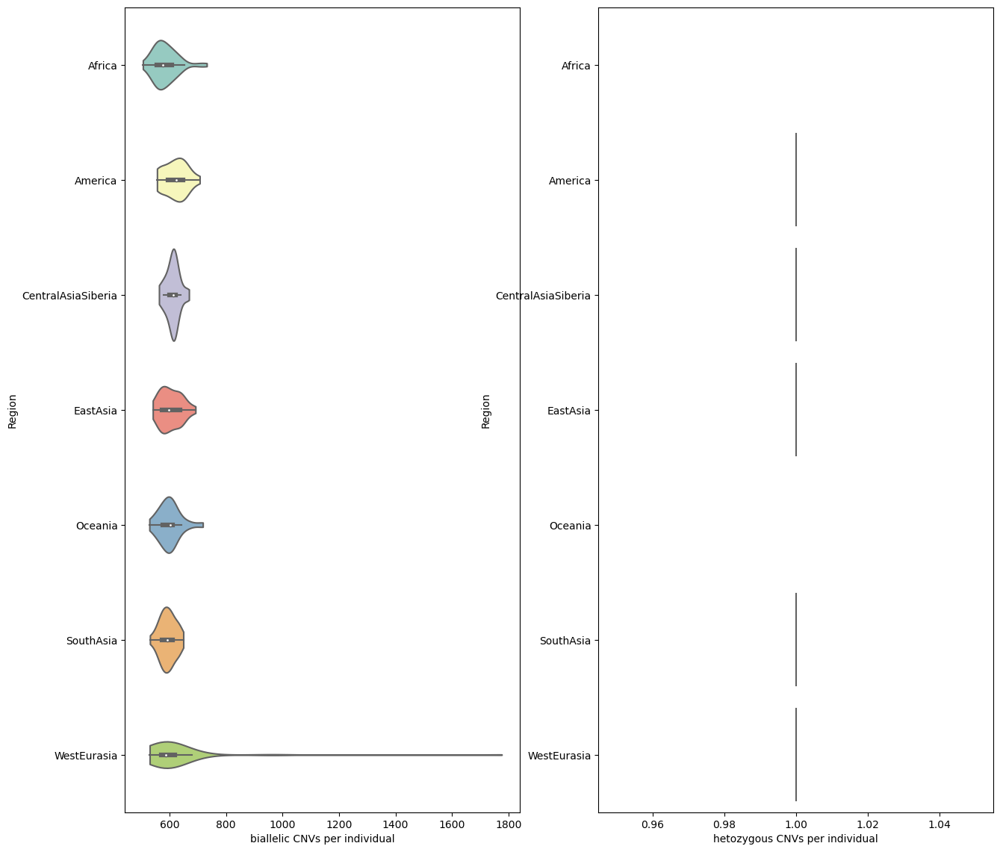

In [33]:
#import seaborn as sns

#pd.set_option("display.max_rows", None, "display.max_columns", None)
biallelic_deletions = deletions[deletions['RD'] < 2 ] 
biallelic_deletions = biallelic_deletions.groupby('Sample_ID').size()

biallelic_deletions = pd.DataFrame(biallelic_deletions)
#biallelic_deletions = biallelic_deletions.set_index('SAMPLE')

biallelic_deletions = features.merge(biallelic_deletions, left_index=True, right_index=True)
#biallelic_deletions = biallelic_deletions.reset_index()

#heterozygous_deletions.value_counts('SAMPLE').sort_index()
biallelic_deletions.columns = ['7-Gender', '10-Region', '11-Country', 'TYPE']
biallelic_deletions


#pd.set_option("display.max_rows", None, "display.max_columns", None)
heterozygous_deletions = deletions[deletions['RD'] > 1] 
heterozygous_deletions = heterozygous_deletions.groupby('Sample_ID').size()
heterozygous_deletions = pd.DataFrame(heterozygous_deletions)
heterozygous_deletions = features.merge(heterozygous_deletions, left_index=True, right_index=True)
heterozygous_deletions.columns = ['7-Gender', '10-Region', '11-Country', 'TYPE']
heterozygous_deletions
heterozygous_deletions


fig, axs = plt.subplots(1, 2, figsize=(15, 14))

ax = seaborn.violinplot(x="TYPE", y="10-Region", data=biallelic_deletions, palette='Set3', order=[ "Africa","America", "CentralAsiaSiberia","EastAsia", "Oceania", "SouthAsia", "WestEurasia"], ax=axs[0], cut=0)

ax.set_xlabel("biallelic CNVs per individual")
ax.set_ylabel("Region")

ax = seaborn.violinplot(x="TYPE", y="10-Region", data=heterozygous_deletions, palette='Set3', order=[ "Africa","America", "CentralAsiaSiberia","EastAsia", "Oceania", "SouthAsia", "WestEurasia"], ax=axs[1], cut=0)

ax.set_xlabel("hetozygous CNVs per individual")
ax.set_ylabel("Region")
plt.show()

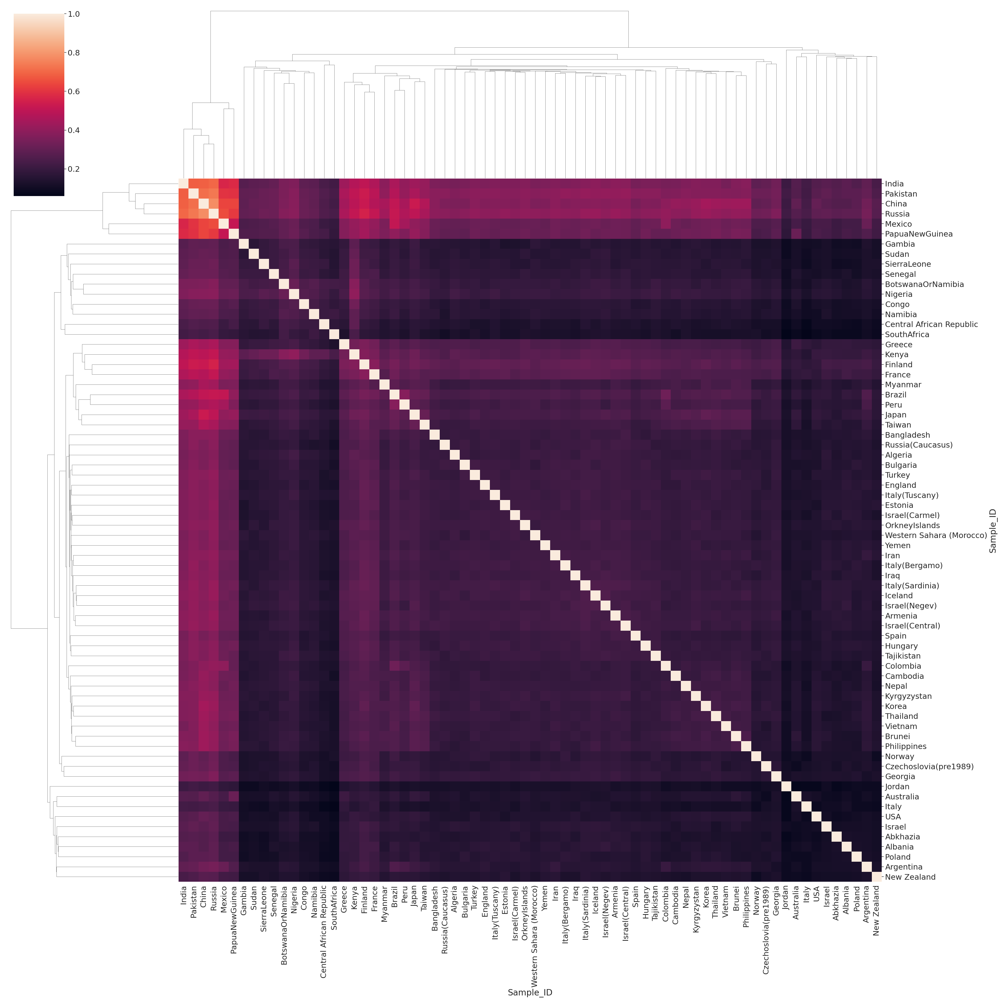

In [34]:
freq = final_cnv.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['11-Country'])
df = freq_input.T

df = df.notnull().groupby(level=0).mean()

seaborn.set(font_scale=2)
corrmatrix = df.T.corr(method='pearson')
seaborn.clustermap(corrmatrix, figsize=(40,40))#, row_colors=row_colors, row_cluster=True, figsize=(40,40))

#plt.savefig('clustermap_countries.pdf')


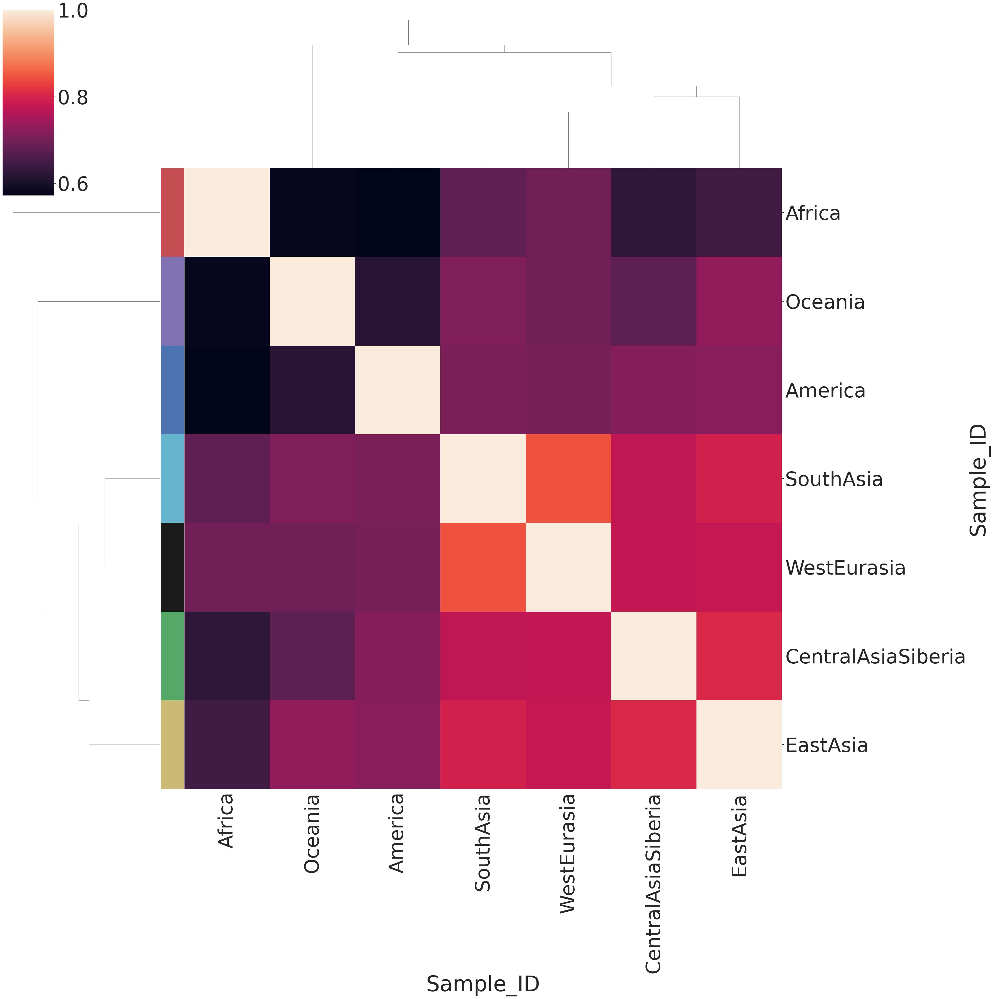

In [35]:
freq = final_cnv.iloc[:,3:283]
freq_input = freq.rename(columns=anotation['10-Region'])
df = freq_input.T
#df = df.reset_index()

#df.groupby('SAMPLE').count().div(df.groupby('SAMPLE').size(),0)


df = df.notnull().groupby(level=0).mean()

df = df.T

lut = dict(zip(df.columns.unique(), "rbgymck"))
lut

seaborn.set(font_scale=5)
corrmatrix = df.corr(method='pearson')
row_colors = df.columns.map(lut)
seaborn.clustermap(corrmatrix, row_colors=row_colors, row_cluster=True, figsize=(40,40))
#plt.savefig('clustermap_regions.pdf')


In [36]:
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#x = imp.fit_transform(counts.T)

#track features for pca & tsne
#X = StandardScaler().fit_transform(x)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus),-0.387139,0.405845,4.532788,-0.204277,0.136212,-1.727174,-0.900238,-0.395404,-0.954573,-1.066676
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea,-1.985211,1.110421,-3.523394,4.302456,-2.948464,0.651815,2.020822,-0.068297,-0.752518,-0.927018
LP6005441-DNA_A04,F,America,Colombia,-4.477597,1.779291,-3.501772,-7.809662,6.193367,-2.774142,2.199385,-1.595105,0.237694,2.399571
LP6005441-DNA_A05,M,WestEurasia,France,1.034224,-0.530874,6.239523,0.179028,-0.997643,-0.073950,1.057612,0.993242,-0.577717,3.869191
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo),0.266868,-0.263261,7.989151,1.210897,0.661742,-1.754949,0.726727,1.841501,-1.585961,-2.350277
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,M,America,Brazil,-0.674959,0.857853,-2.310345,-4.345385,12.128260,4.425667,-3.497764,-0.665835,6.223182,0.500473
SS6004477,M,Oceania,Australia,0.712296,0.004640,-5.507488,9.533556,6.934664,3.911815,-4.598522,-1.974251,3.471134,-5.027272
SS6004478,U,Oceania,Australia,0.709926,-1.157171,-4.652212,10.382204,6.195071,6.078694,-8.572546,-0.998931,-2.335404,-1.755939
SS6004479,F,America,Mexico,-2.049419,1.347675,-4.056601,-3.976214,10.959429,6.881506,-7.355838,-6.688544,-3.038902,2.735868


In [37]:
pca.explained_variance_ratio_

array([0.01247697, 0.01067045, 0.00906184, 0.00764537, 0.00670958,
       0.00609782, 0.00590648, 0.00545757, 0.00513539, 0.00499638])

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

Text(0.5, 1.0, 'PCA deletions (archaic genes)')

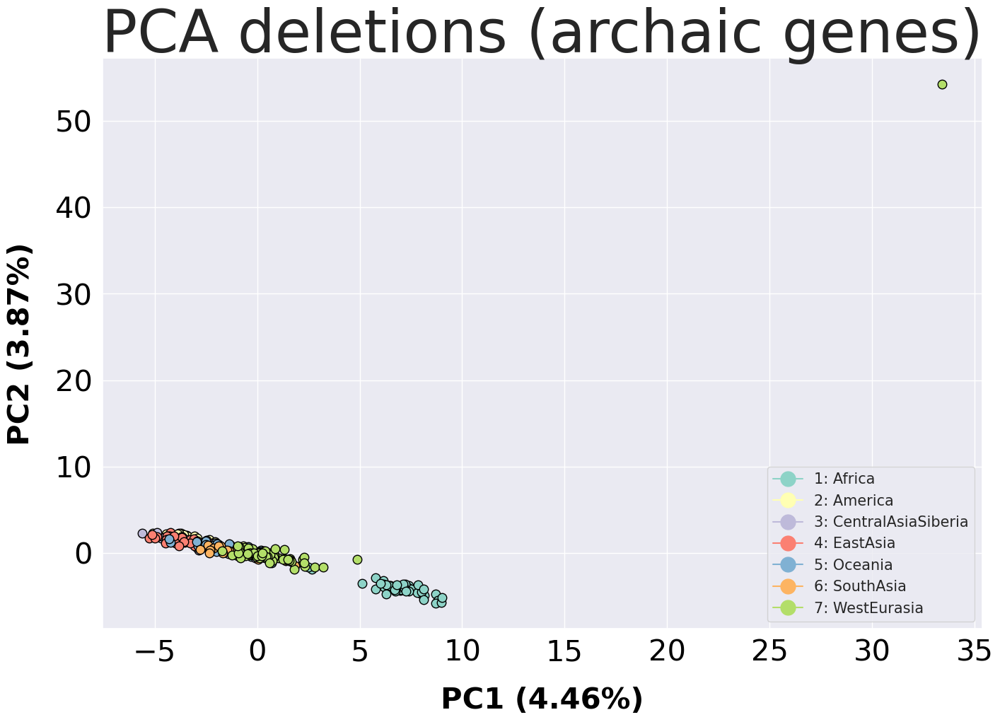

In [38]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (4.46%)', label_vertical='PC2 (3.87%)', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA deletions (archaic genes)")
#plt.savefig('pca_deletions.pdf')

                 7-Gender    10-Region  component_1  component_2  component_3  \
11-Country                                                                      
Russia(Caucasus)        M  WestEurasia    -0.387139     0.405845     4.532788   
PapuaNewGuinea          F      Oceania    -1.985211     1.110421    -3.523394   
Colombia                F      America    -4.477597     1.779291    -3.501772   
France                  M  WestEurasia     1.034224    -0.530874     6.239523   
Italy(Bergamo)          M  WestEurasia     0.266868    -0.263261     7.989151   
...                   ...          ...          ...          ...          ...   
Brazil                  M      America    -0.674959     0.857853    -2.310345   
Australia               M      Oceania     0.712296     0.004640    -5.507488   
Australia               U      Oceania     0.709926    -1.157171    -4.652212   
Mexico                  F      America    -2.049419     1.347675    -4.056601   
Sudan                   M   

Text(0.5, 1.0, 'PCA deletions (archaic genes)')

/opt/spack/opt/spack/linux-rhel8-icelake/gcc-8.4.1/anaconda3-2021.05-fmo625scqdt32etnaksoexe3rd6sea7j/lib/python3.8/site-packages/IPython/core/pylabtools.py:152: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations.
  fig.canvas.print_figure(bytes_io, **kw)


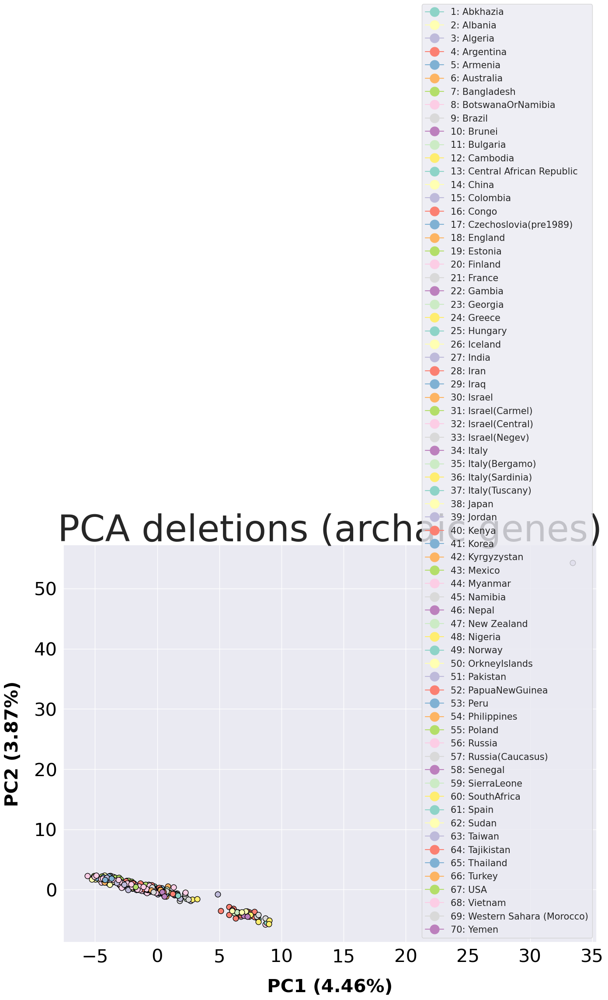

In [39]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (4.46%)', label_vertical='PC2 (3.87%)', factor='11-Country', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA deletions (archaic genes)")
#plt.savefig('pca_deletions_countries.pdf')

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.387139     0.405845     4.532788   
Oceania            F    PapuaNewGuinea    -1.985211     1.110421    -3.523394   
America            F          Colombia    -4.477597     1.779291    -3.501772   
WestEurasia        M            France     1.034224    -0.530874     6.239523   
WestEurasia        M    Italy(Bergamo)     0.266868    -0.263261     7.989151   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.674959     0.857853    -2.310345   
Oceania            M         Australia     0.712296     0.004640    -5.507488   
Oceania            U         Australia     0.709926    -1.157171    -4.652212   
America            F            Mexico    -2.049419     1.347675    -4.056601   
Africa             M        

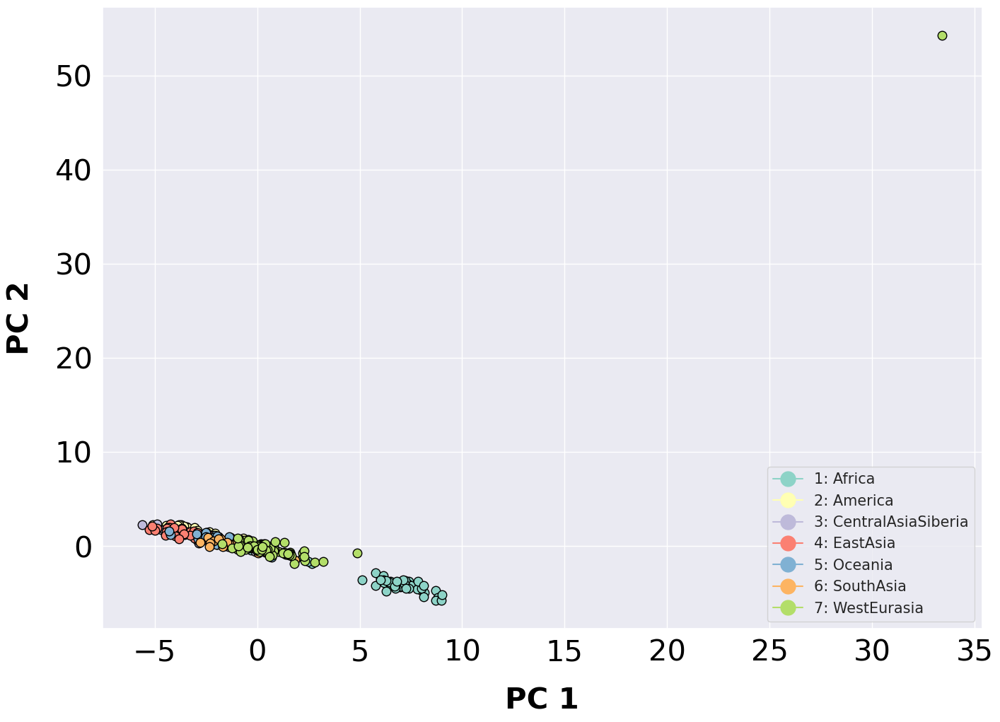

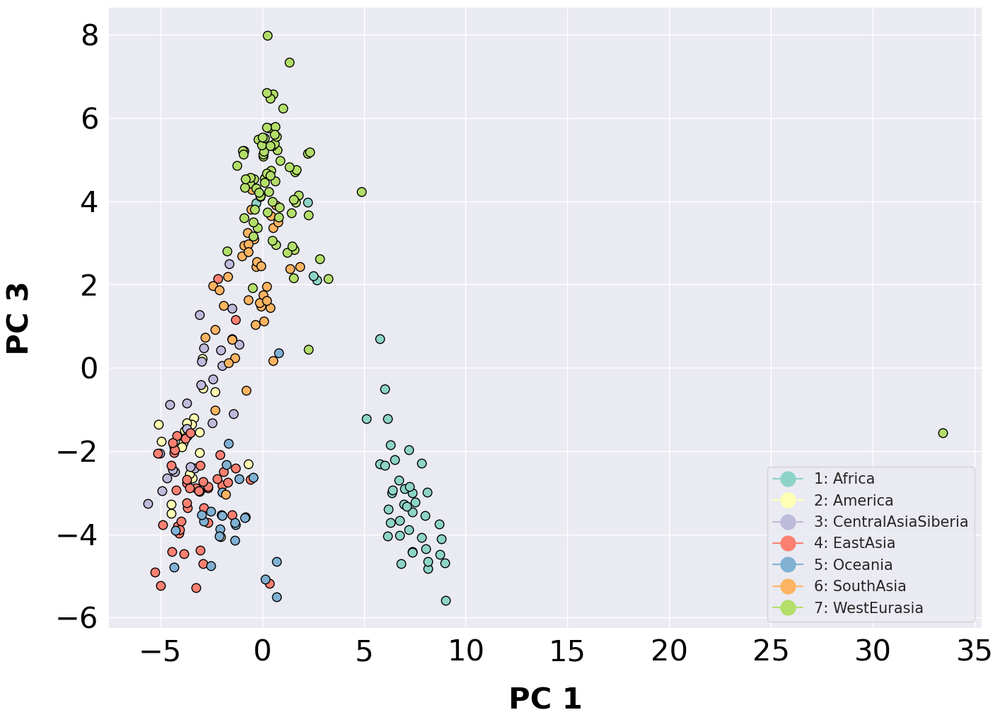

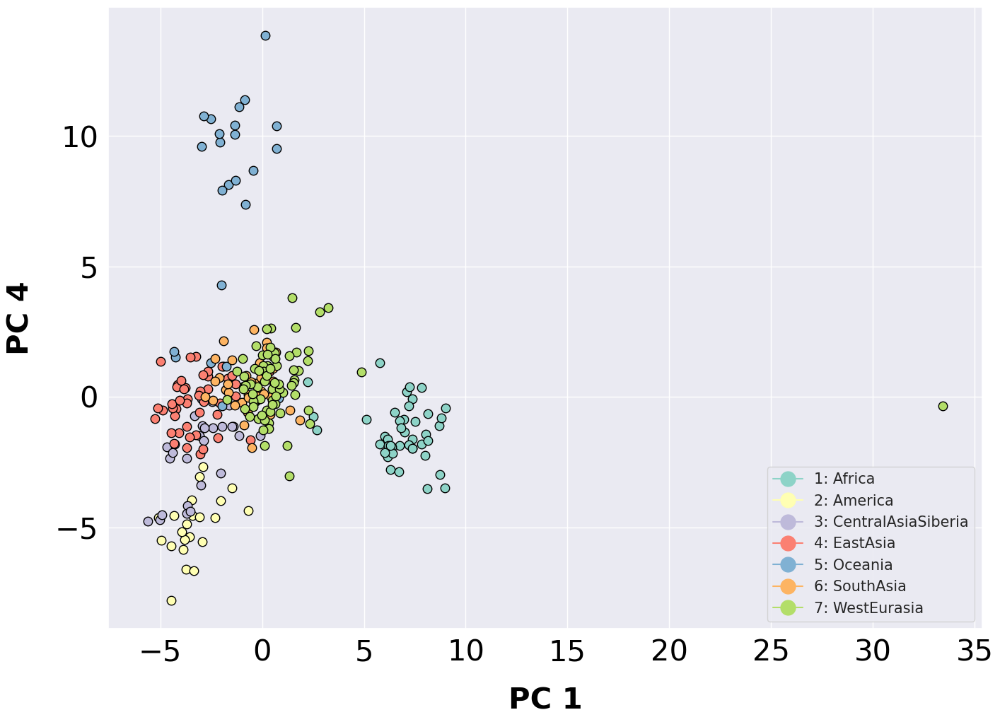

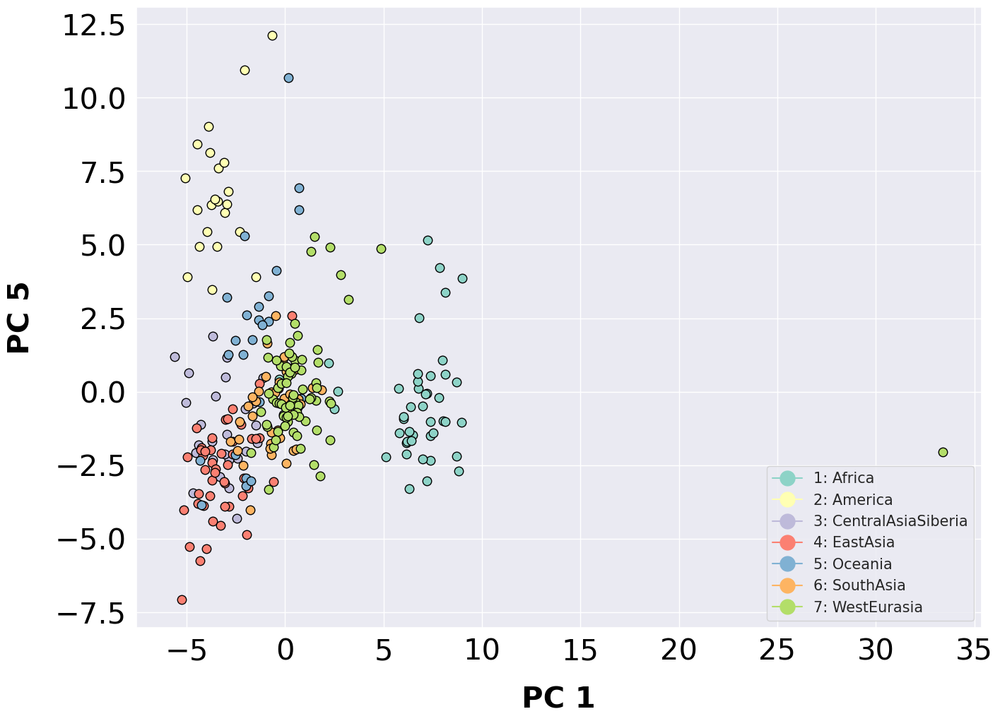

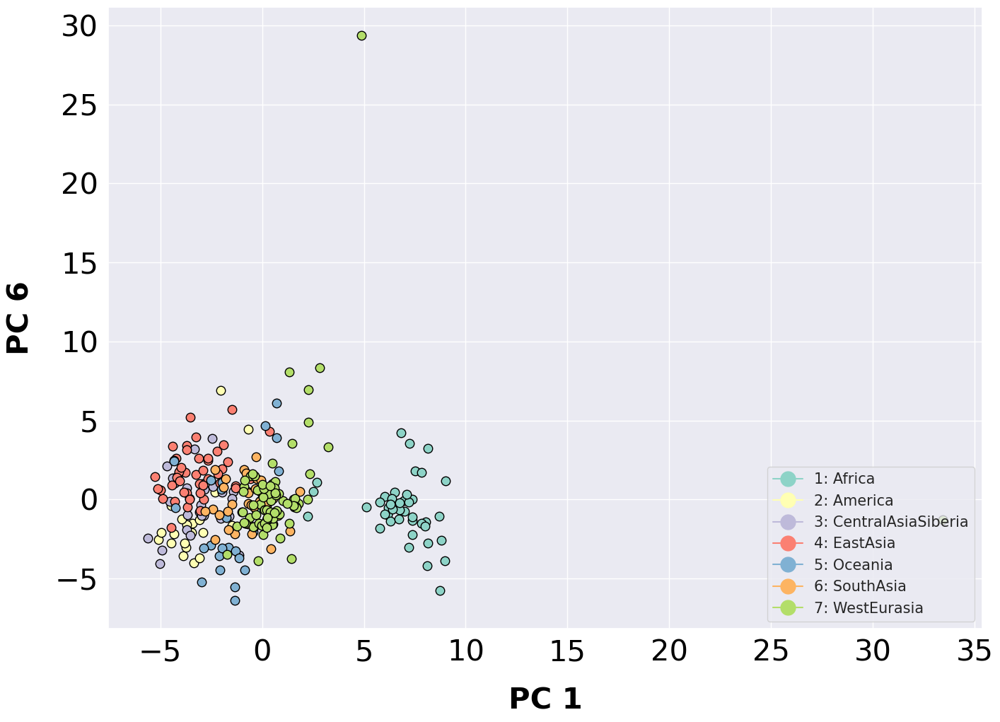

...

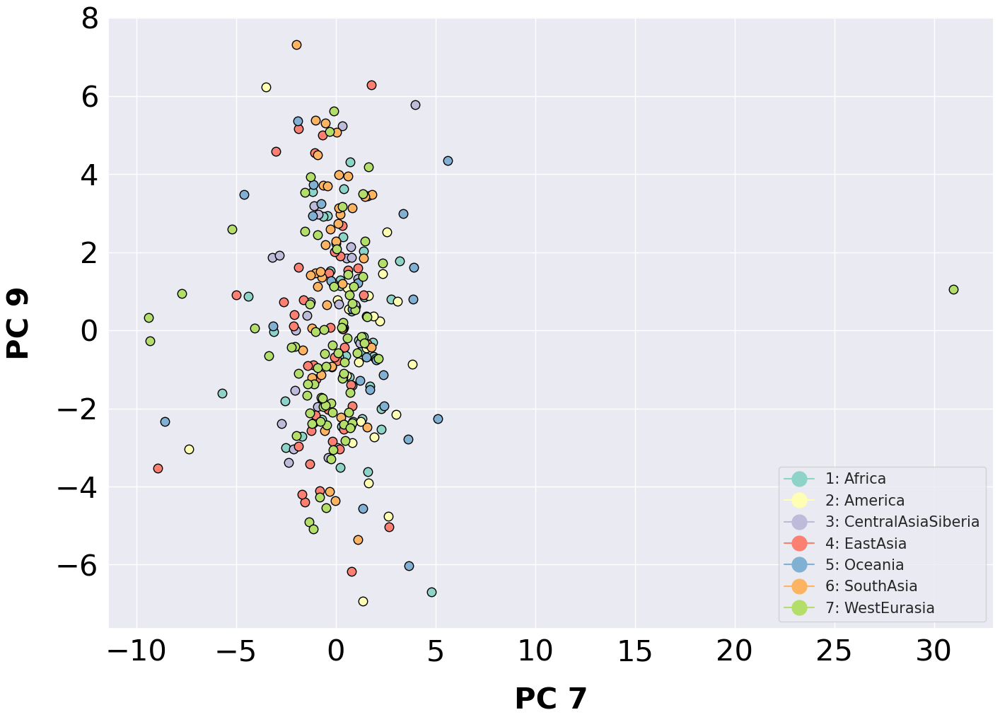

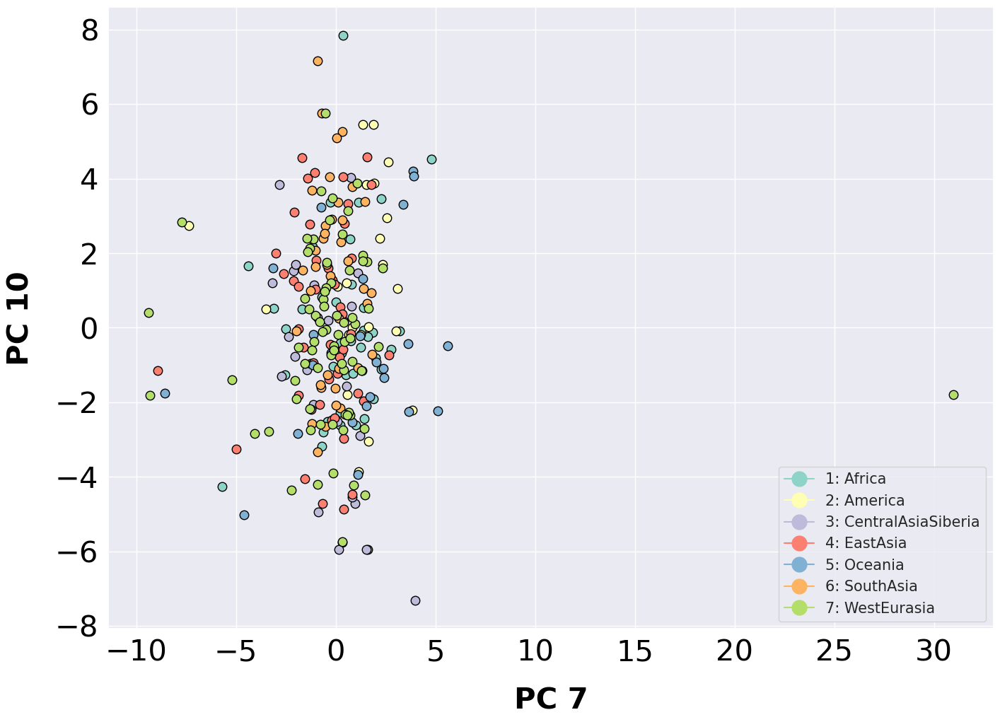

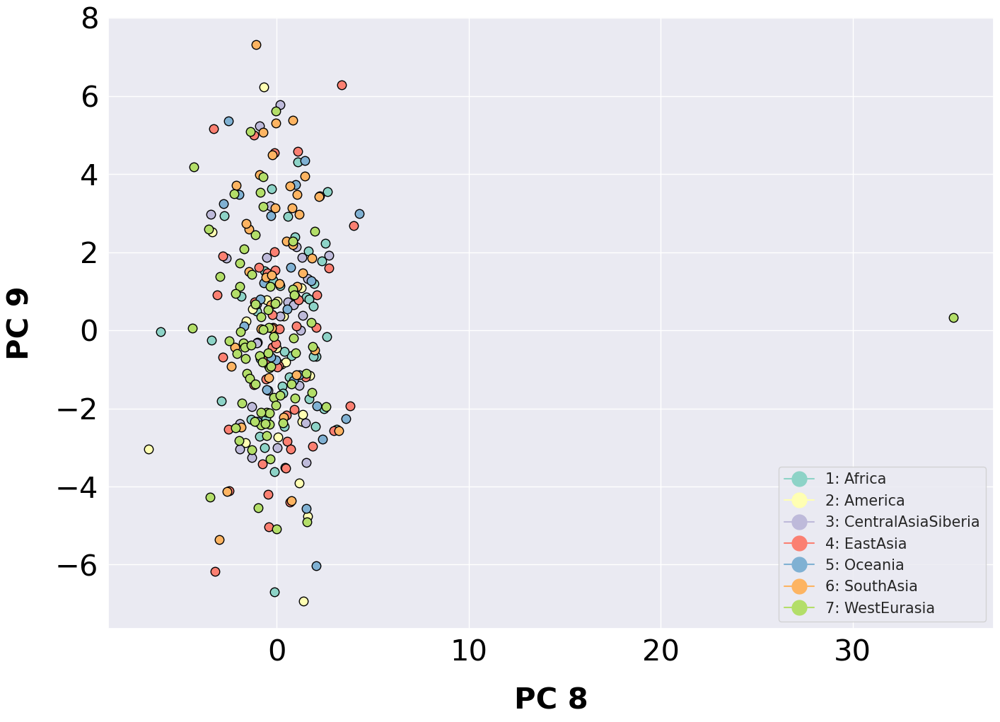

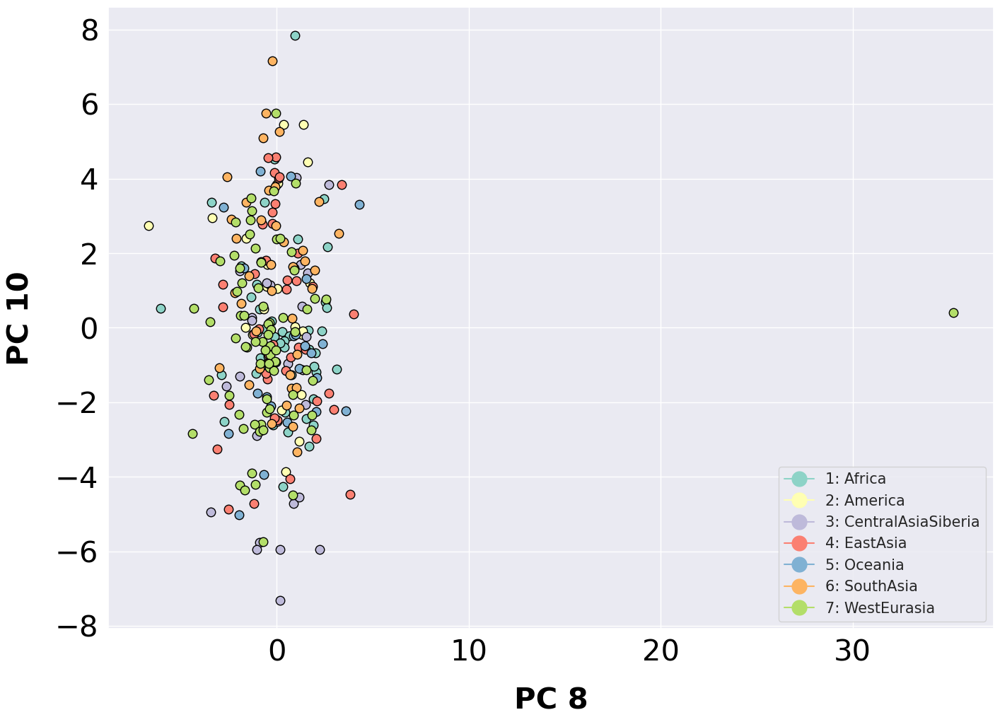

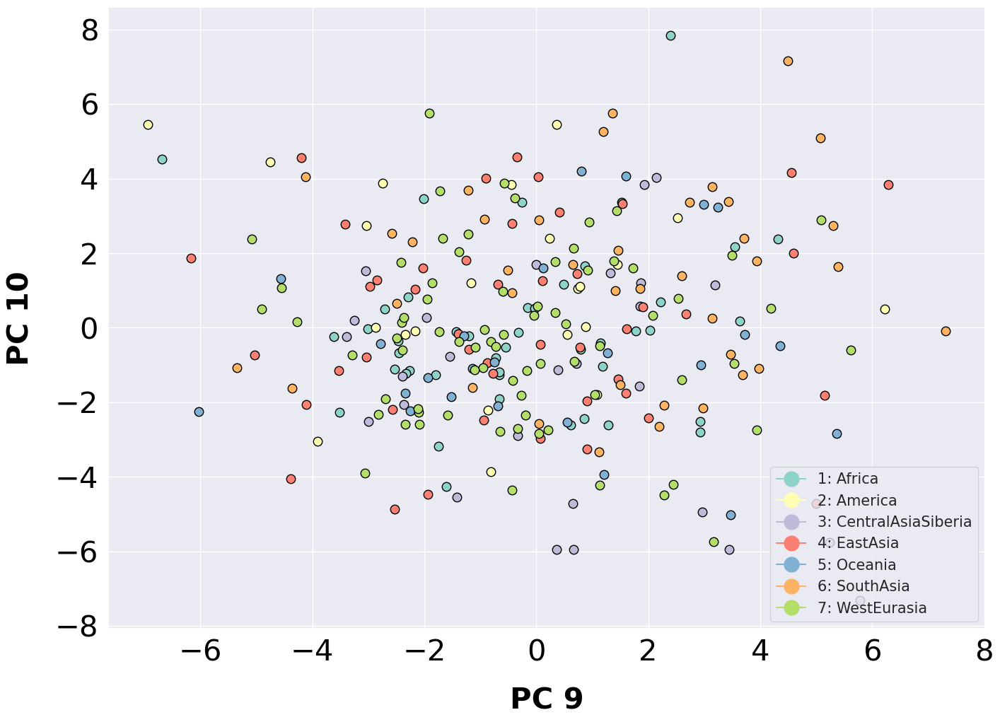

In [40]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [41]:
## DUPLICATIONS

In [42]:
final_cnv = duplications.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_duplications = final_cnv.iloc[:,4:284]
counts_duplications = final_duplications
counts_duplications = counts_duplications.fillna(2)


#counts = counts[counts.columns.intersection(counts_a.columns)]
#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])


counts_duplications = counts_duplications.T
counts_duplications = counts_duplications.sort_index()


features_duplications = anotation.merge(counts_duplications, left_index=True, right_index=True)
features_duplications = features_duplications.loc[:,["7-Gender","10-Region", "11-Country",]]
features_duplications = features_duplications.sort_index()
features_duplications


,7-Gender,10-Region,11-Country
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
LP6005441-DNA_A08,M,Africa,Congo
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


In [43]:
#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts_duplications)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features_duplications.index)




df_pca = features_duplications.merge(df_pca, left_index=True, right_index=True)
pca.explained_variance_ratio_

array([0.08596231, 0.05382916, 0.03718016, 0.02752539, 0.02203545,
       0.0200665 , 0.01883745, 0.01631038, 0.01554576, 0.01463599])

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

Text(0.5, 1.0, 'PCA duplications (archaic genes)')

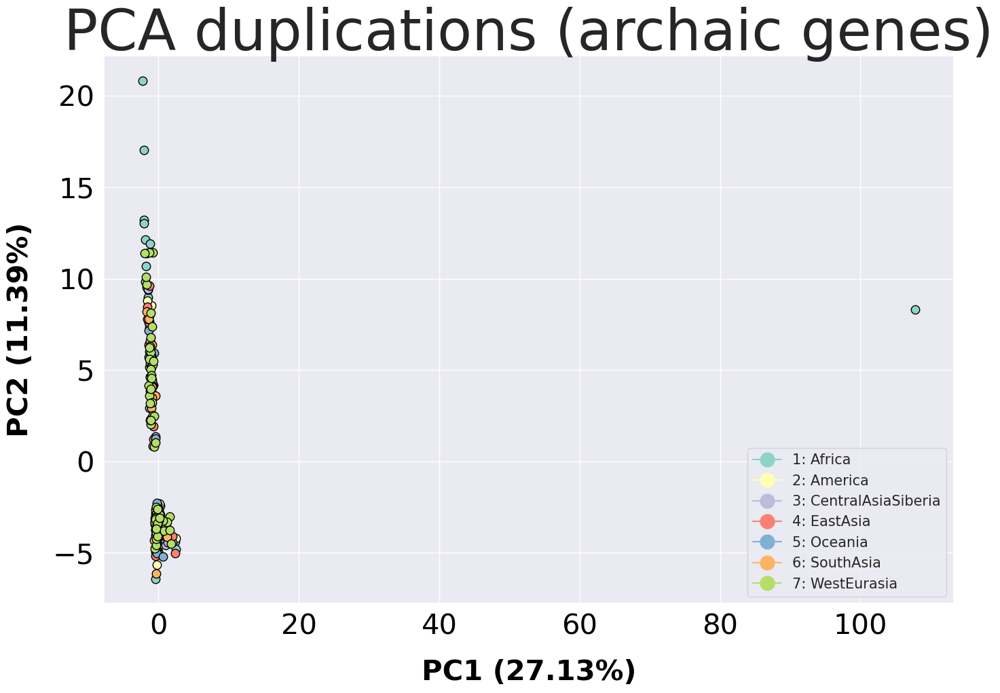

In [44]:
d = plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC1 (27.13%)', label_vertical='PC2 (11.39%)', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
plt.title("PCA duplications (archaic genes)")
#plt.savefig('pca_duplications.pdf')

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

            7-Gender      11-Country  component_1  component_2  component_3  \
10-Region                                                                     
Oceania            F  PapuaNewGuinea    -0.289469    -4.340453    -0.834200   
America            F        Colombia    -0.393125    -4.738391    -0.449198   
WestEurasia        M          France    -1.252207     5.991519    -0.055192   
WestEurasia        M  Italy(Bergamo)    -0.448747    -2.984453     0.679675   
Africa             M           Congo    -2.094010    17.023109    -1.517019   
...              ...             ...          ...          ...          ...   
America            M          Brazil    -0.271616    -3.486310    -0.702082   
Oceania            M       Australia    -0.094900    -3.406950     0.573508   
Oceania            U       Australia    -0.086403    -4.128627     0.494601   
America            F          Mexico    -0.059402    -2.805856     1.252532   
Africa             M           Sudan    -2.035247   

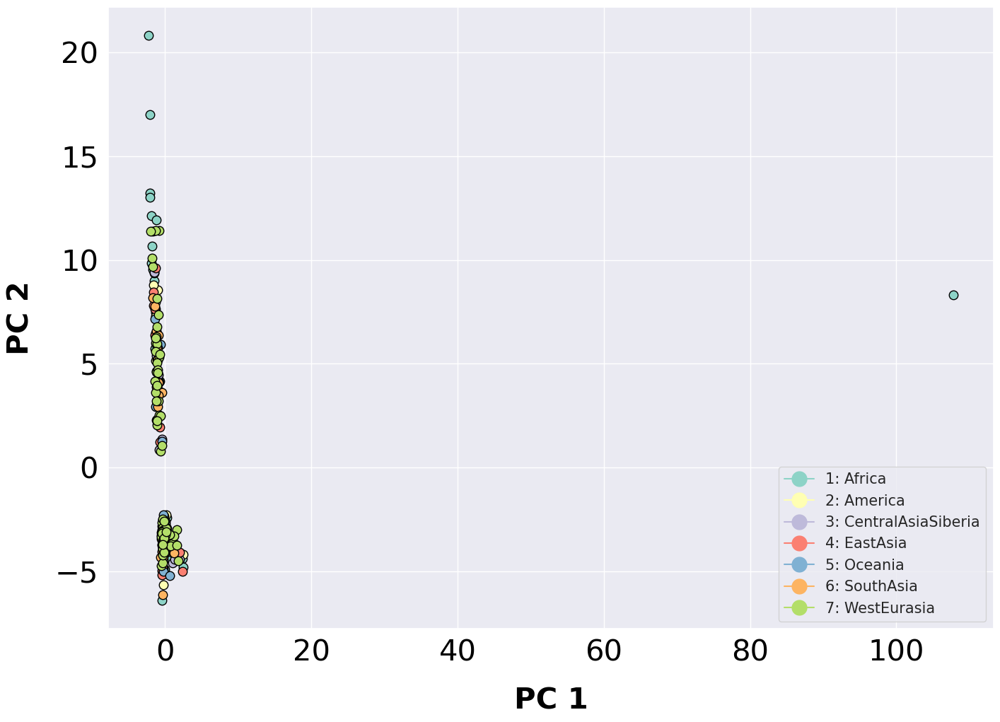

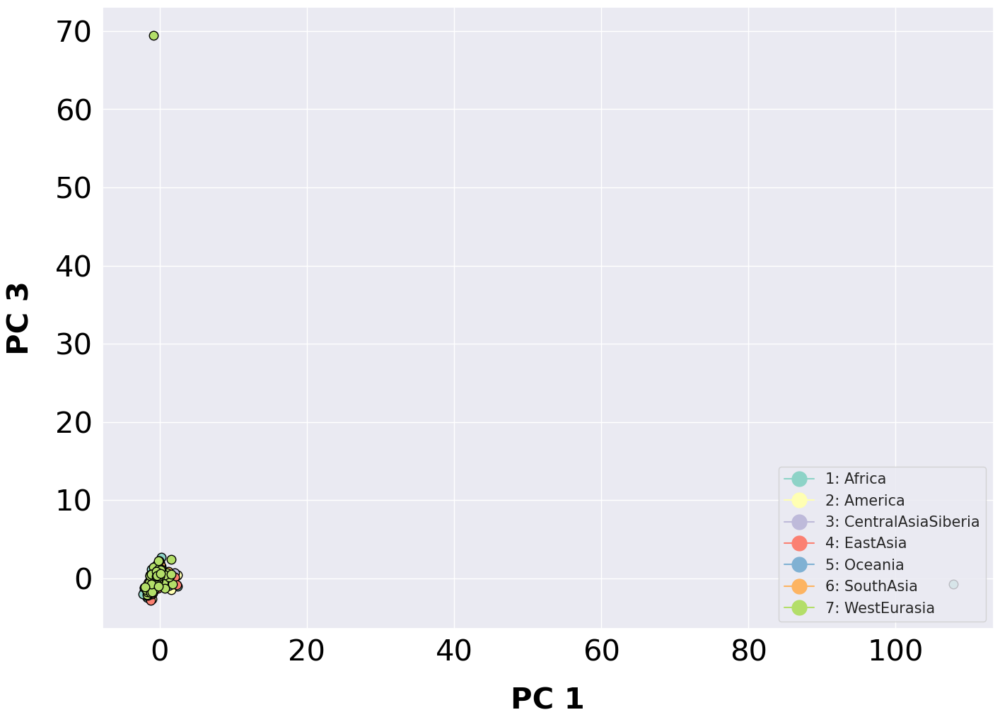

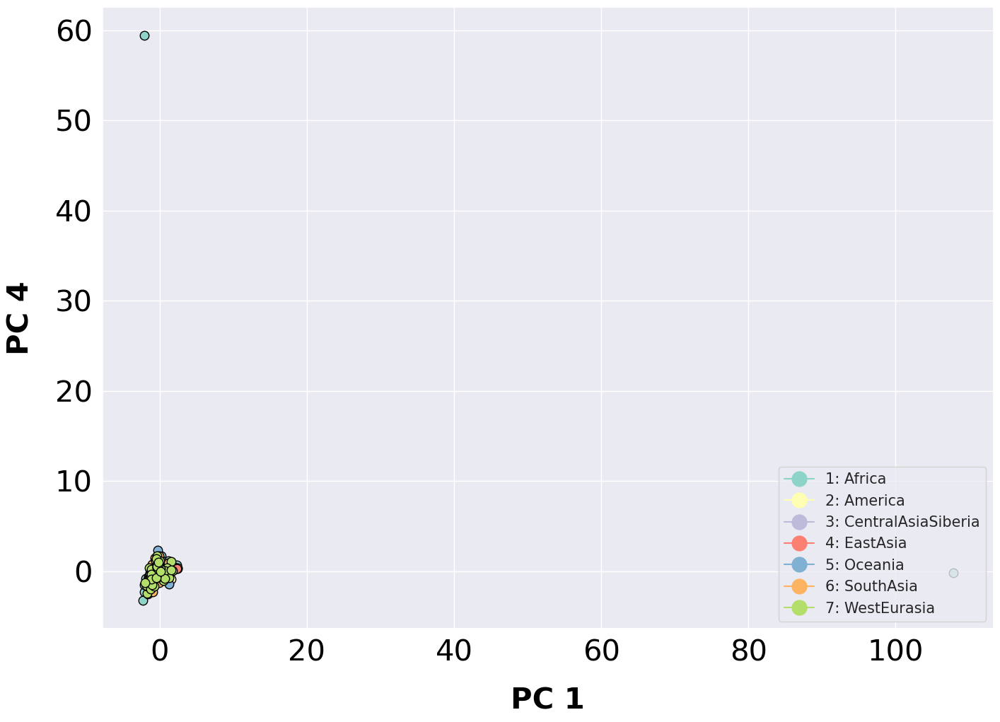

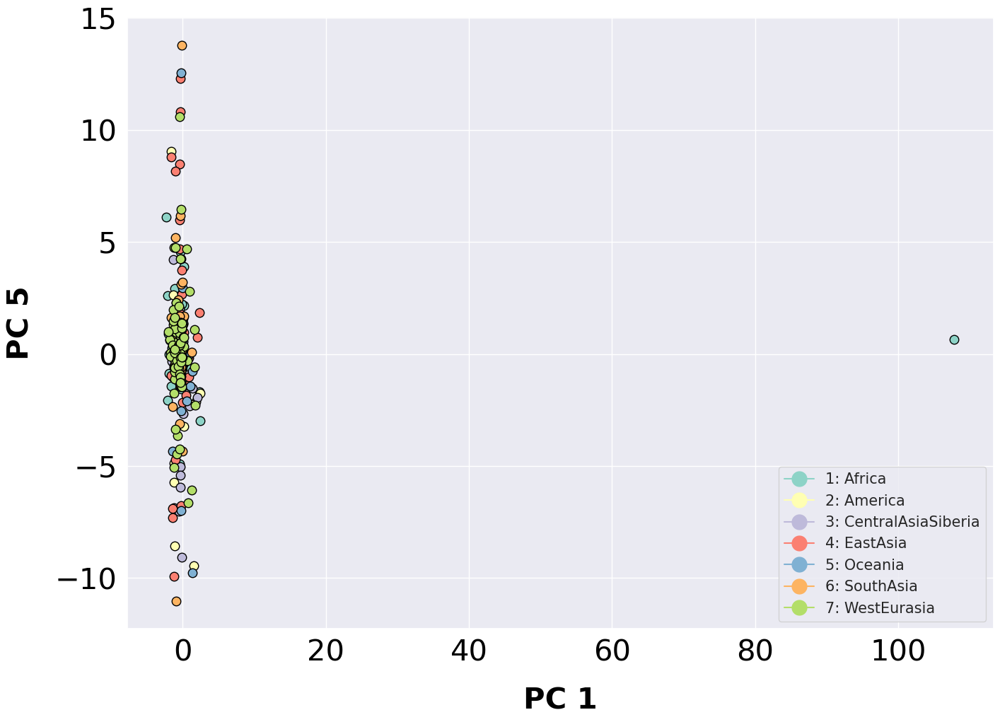

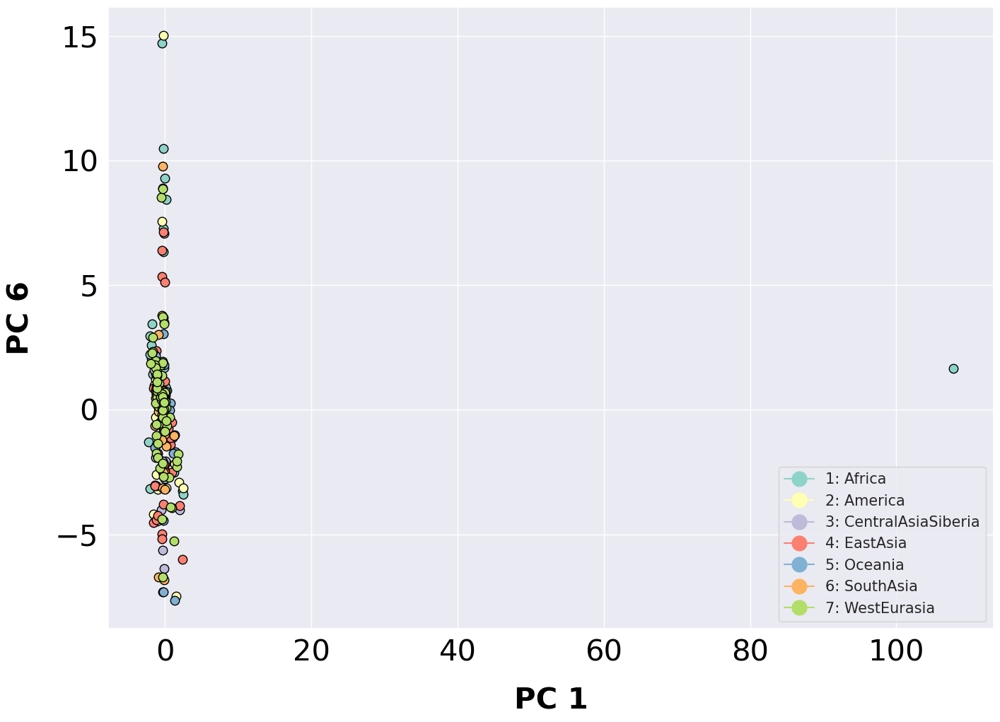

...

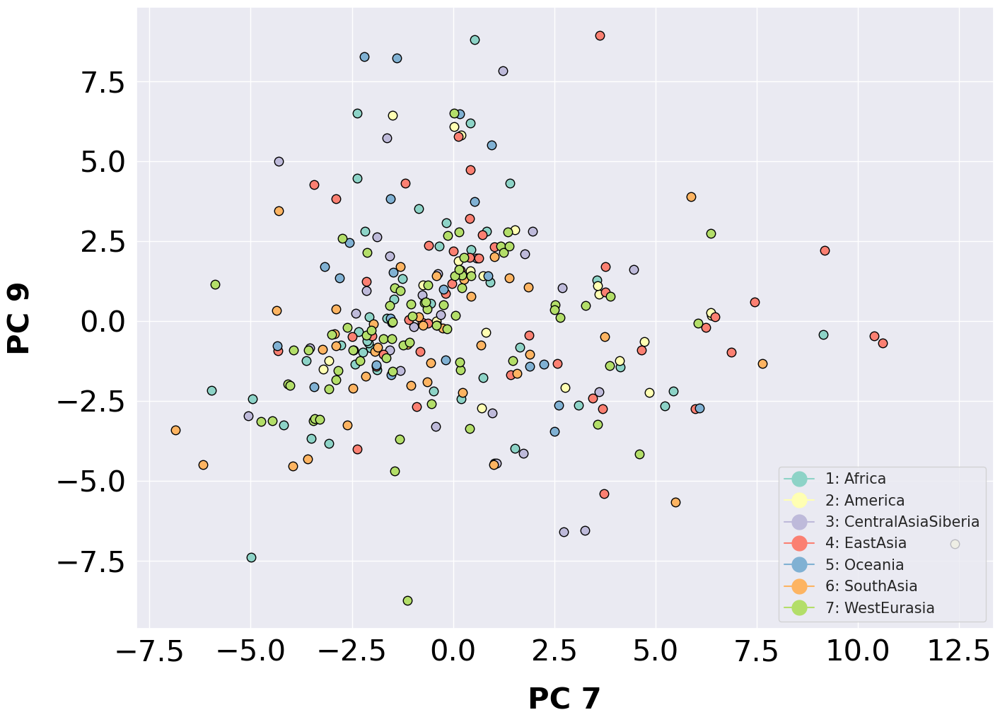

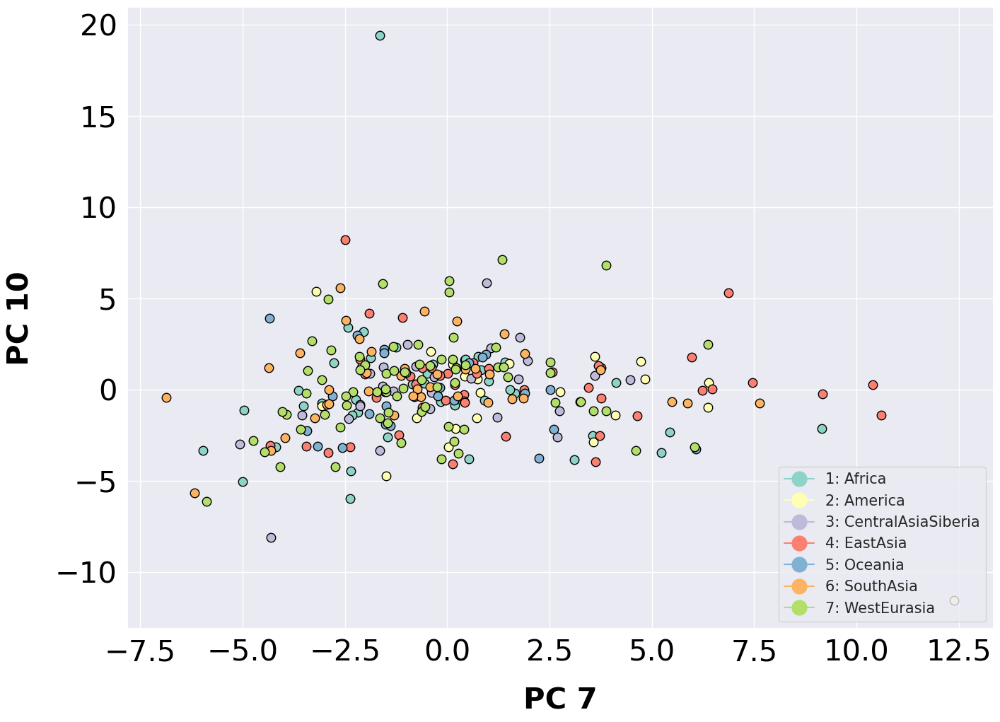

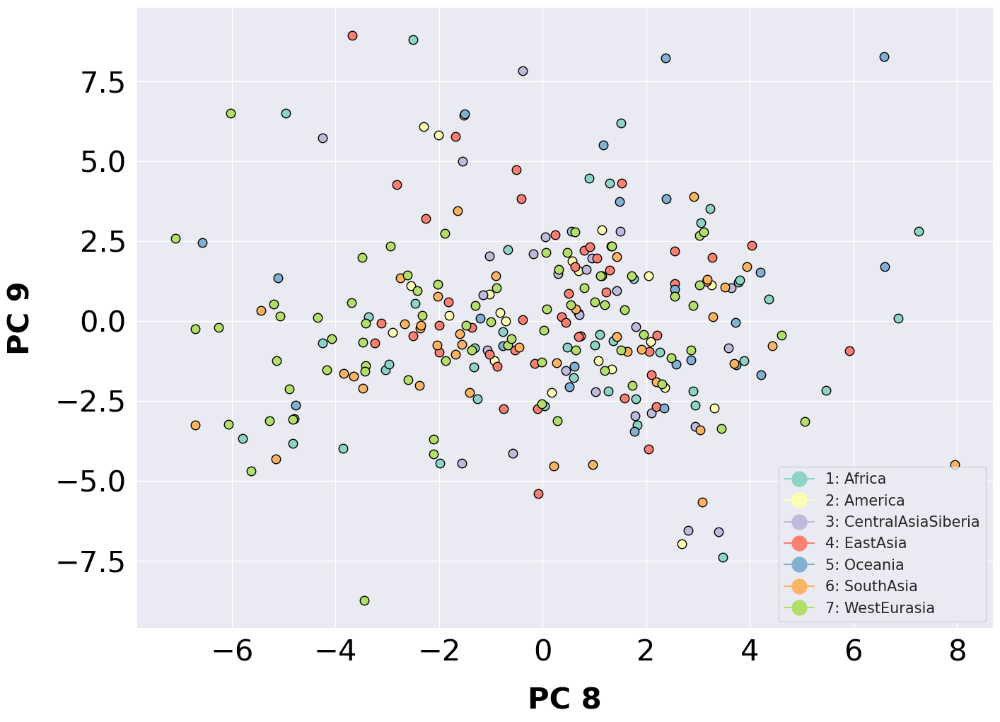

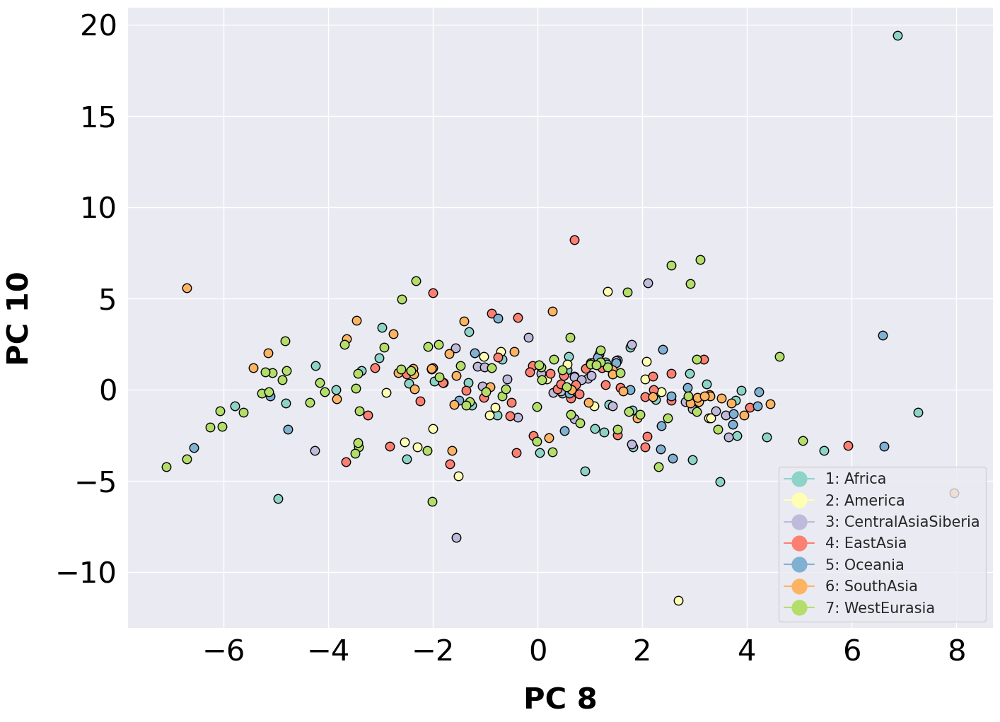

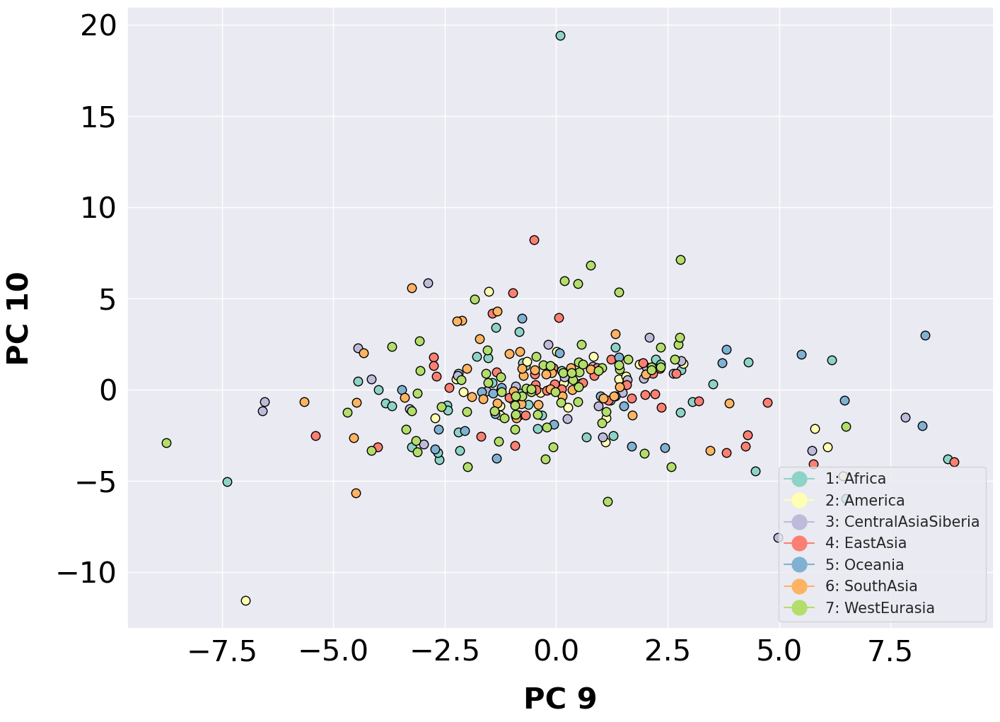

In [45]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> Studmant Data

In [46]:
header= ['Sample', 'Region', 'Country', 'Sample_ID', 'Sex']
studmant_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore//branchinecta/jbazanwilliamson/Studmant_anotation.csv', names=header, index_col=0)#Studmant data

studmant_data = pd.read_csv('/home/jbazanwilliamson/borgstore//branchinecta/jbazanwilliamson/Studmant_cnvs.csv')
studmant_data['contig'] = studmant_data['contig'].str.replace('chr', '')
studmant_data

n_uncalled = np.sum(studmant_data==-1,1)
studmant_data = studmant_data[n_uncalled==0]
studmant_data

studmant_anotation

,Region,Country,Sample_ID,Sex
Sample,,,,
AFR_BantuKenya_HGDP01414_F,AFR,BantuKenya,HGDP01414,F
AFR_BantuKenya_HGDP01417_M,AFR,BantuKenya,HGDP01417,M
AFR_BantuSEHerero_HGDP01028_M,AFR,BantuSEHerero,HGDP01028,M
AFR_BantuSEHerero_HGDP01035_M,AFR,BantuSEHerero,HGDP01035,M
AFR_BantuSETswana_HGDP01030_M,AFR,BantuSETswana,HGDP01030,M
...,...,...,...,...
WEA_SpainIBS_HG01504_F,WEA,SpainIBS,HG01504,F
WEA_Tuscan_HGDP01163_M,WEA,Tuscan,HGDP01163,M
WEA_Tuscan_HGDP01168_F,WEA,Tuscan,HGDP01168,F


In [47]:
#Subsetting deletions 
#studmant_data = studmant_data[studmant_data['bi-allelic'] == True] 
deletions = studmant_data[studmant_data['type'] == "DEL"] 
counts = deletions.iloc[:,6:283]
X = counts.T
X = X.sort_index()
X

,2,3,6,7,13,47,48,49,50,51,...,14998,14999,15001,15002,15005,15006,15007,15008,15010,15011
AFR_BantuKenya_HGDP01414_F,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2
AFR_BantuKenya_HGDP01417_M,2,2,2,2,2,2,2,2,2,0,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSEHerero_HGDP01028_M,1,2,2,2,2,2,2,2,2,2,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSEHerero_HGDP01035_M,2,2,2,2,2,2,2,2,2,1,...,1,2,1,2,1,1,1,1,1,1
AFR_BantuSETswana_HGDP01030_M,2,2,1,2,2,2,2,2,2,1,...,1,2,1,2,1,1,1,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WEA_SpainIBS_HG01504_F,2,2,2,2,2,2,2,2,2,1,...,2,2,2,2,2,2,2,2,2,2
WEA_Tuscan_HGDP01163_M,2,2,2,2,2,2,2,2,2,2,...,1,2,1,2,1,1,1,1,1,1
WEA_Tuscan_HGDP01168_F,2,2,2,2,2,2,2,2,2,1,...,2,2,2,2,2,2,2,2,2,2
WEA_YemeniteJew_4695_F,2,2,2,2,2,2,2,2,2,2,...,2,2,2,2,2,2,2,2,2,2


explained variance ratio (first four components): [0.19544748 0.05440631 0.03412876 0.02418402]


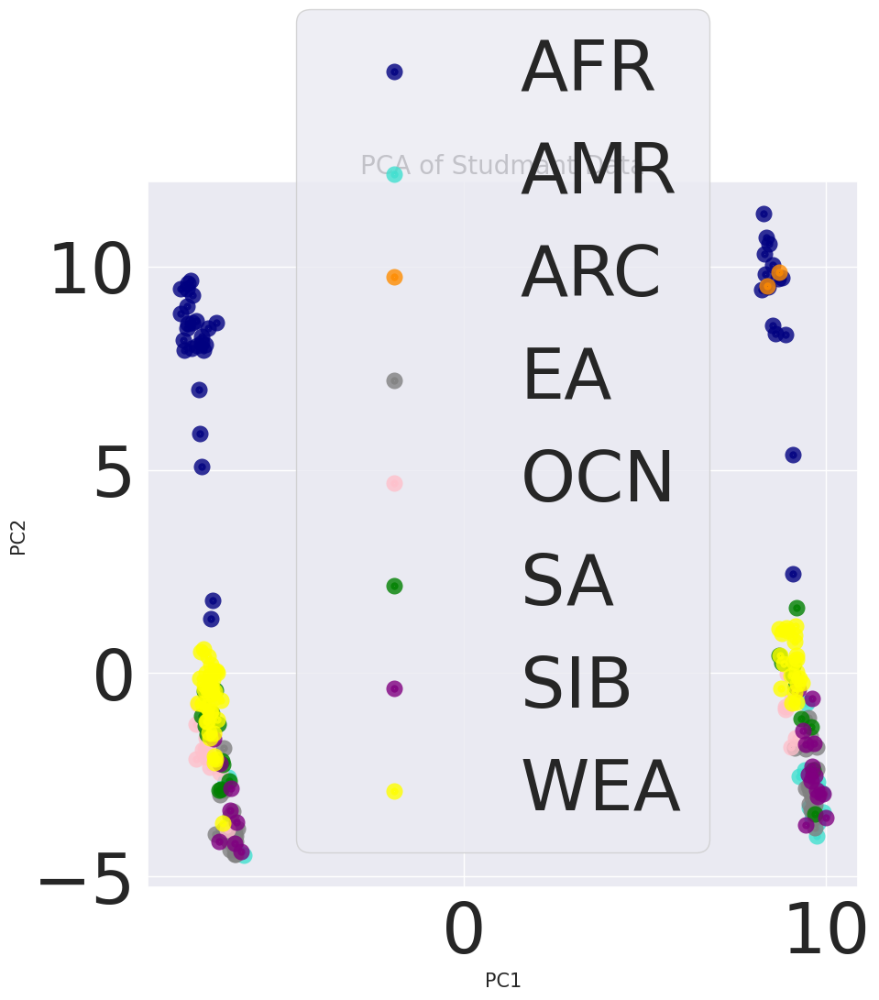

In [48]:
features = studmant_anotation.merge(X, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]

y = features.Region.astype('category').cat.codes
target_names = np.array(['AFR', 'AMR', 'ARC', 'EA', 'OCN', 'SA', 'SIB', 'WEA'])#list(X.index)


pca = PCA(n_components=4)
X_r = pca.fit(X).transform(X)

# Percentage of variance explained for each components
print(
    "explained variance ratio (first four components): %s"
    % str(pca.explained_variance_ratio_)
)


plt.figure(figsize=(10, 10))

colors = ["navy", "turquoise", "darkorange", "gray", "pink", "green", "purple", "yellow"]
lw = 7

for color, i, target_name in zip(colors, [0,1,2,3,4,5,6,7], target_names):
    plt.scatter(
        X_r[y == i, 0], X_r[y == i, 1], color=color, alpha=0.8, lw=lw, label=target_name
    )
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Studmant Data", fontsize=20)
plt.xlabel('PC1', fontsize=15)
plt.ylabel('PC2', fontsize=15)

plt.show()


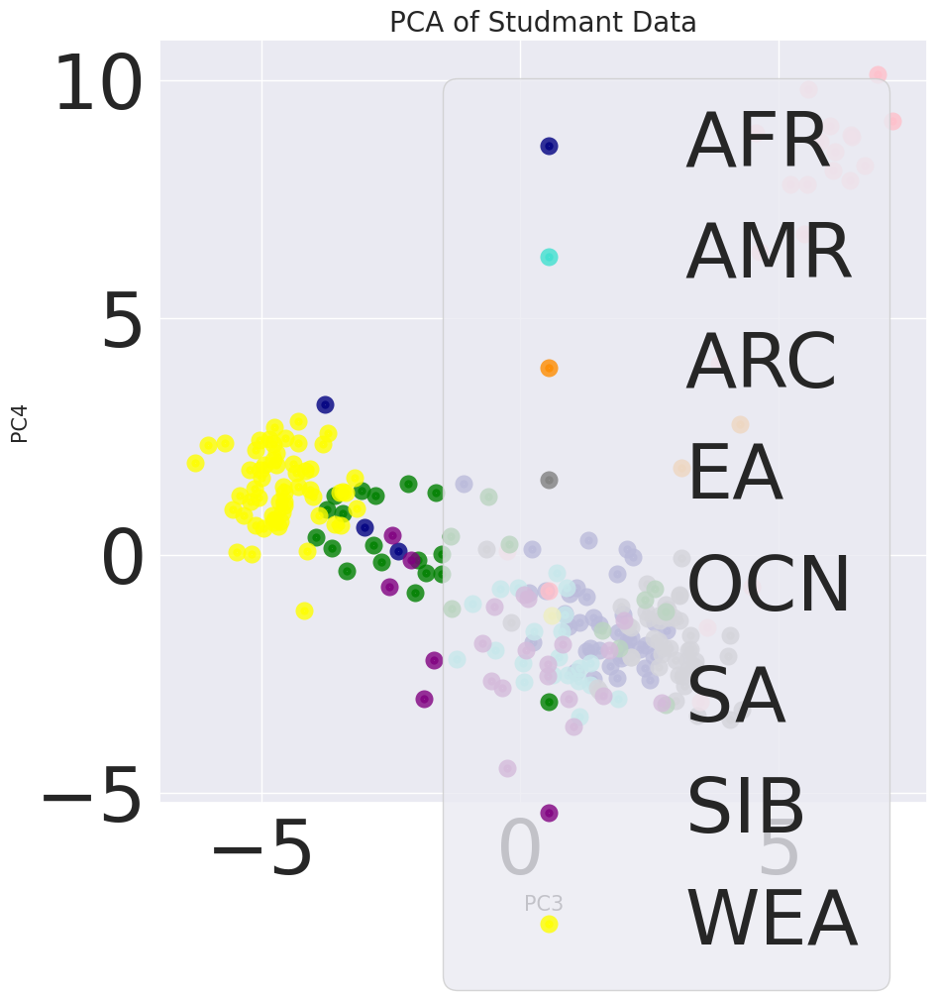

In [49]:
plt.figure(figsize=(10, 10))
colors = ["navy", "turquoise", "darkorange", "gray", "pink", "green", "purple", "yellow"]
lw = 7

for color, i, target_name in zip(colors, [0,1,2,3,4,5,6,7], target_names):
    plt.scatter(
        X_r[y == i, 2], X_r[y == i, 3], color=color, alpha=0.8, lw=lw, label=target_name
    )
plt.legend(loc="best", shadow=False, scatterpoints=1)
plt.title("PCA of Studmant Data", fontsize=20)
plt.xlabel('PC3', fontsize=15)
plt.ylabel('PC4', fontsize=15)
plt.show()


In [50]:
count = counts.T
features = studmant_anotation.merge(count, left_index=True, right_index=True)
features = features.loc[:,["Region", "Country"]]

#imputation and normalization 
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#X = imp.fit_transform(counts.T)
#x = StandardScaler().fit_transform(counts.T)

#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts.T)

#pca = PCA(n_components=10)
#pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)

df_pca = features.merge(df_pca, left_index=True, right_index=True)


In [51]:
pca.explained_variance_ratio_

array([0.19544748, 0.05440631, 0.03412876, 0.02418402, 0.01688253,
       0.01357942, 0.01003285, 0.00852155, 0.00729886, 0.00662105])

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392263   

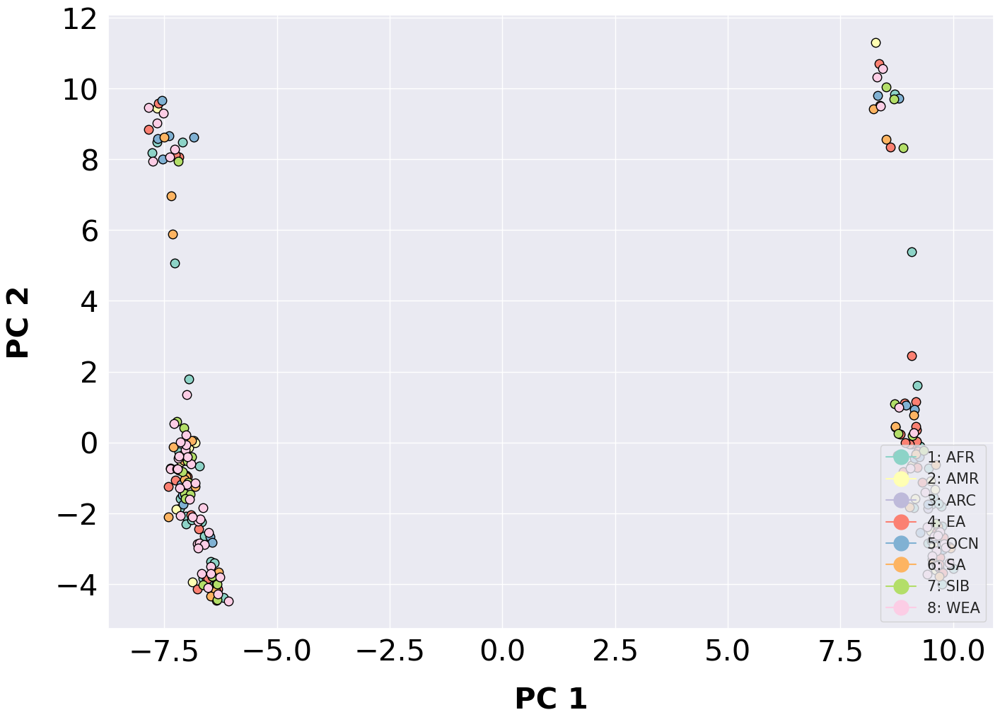

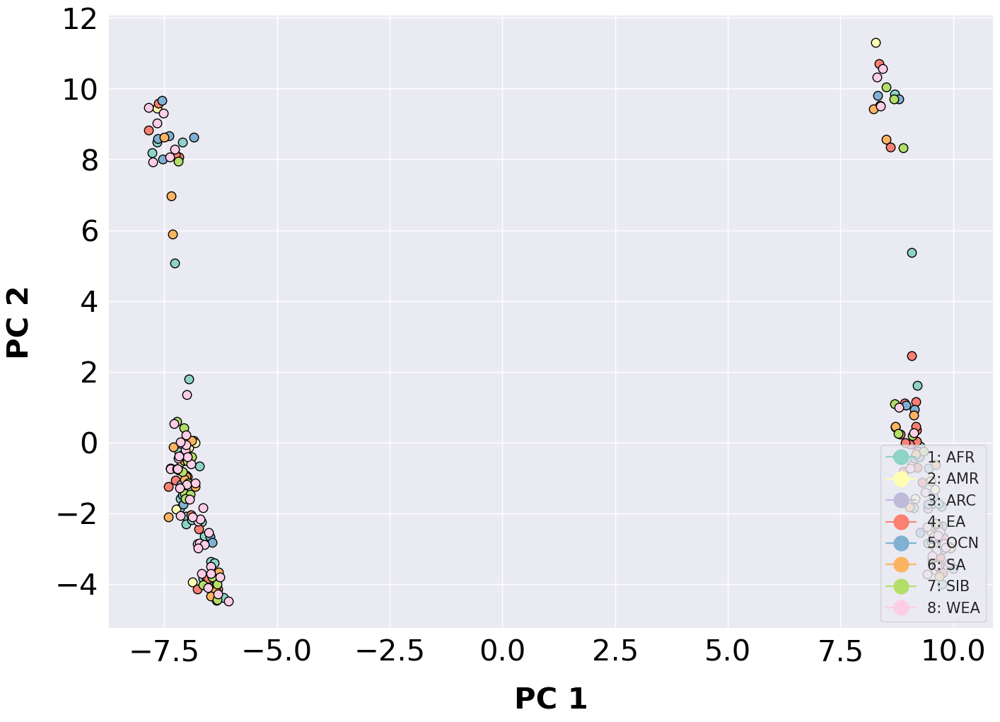

In [52]:
plot_scatter_cluster(data=df_pca, abscissa='component_1', ordinate='component_2', label_horizontal='PC 1', label_vertical='PC 2', factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392263   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392263   

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392263   

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


Count of groups by factor: 8
              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642

              Country  component_1  component_2  component_3  component_4  \
Region                                                                      
AFR        BantuKenya     9.132242    -1.836121    -0.645044     0.121763   
AFR        BantuKenya     9.556560    -1.539194     3.075218    -1.375235   
AFR     BantuSEHerero    -6.472161    -3.369312    -1.668792    -2.213528   
AFR     BantuSEHerero     9.078236     5.380755    -1.094741     1.510475   
AFR     BantuSETswana    -7.661655     8.481486     1.353040    -1.949349   
...               ...          ...          ...          ...          ...   
WEA          SpainIBS    -7.200144    -0.754307     6.048445     8.117096   
WEA            Tuscan    -7.140537    -2.064879     6.661008     8.210485   
WEA            Tuscan    -7.174189    -0.384488    -4.667757     1.127771   
WEA       YemeniteJew    -6.815486    -1.139083    -4.688522     0.604921   
WEA       YemeniteJew    -7.156184    -1.286642    -1.511111    -0.392263   

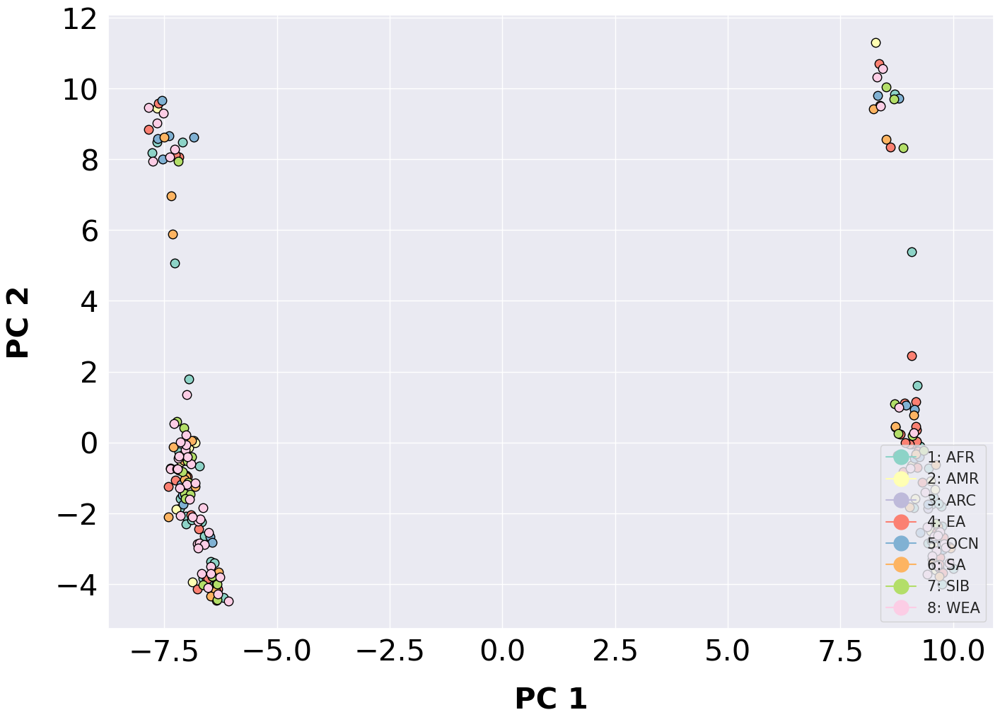

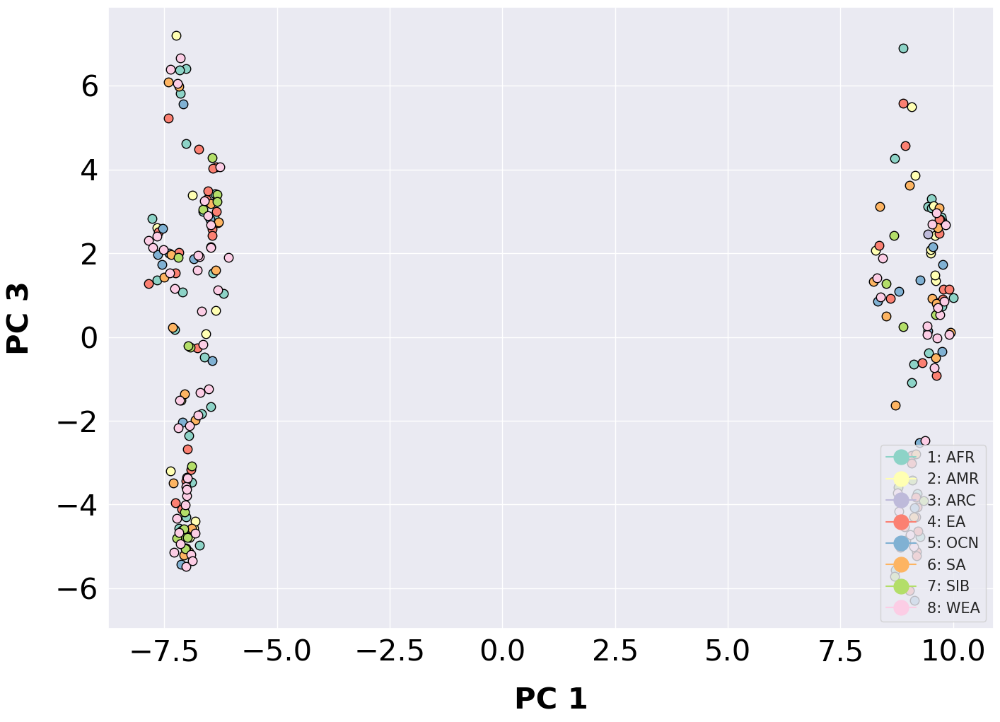

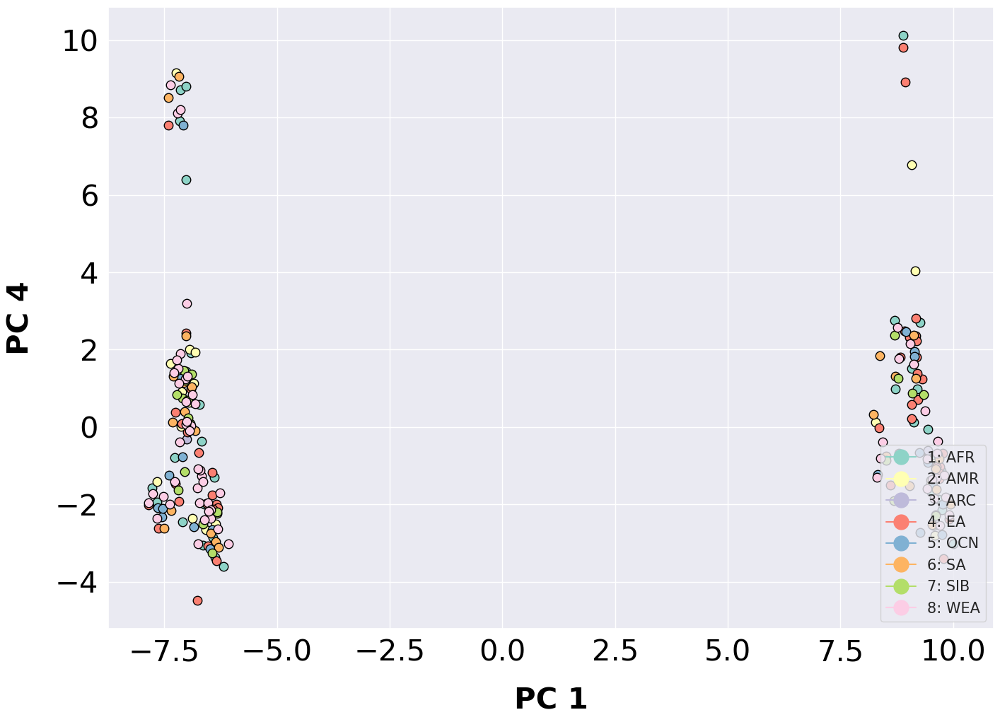

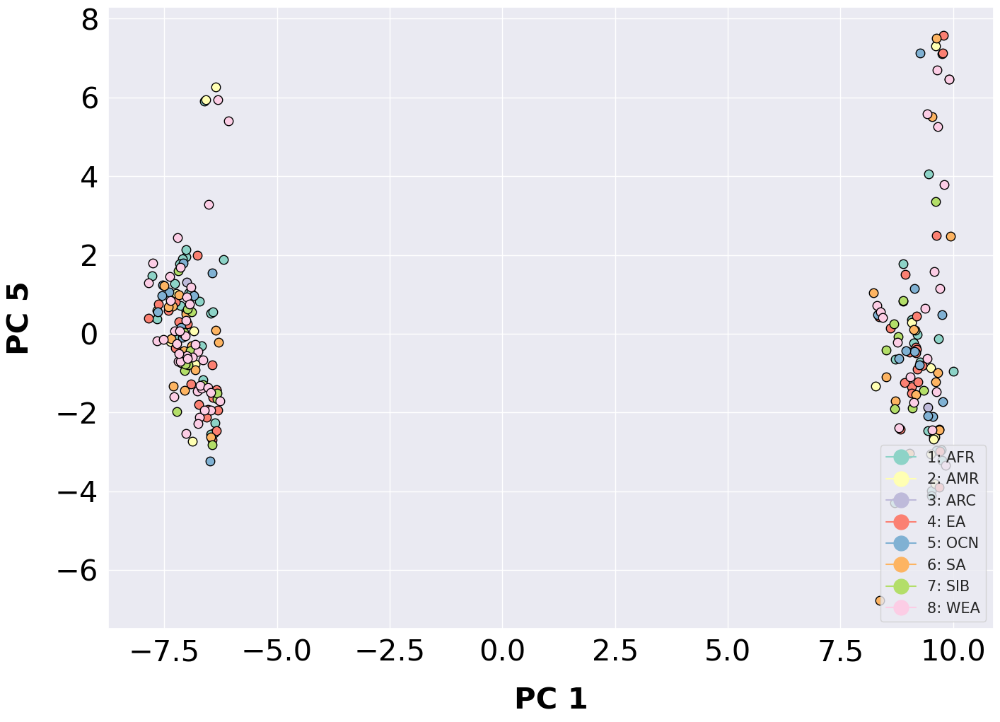

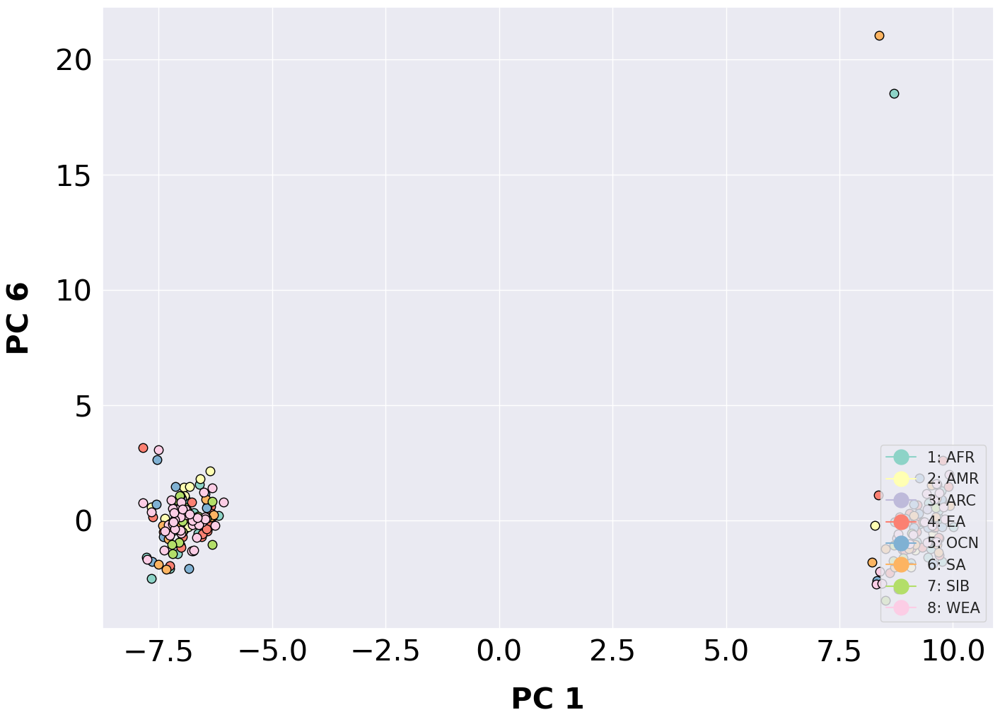

...

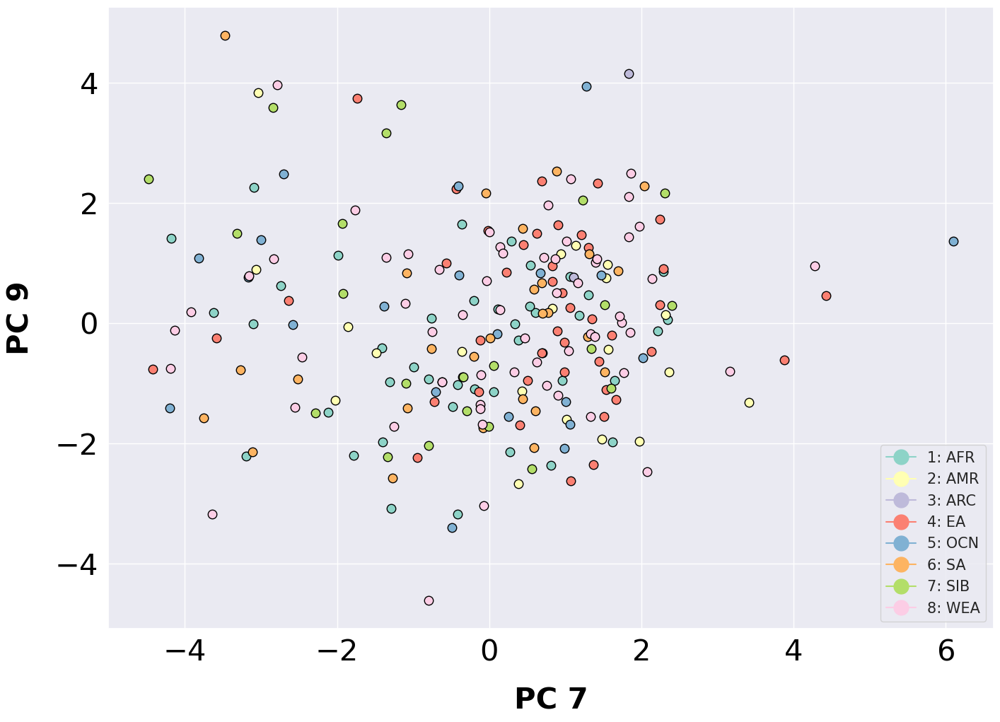

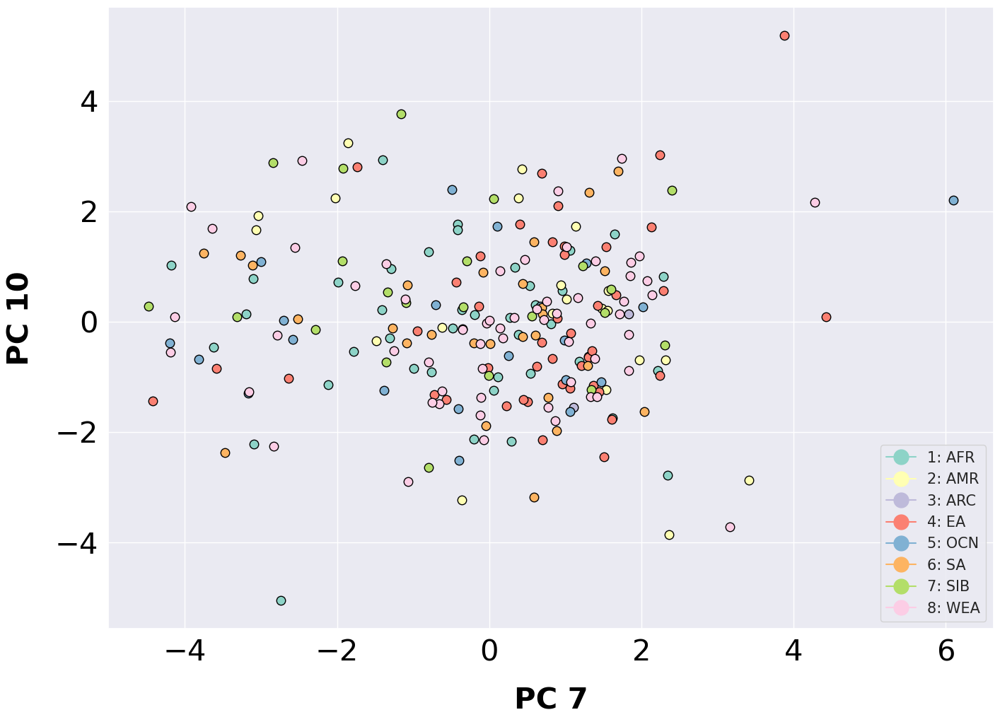

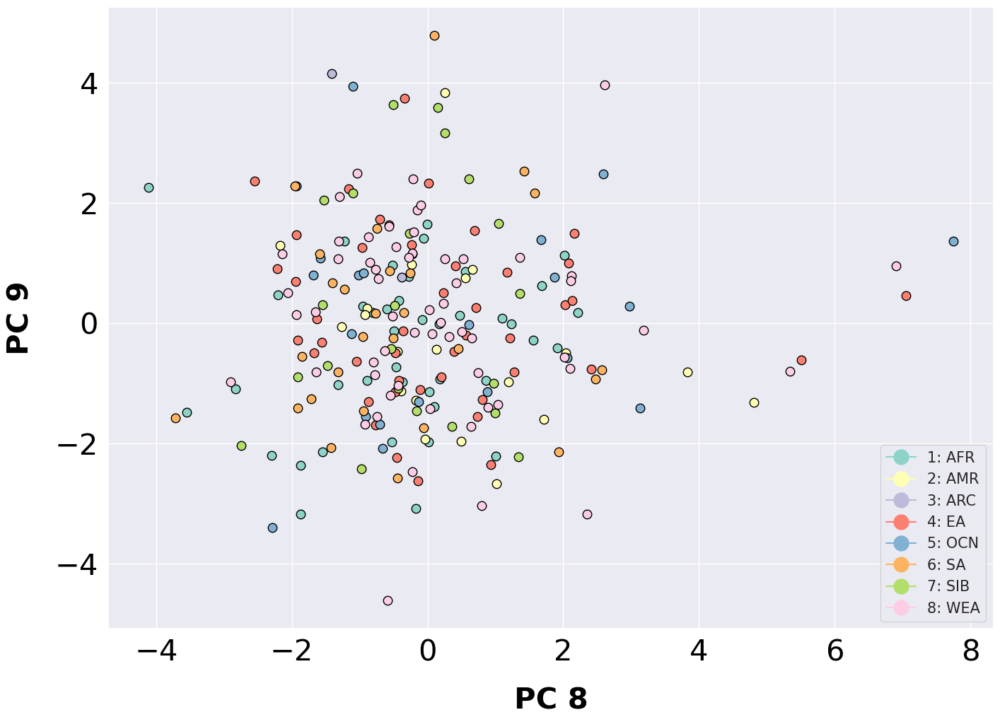

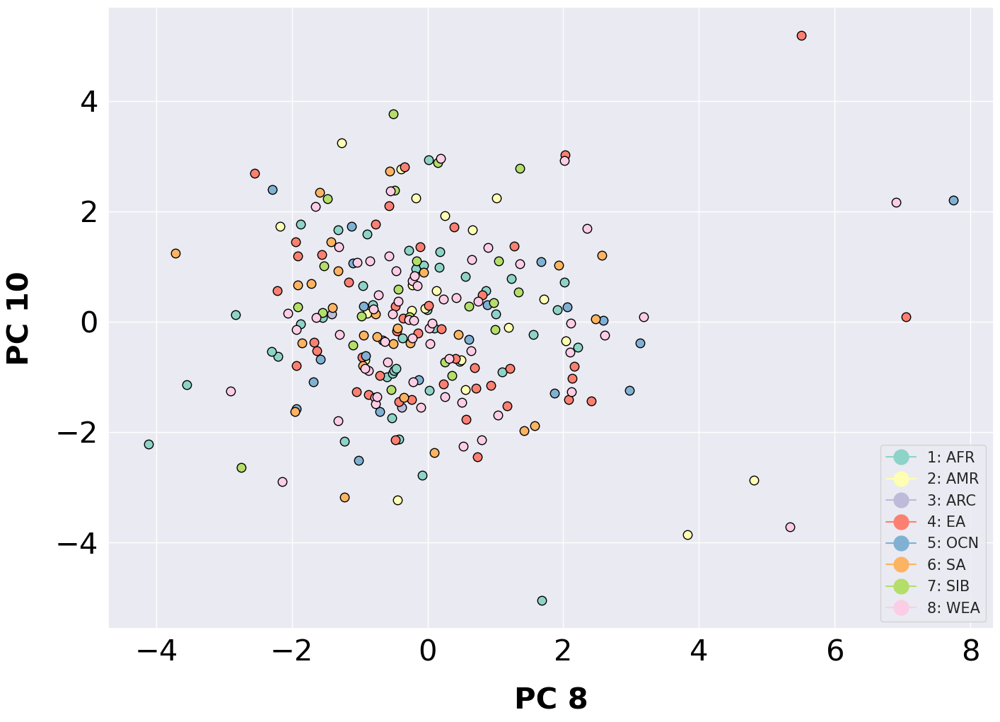

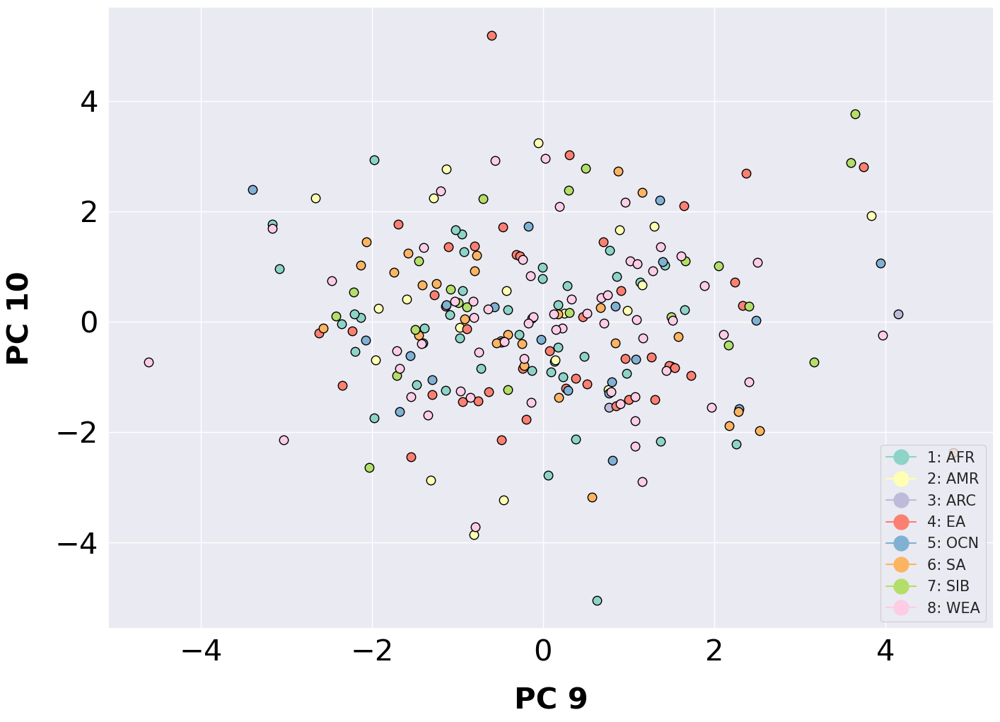

In [53]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h2> My data with only archaic paper samples 

In [54]:
hg_anotation = pd.read_csv('/home/jbazanwilliamson/borgstore/branchinecta/jbazanwilliamson/archaic_cnv_anotation.csv', index_col=2)

anotation_for_hg = pd.read_csv('../data/SGDP_anotation.csv', sep=',', encoding='latin-1', index_col=0)
new_anotation = anotation_for_hg.merge(hg_anotation, left_index=True, right_index=True)
#new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation = new_anotation.set_index("Sample")

new_anotation = new_anotation.merge(archaic_anotation, left_index=True, right_index=True)
new_anotation = new_anotation.set_index("3-Illumina_ID")
new_anotation


,4-reich_id,5-ena_ftp_bam_ptr,6-Sequencing_Panel,7-Gender,8-Population_ID,9-Contributor,10-Region,11-Country,12-Town,13-Latitude,14-Longitude,15-DNA_Source,16-BioSamples Accession,17-Embargo,Sex_x,Population_code,Sample,Region,Country,Sex_y
3-Illumina_ID,,,,,,,,,,,,,,,,,,,,
LP6005677-DNA_B01,S_Albanian-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324400/LP6005...,C,F,Albanian,David Comas,WestEurasia,Albania,Tirana,41.30,19.80,Genomic_from_blood,SAMEA3302780,FullyPublic,female,Albanian,EUR_Albanian_ALB212_,EUR,Albanian,NaN
LP6005443-DNA_D05,S_Tlingit-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324311/LP6005...,C,F,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302889,FullyPublic,female,Tlingit,SIB_TlingitNikolskoye_Ale14_F,SIB,TlingitNikolskoye,F
LP6005443-DNA_H02,S_Aleut-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324343/LP6005...,C,F,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302642,FullyPublic,female,Aleut,SIB_AleutBeringIsland_Ale20_F,SIB,AleutBeringIsland,F
LP6005443-DNA_A03,S_Aleut-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324286/LP6005...,C,M,Aleut,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Nikolskoye, Commander Islands",55.18,166.00,Genomic_from_blood,SAMEA3302773,FullyPublic,male,Aleut,SIB_AleutBeringIsland_Ale22_M,SIB,AleutBeringIsland,M
LP6005443-DNA_E05,S_Tlingit-1,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324318/LP6005...,C,M,Tlingit,Rem Sukernik / Stanislav Dryomov,CentralAsiaSiberia,Russia,"Petropavlovsk-Kamchatski, Commander Islands",53.00,158.65,Genomic_from_blood,SAMEA3302853,FullyPublic,male,Tlingit,SIB_TlingitPreobrazhenskoye_Ale32_M,SIB,TlingitPreobrazhenskoye,M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005443-DNA_H11,S_Mixtec-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324348/LP6005...,C,F,Mixtec,William Klitz / Cheryl Winkler,America,Mexico,?,17.00,-97.00,Genomic_from_cell_lines,SAMEA3302811,FullyPublic,female,Mixtec,AMR_Mixtec_mixa0105_F,AMR,Mixtec,F
LP6005443-DNA_E11,S_Mixe-2,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324324/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tmazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302796,FullyPublic,female,Mixe,AMR_Mixe_mixe0002_F,AMR,Mixe,F
LP6005443-DNA_F11,S_Mixe-3,ftp.sra.ebi.ac.uk/vol1/ERZ324/ERZ324333/LP6005...,C,F,Mixe,William Klitz / Cheryl Winkler,America,Mexico,"Tamazulapan, Mixe",16.95,-96.58,Genomic_from_cell_lines,SAMEA3302723,FullyPublic,female,Mixe,AMR_Mixe_mixe0042_F,AMR,Mixe,F


In [55]:
samples_with_aberrations = list(new_anotation.index)

only_archaic_samples = qdnaseq_df[qdnaseq_df.Sample_ID.isin(samples_with_aberrations)]

only_archaic_samples

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,561401,563700,1.0,deletion,0.515678,2300.0,6.286550e-06,1.378130e-10
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,1642401,1646800,1.0,deletion,0.479367,4400.0,3.622100e-11,3.265140e-04
...,...,...,...,...,...,...,...,...,...,...
167256,LP6005677-DNA_F01,9,138479101,138480200,1.0,deletion,0.000000,1100.0,1.448840e-10,2.479530e-85
167257,LP6005677-DNA_F01,9,139663401,139665100,1.0,deletion,0.342230,1700.0,1.456840e-02,3.936460e-05
167258,LP6005677-DNA_F01,9,139912201,139913300,1.0,deletion,0.491329,1100.0,1.079430e-02,4.271100e-11
167259,LP6005677-DNA_F01,9,141118301,141121700,3.0,duplication,1.548300,3400.0,1.874970e-10,3.035980e-17


In [56]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = only_archaic_samples[only_archaic_samples['Type'] == 'deletion'] 
duplications= only_archaic_samples[only_archaic_samples['Type'] == 'duplication'] 
duplications

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.08923,6900.0,0.000000e+00,5.215800e-35
8,LP6005441-DNA_A01,1,12931701,12937200,3.0,duplication,1.93720,5500.0,0.000000e+00,2.777380e+01
15,LP6005441-DNA_A01,1,13178001,13182000,3.0,duplication,1.60333,4000.0,0.000000e+00,9.707000e-09
16,LP6005441-DNA_A01,1,16875201,16884000,3.0,duplication,1.45973,8800.0,0.000000e+00,4.021390e+04
17,LP6005441-DNA_A01,1,16885001,16906500,3.0,duplication,4.28452,21500.0,0.000000e+00,6.772410e+07
...,...,...,...,...,...,...,...,...,...,...
167242,LP6005677-DNA_F01,9,70650701,70654900,3.0,duplication,1.44435,4200.0,7.732300e-06,3.712950e+05
167243,LP6005677-DNA_F01,9,70663301,70667900,3.0,duplication,1.68017,4600.0,1.385850e-10,6.411030e+05
167246,LP6005677-DNA_F01,9,90528501,90531500,3.0,duplication,1.70224,3000.0,2.328940e-05,7.420850e+08
167259,LP6005677-DNA_F01,9,141118301,141121700,3.0,duplication,1.54830,3400.0,1.874970e-10,3.035980e-17


<h2> High frequency CNVs

In [57]:
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv

Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,LP6005592-DNA_D03,LP6005592-DNA_D04,LP6005592-DNA_E02,LP6005592-DNA_F03,LP6005592-DNA_G03,LP6005677-DNA_B01,LP6005677-DNA_D01,LP6005677-DNA_D03,LP6005677-DNA_E01,LP6005677-DNA_F01
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,231100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52794,9,141105101,141106700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52795,9,141105101,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52796,9,141105501,141107200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
52797,9,141105701,141107200,0.458801,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
counts = final_cnv.iloc[:,3:283]
counts = counts.fillna(2)
X = counts.T
X = X.sort_index()
X

,0,1,2,3,4,5,6,7,8,9,...,52789,52790,52791,52792,52793,52794,52795,52796,52797,52798
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.458801,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005677-DNA_B01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,0.031425,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005677-DNA_D01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0
LP6005677-DNA_D03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.000000,2.0


In [59]:
features = anotation.merge(X, left_index=True, right_index=True)
features = features.loc[:,["10-Region", "11-Country"]]
features = features.sort_index()
features

,10-Region,11-Country
LP6005441-DNA_A01,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,America,Colombia
LP6005441-DNA_A05,WestEurasia,France
LP6005441-DNA_A06,WestEurasia,Italy(Bergamo)
...,...,...
LP6005677-DNA_B01,WestEurasia,Albania
LP6005677-DNA_D01,America,Mexico
LP6005677-DNA_D03,Africa,SouthAfrica
LP6005677-DNA_E01,America,Peru


In [60]:
#PCA
pca = PCA(n_components=10)
pca_results = pca.fit(X).transform(X)

#pca = PCA(n_components=10)
#pca_results = pca.fit_transform(x)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)

df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca 

,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,WestEurasia,Russia(Caucasus),0.159642,-0.875348,-4.701992,1.058968,-0.584606,0.085575,-4.596504,1.398904,-0.254524,0.250176
LP6005441-DNA_A03,Oceania,PapuaNewGuinea,-0.595648,1.914270,1.838884,-4.778830,-0.308998,-1.754701,-1.002475,5.932560,0.290172,0.900356
LP6005441-DNA_A04,America,Colombia,-2.440082,5.478034,4.268953,10.673623,0.254373,-2.440693,-2.965543,1.707653,-2.184430,4.155149
LP6005441-DNA_A05,WestEurasia,France,0.672037,-3.103514,-5.696471,-0.254860,-0.146664,0.092799,0.854110,2.322070,0.191253,-2.116975
LP6005441-DNA_A06,WestEurasia,Italy(Bergamo),0.362415,-2.844170,-7.737650,1.059988,-0.971672,-0.623680,-2.108893,0.637849,1.365988,1.466738
...,...,...,...,...,...,...,...,...,...,...,...,...
LP6005677-DNA_B01,WestEurasia,Albania,0.217985,-2.358062,-6.922832,0.893917,-3.139252,-0.837366,-0.889916,3.000008,-2.096382,0.503603
LP6005677-DNA_D01,America,Mexico,-1.715534,4.741452,1.772035,9.210149,-0.666354,-0.548072,-0.152654,1.284962,12.612222,11.383802
LP6005677-DNA_D03,Africa,SouthAfrica,2.940612,-10.363458,7.309151,3.237666,-2.965710,0.183799,3.278015,-2.583889,3.375657,-4.681947
LP6005677-DNA_E01,America,Peru,-1.752062,5.011996,1.790012,9.705576,1.379024,-2.778282,0.071750,-0.783146,-4.014549,-3.921572


                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.159642    -0.875348    -4.701992   
Oceania        PapuaNewGuinea    -0.595648     1.914270     1.838884   
America              Colombia    -2.440082     5.478034     4.268953   
WestEurasia            France     0.672037    -3.103514    -5.696471   
WestEurasia    Italy(Bergamo)     0.362415    -2.844170    -7.737650   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.217985    -2.358062    -6.922832   
America                Mexico    -1.715534     4.741452     1.772035   
Africa            SouthAfrica     2.940612   -10.363458     7.309151   
America                  Peru    -1.752062     5.011996     1.790012   
America                  Peru    -2.079205     4.688108     2.018042   

             component_4  component_5  component_6  component_7

                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.159642    -0.875348    -4.701992   
Oceania        PapuaNewGuinea    -0.595648     1.914270     1.838884   
America              Colombia    -2.440082     5.478034     4.268953   
WestEurasia            France     0.672037    -3.103514    -5.696471   
WestEurasia    Italy(Bergamo)     0.362415    -2.844170    -7.737650   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.217985    -2.358062    -6.922832   
America                Mexico    -1.715534     4.741452     1.772035   
Africa            SouthAfrica     2.940612   -10.363458     7.309151   
America                  Peru    -1.752062     5.011996     1.790012   
America                  Peru    -2.079205     4.688108     2.018042   

             component_4  component_5  component_6  component_7

                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.159642    -0.875348    -4.701992   
Oceania        PapuaNewGuinea    -0.595648     1.914270     1.838884   
America              Colombia    -2.440082     5.478034     4.268953   
WestEurasia            France     0.672037    -3.103514    -5.696471   
WestEurasia    Italy(Bergamo)     0.362415    -2.844170    -7.737650   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.217985    -2.358062    -6.922832   
America                Mexico    -1.715534     4.741452     1.772035   
Africa            SouthAfrica     2.940612   -10.363458     7.309151   
America                  Peru    -1.752062     5.011996     1.790012   
America                  Peru    -2.079205     4.688108     2.018042   

             component_4  component_5  component_6  component_7

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.159642    -0.875348    -4.701992   
Oceania        PapuaNewGuinea    -0.595648     1.914270     1.838884   
America              Colombia    -2.440082     5.478034     4.268953   
WestEurasia            France     0.672037    -3.103514    -5.696471   
WestEurasia    Italy(Bergamo)     0.362415    -2.844170    -7.737650   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.217985    -2.358062    -6.922832   
America                Mexico    -1.715534     4.741452     1.772035   
Africa            SouthAfrica     2.940612   -10.363458     7.309151   
America                  Peru    -1.752062     5.011996     1.790012   
America                  Peru    -2.079205     4.688108     2.018042   

             component_4  component_5  component_6  component_7

                   11-Country  component_1  component_2  component_3  \
10-Region                                                              
WestEurasia  Russia(Caucasus)     0.159642    -0.875348    -4.701992   
Oceania        PapuaNewGuinea    -0.595648     1.914270     1.838884   
America              Colombia    -2.440082     5.478034     4.268953   
WestEurasia            France     0.672037    -3.103514    -5.696471   
WestEurasia    Italy(Bergamo)     0.362415    -2.844170    -7.737650   
...                       ...          ...          ...          ...   
WestEurasia           Albania     0.217985    -2.358062    -6.922832   
America                Mexico    -1.715534     4.741452     1.772035   
Africa            SouthAfrica     2.940612   -10.363458     7.309151   
America                  Peru    -1.752062     5.011996     1.790012   
America                  Peru    -2.079205     4.688108     2.018042   

             component_4  component_5  component_6  component_7

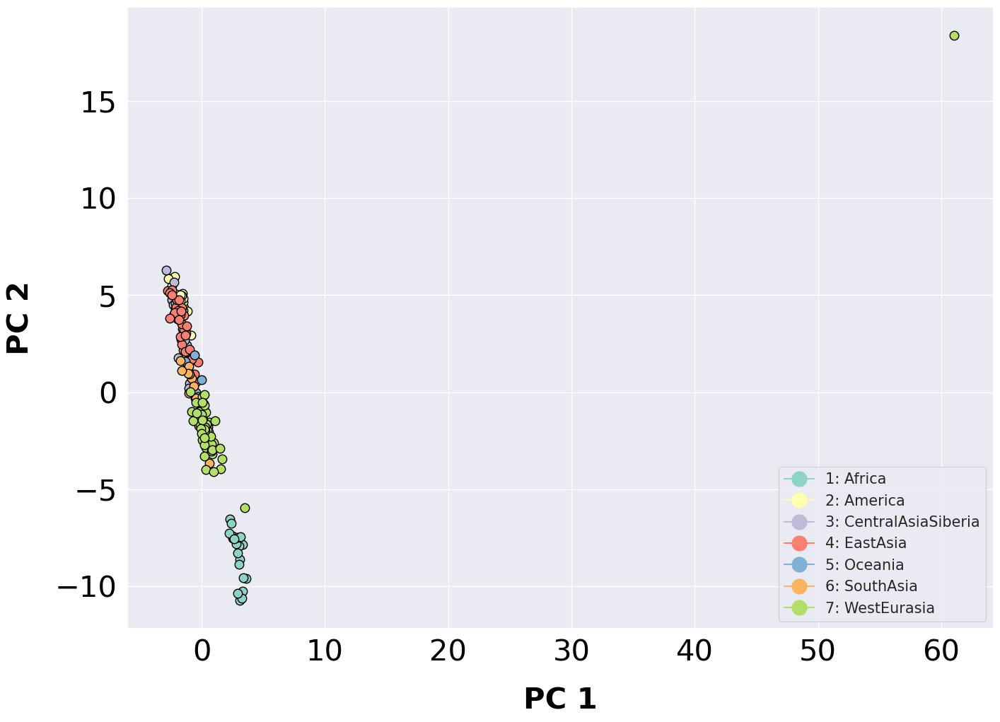

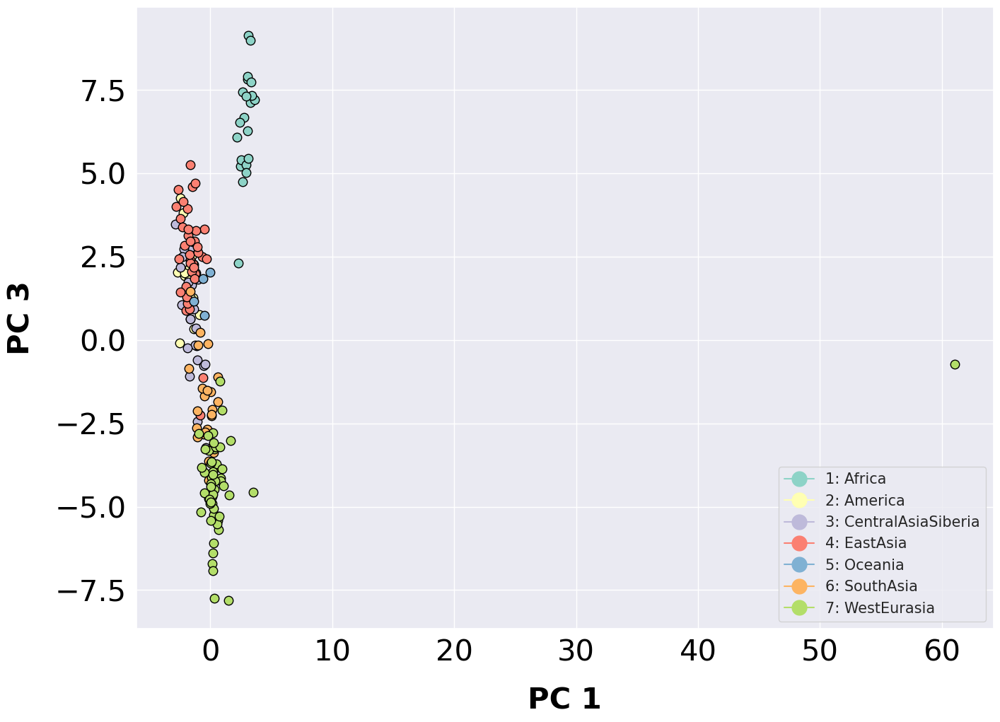

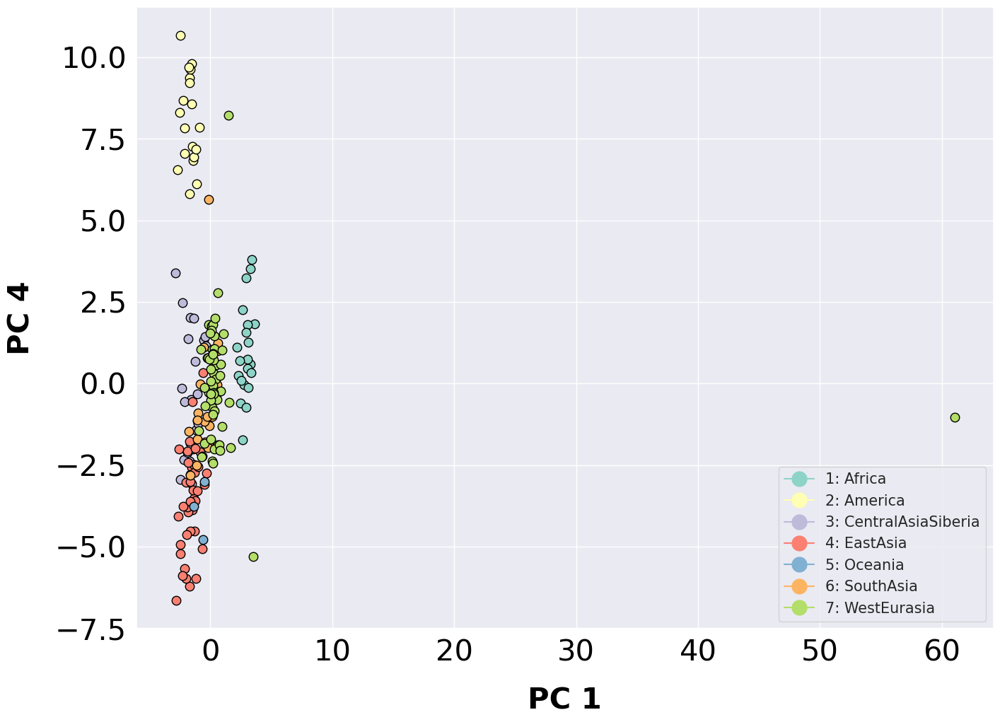

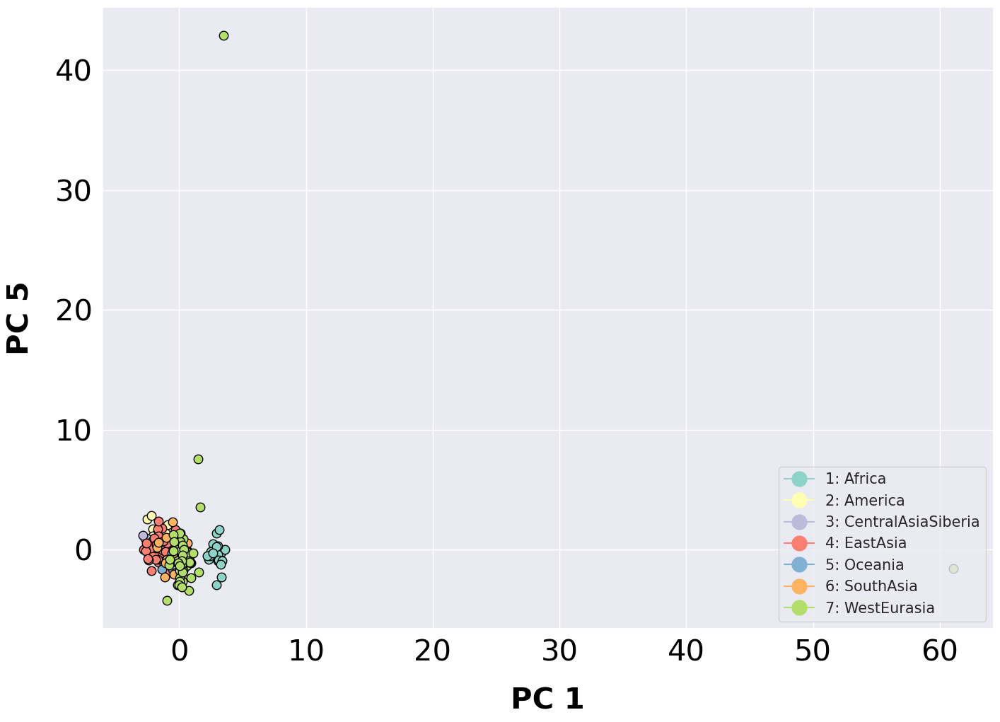

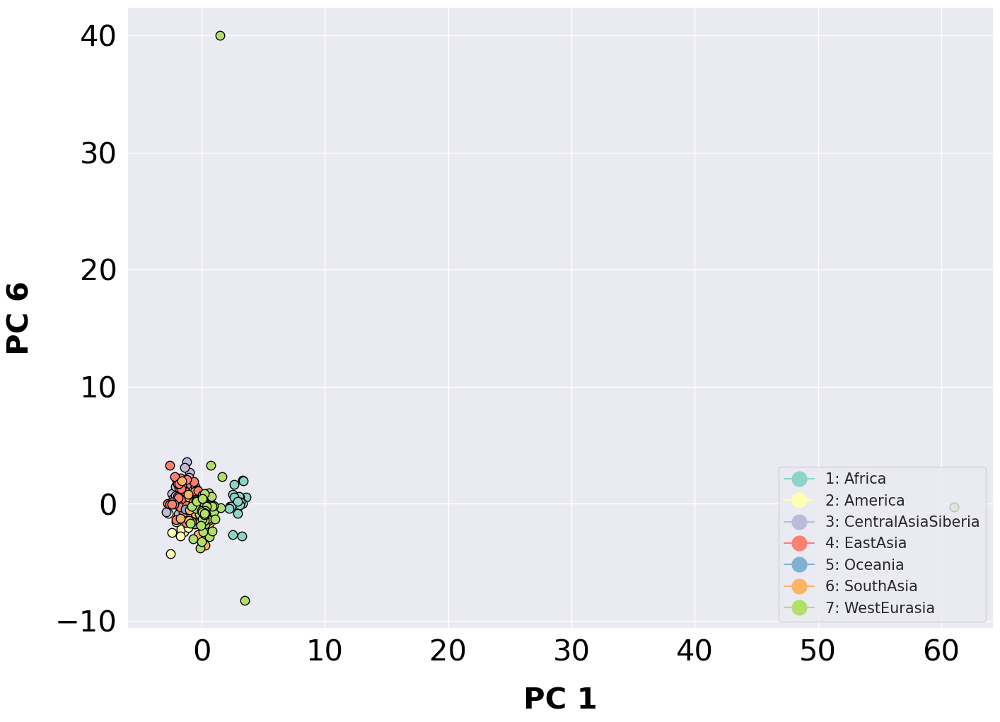

...

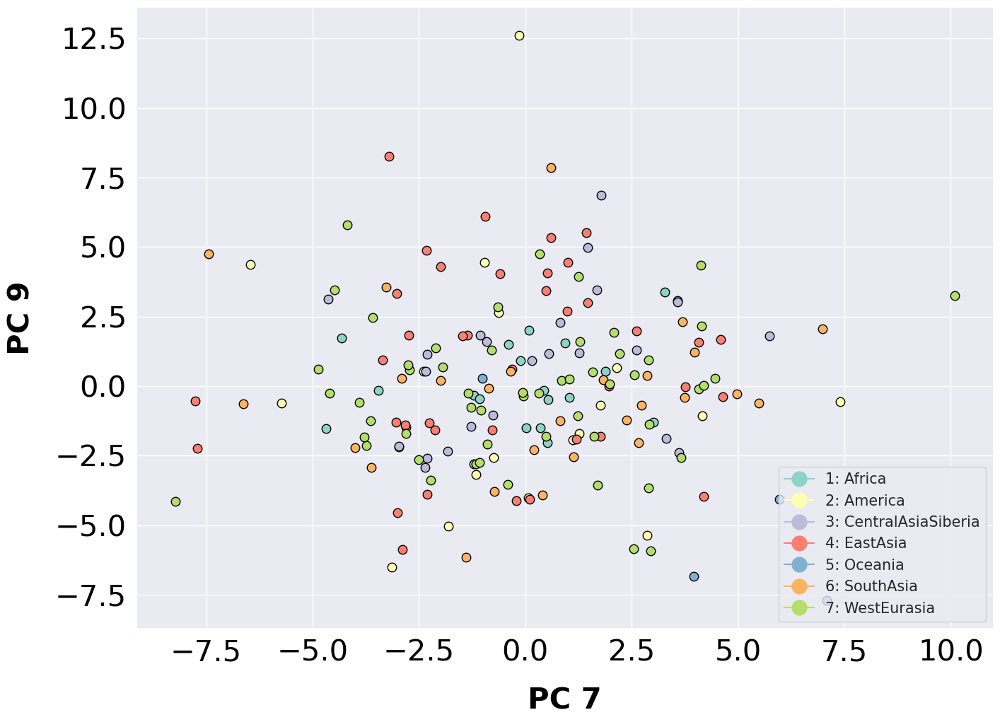

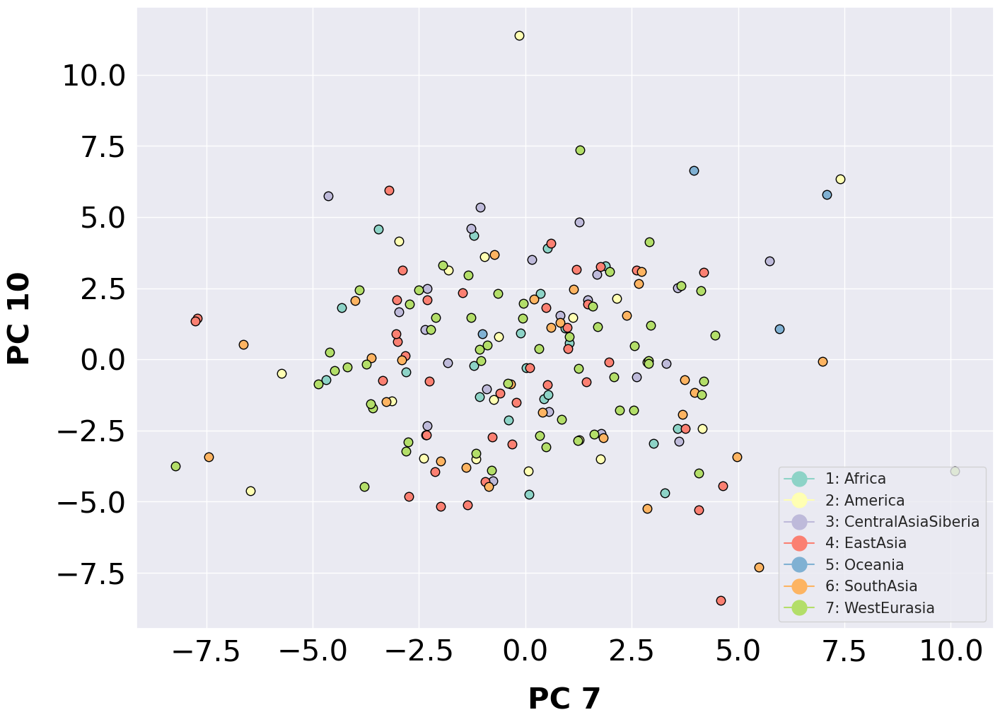

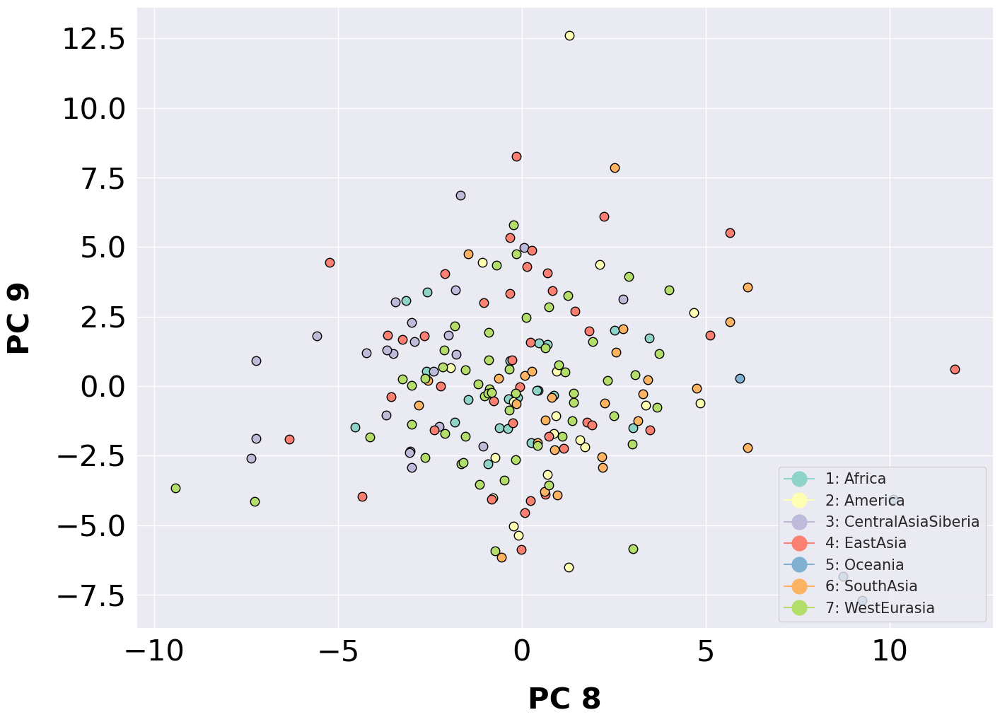

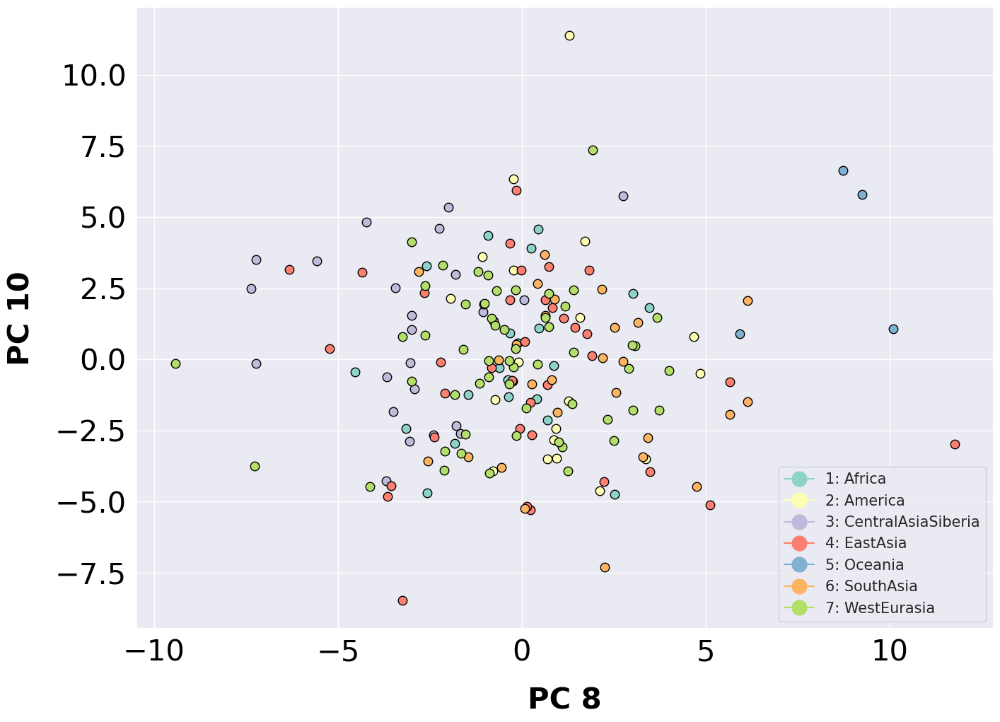

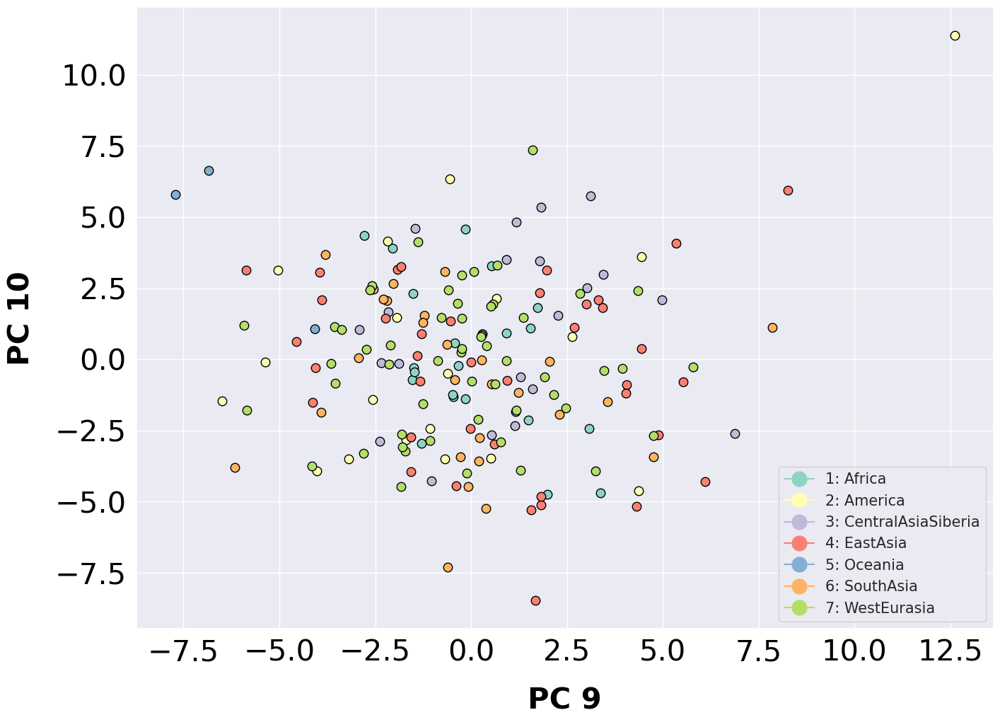

In [61]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

<h1> getting overlapping regions with sudmant

In [62]:
studmant_data = studmant_data.rename(columns={"contig": "Chromosome", "start": "Start", "end":"End"})

In [71]:
studmant_ranges = PyRanges(studmant_data)

qdnaseq_df = cnvnator_style_ranges.overlap(studmant_ranges, invert=False)
qdnaseq_df = qdnaseq_df.as_df()

qdnaseq_df = qdnaseq_df.sort_values(by=['Sample_ID','Chromosome', 'Start'])
qdnaseq_df#.sort_values(by=['Chromosome', 'Start'])
qdnaseq_df.to_csv('../data/cnvnator_cnvs.csv', index=False)
qdnaseq_df

,Sample_ID,Chromosome,Start,End,CNV_value,Type,RD,Lenght,T-TEST-EVAL,GAUSSIAN-EVAL
0,LP6005441-DNA_A01,1,231001,237900,3.0,duplication,2.089230,6900.0,0.000000e+00,5.215800e-35
1,LP6005441-DNA_A01,1,471201,551200,1.0,deletion,0.187758,80000.0,1.992160e-12,2.215930e+09
2,LP6005441-DNA_A01,1,723801,728100,3.0,duplication,1.594500,4300.0,1.120070e-02,1.742820e+09
3,LP6005441-DNA_A01,1,1010901,1014200,1.0,deletion,0.498249,3300.0,5.434590e-04,2.196950e+09
4,LP6005441-DNA_A01,1,4124201,4127700,1.0,deletion,0.505571,3500.0,4.553500e-11,2.217790e-35
...,...,...,...,...,...,...,...,...,...,...
229336,SS6004480,X,153459601,153466400,3.0,duplication,1.882080,6800.0,3.234320e-09,7.076210e+01
229337,SS6004480,X,153474401,153496200,3.0,duplication,1.734000,21800.0,0.000000e+00,2.123580e+09
229338,SS6004480,X,153498901,153518500,3.0,duplication,1.886020,19600.0,0.000000e+00,2.117350e+07
229339,SS6004480,X,154798801,154804000,1.0,deletion,0.315173,5200.0,3.064860e-11,2.713240e+05


In [64]:
#qdnaseq_df = qdnaseq_df_no_sex_chr
deletions = qdnaseq_df[qdnaseq_df['Type'] == 'deletion'] 
duplications= qdnaseq_df[qdnaseq_df['Type'] == 'duplication'] 


In [65]:
#change to df when using telomeres and centromeres filtration
final_cnv = deletions.pivot(index=["Chromosome", "Start", "End"], 
                    columns='Sample_ID', 
                    values='RD').reset_index()


final_cnv
#Sample_ID	Chr	Start	End	CNV_value	Type	RD	LENGHT	T-TEST-EVAL	GAUSSIAN-EVAL


Sample_ID,Chromosome,Start,End,LP6005441-DNA_A01,LP6005441-DNA_A03,LP6005441-DNA_A04,LP6005441-DNA_A05,LP6005441-DNA_A06,LP6005441-DNA_A08,LP6005441-DNA_A09,...,SS6004471,SS6004472,SS6004473,SS6004474,SS6004475,SS6004476,SS6004477,SS6004478,SS6004479,SS6004480
0,1,176101,230900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,176201,230100,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,176901,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,177001,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,177101,230500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62901,X,154918501,154922400,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62902,X,154918501,154922500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62903,X,154918501,154922700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
62904,X,154918601,154921700,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [66]:
from scipy import stats
#final_cnv = final_cnv.iloc[new]
final = final_cnv.iloc[:,3:284]
counts = final
counts = counts.fillna(2)

#counts = counts[counts.columns.intersection(counts_a.columns)]

#counts = counts.drop(columns=['LP6005592-DNA_G03',
#                     'LP6005443-DNA_E10',
#                     'LP6005442-DNA_E04'])

counts = counts.T
counts = counts.sort_index()
counts

,0,1,2,3,4,5,6,7,8,9,...,62896,62897,62898,62899,62900,62901,62902,62903,62904,62905
Sample_ID,,,,,,,,,,,,,,,,,,,,,
LP6005441-DNA_A01,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A03,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A04,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A05,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
LP6005441-DNA_A06,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
SS6004477,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
SS6004478,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,...,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0


In [67]:
#IMPUTATION

features = anotation.merge(counts, left_index=True, right_index=True)
features = features.loc[:,["7-Gender","10-Region", "11-Country",]]
features = features.sort_index()
features 


,7-Gender,10-Region,11-Country
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus)
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea
LP6005441-DNA_A04,F,America,Colombia
LP6005441-DNA_A05,M,WestEurasia,France
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo)
...,...,...,...
SS6004476,M,America,Brazil
SS6004477,M,Oceania,Australia
SS6004478,U,Oceania,Australia
SS6004479,F,America,Mexico


In [68]:
#imp = SimpleImputer(missing_values=np.nan, strategy='mean')
#x = imp.fit_transform(counts.T)

#track features for pca & tsne
#X = StandardScaler().fit_transform(x)


#PCA
pca = PCA(n_components=10)
pca_results = pca.fit_transform(counts)

df_pca= pd.DataFrame(pca_results,
                          columns=['component_1','component_2', 'component_3', 'component_4',
                                  'component_5',
                                  'component_6',
                                  'component_7',
                                  'component_8',
                                  'component_9',
                                   'component_10'
                                  ],
                          index=features.index)




df_pca = features.merge(df_pca, left_index=True, right_index=True)
df_pca

,7-Gender,10-Region,11-Country,component_1,component_2,component_3,component_4,component_5,component_6,component_7,component_8,component_9,component_10
LP6005441-DNA_A01,M,WestEurasia,Russia(Caucasus),-0.324519,-0.233769,0.142419,3.707558,-3.466618,-0.388730,-1.123079,-1.115935,-0.036166,1.780076
LP6005441-DNA_A03,F,Oceania,PapuaNewGuinea,-0.340427,-2.280243,-0.228065,-4.159558,2.165303,4.910083,-1.419408,0.246446,-1.087483,-1.319861
LP6005441-DNA_A04,F,America,Colombia,-0.881210,-4.183175,-0.305785,-2.565261,2.620550,-7.117270,5.683887,-0.840855,-3.034065,-3.165228
LP6005441-DNA_A05,M,WestEurasia,France,-0.102878,0.964518,0.676818,4.371609,-3.293717,0.643325,-1.102034,0.479134,-0.746809,1.339400
LP6005441-DNA_A06,M,WestEurasia,Italy(Bergamo),-0.284343,-0.916931,0.566539,4.578303,-3.363131,-0.654209,0.979926,2.386587,0.311799,-0.104941
...,...,...,...,...,...,...,...,...,...,...,...,...,...
SS6004476,M,America,Brazil,-0.122750,-2.094825,0.167384,-1.074543,2.183820,-5.092996,8.290679,2.224052,6.028854,-0.980804
SS6004477,M,Oceania,Australia,-0.063793,0.560920,-0.525915,-3.918727,2.779078,8.199676,5.542853,1.040983,3.436725,1.120909
SS6004478,U,Oceania,Australia,-0.555272,0.521837,-0.816110,-3.392300,1.340095,8.887810,3.192769,-0.218099,7.604162,1.213019
SS6004479,F,America,Mexico,-0.360881,-2.471683,0.227600,-2.312715,3.267799,-3.865198,9.422978,4.069228,11.188473,-5.693572


            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324519    -0.233769     0.142419   
Oceania            F    PapuaNewGuinea    -0.340427    -2.280243    -0.228065   
America            F          Colombia    -0.881210    -4.183175    -0.305785   
WestEurasia        M            France    -0.102878     0.964518     0.676818   
WestEurasia        M    Italy(Bergamo)    -0.284343    -0.916931     0.566539   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122750    -2.094825     0.167384   
Oceania            M         Australia    -0.063793     0.560920    -0.525915   
Oceania            U         Australia    -0.555272     0.521837    -0.816110   
America            F            Mexico    -0.360881    -2.471683     0.227600   
Africa             M        

Count of groups by factor: 7
            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324519    -0.233769     0.142419   
Oceania            F    PapuaNewGuinea    -0.340427    -2.280243    -0.228065   
America            F          Colombia    -0.881210    -4.183175    -0.305785   
WestEurasia        M            France    -0.102878     0.964518     0.676818   
WestEurasia        M    Italy(Bergamo)    -0.284343    -0.916931     0.566539   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122750    -2.094825     0.167384   
Oceania            M         Australia    -0.063793     0.560920    -0.525915   
Oceania            U         Australia    -0.555272     0.521837    -0.816110   
America            F            Mexico    -0.360881    -2.471683     0.227600   

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324519    -0.233769     0.142419   
Oceania            F    PapuaNewGuinea    -0.340427    -2.280243    -0.228065   
America            F          Colombia    -0.881210    -4.183175    -0.305785   
WestEurasia        M            France    -0.102878     0.964518     0.676818   
WestEurasia        M    Italy(Bergamo)    -0.284343    -0.916931     0.566539   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122750    -2.094825     0.167384   
Oceania            M         Australia    -0.063793     0.560920    -0.525915   
Oceania            U         Australia    -0.555272     0.521837    -0.816110   
America            F            Mexico    -0.360881    -2.471683     0.227600   
Africa             M        

/home/jbazanwilliamson/analysis/cnv_sgdp/scripts/pca_plot.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  figure = matplotlib.pyplot.figure(


            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324519    -0.233769     0.142419   
Oceania            F    PapuaNewGuinea    -0.340427    -2.280243    -0.228065   
America            F          Colombia    -0.881210    -4.183175    -0.305785   
WestEurasia        M            France    -0.102878     0.964518     0.676818   
WestEurasia        M    Italy(Bergamo)    -0.284343    -0.916931     0.566539   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122750    -2.094825     0.167384   
Oceania            M         Australia    -0.063793     0.560920    -0.525915   
Oceania            U         Australia    -0.555272     0.521837    -0.816110   
America            F            Mexico    -0.360881    -2.471683     0.227600   
Africa             M        

            7-Gender        11-Country  component_1  component_2  component_3  \
10-Region                                                                       
WestEurasia        M  Russia(Caucasus)    -0.324519    -0.233769     0.142419   
Oceania            F    PapuaNewGuinea    -0.340427    -2.280243    -0.228065   
America            F          Colombia    -0.881210    -4.183175    -0.305785   
WestEurasia        M            France    -0.102878     0.964518     0.676818   
WestEurasia        M    Italy(Bergamo)    -0.284343    -0.916931     0.566539   
...              ...               ...          ...          ...          ...   
America            M            Brazil    -0.122750    -2.094825     0.167384   
Oceania            M         Australia    -0.063793     0.560920    -0.525915   
Oceania            U         Australia    -0.555272     0.521837    -0.816110   
America            F            Mexico    -0.360881    -2.471683     0.227600   
Africa             M        

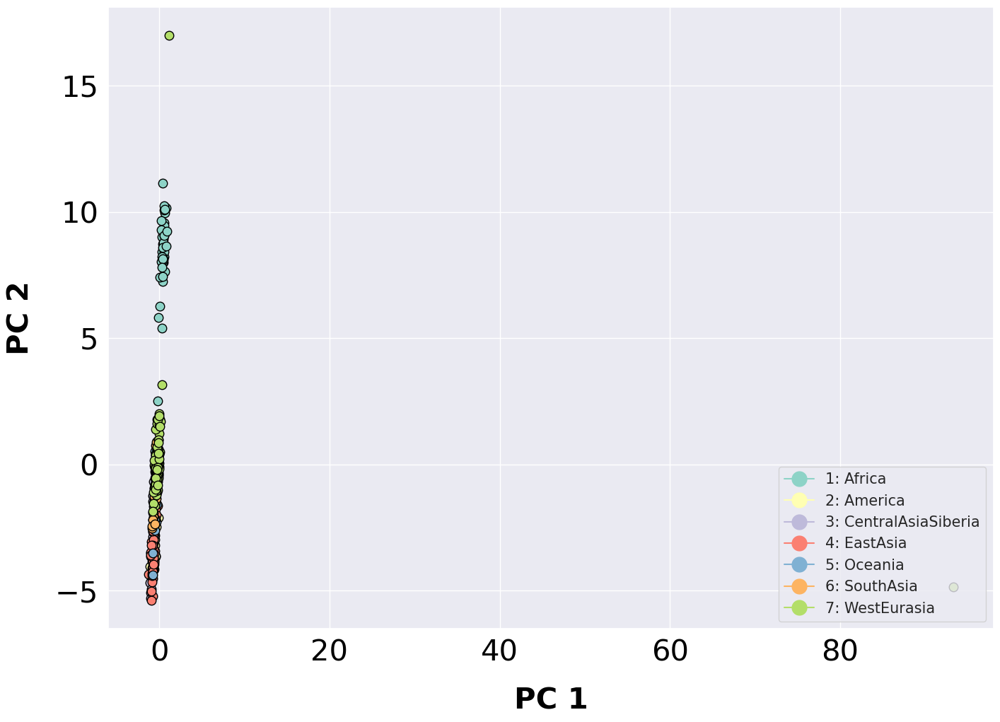

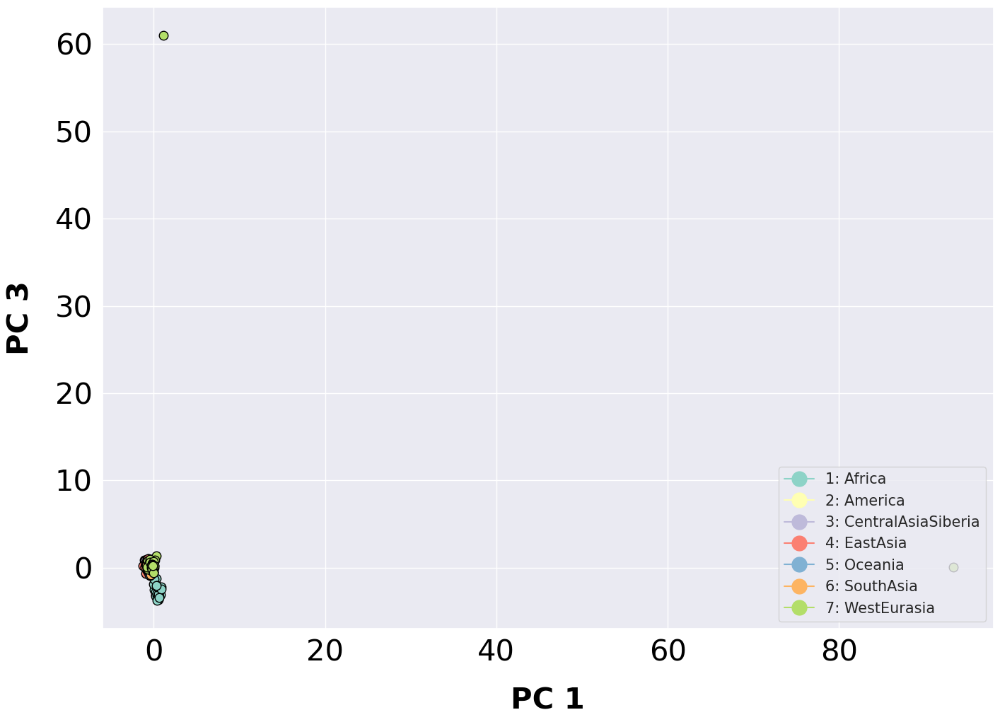

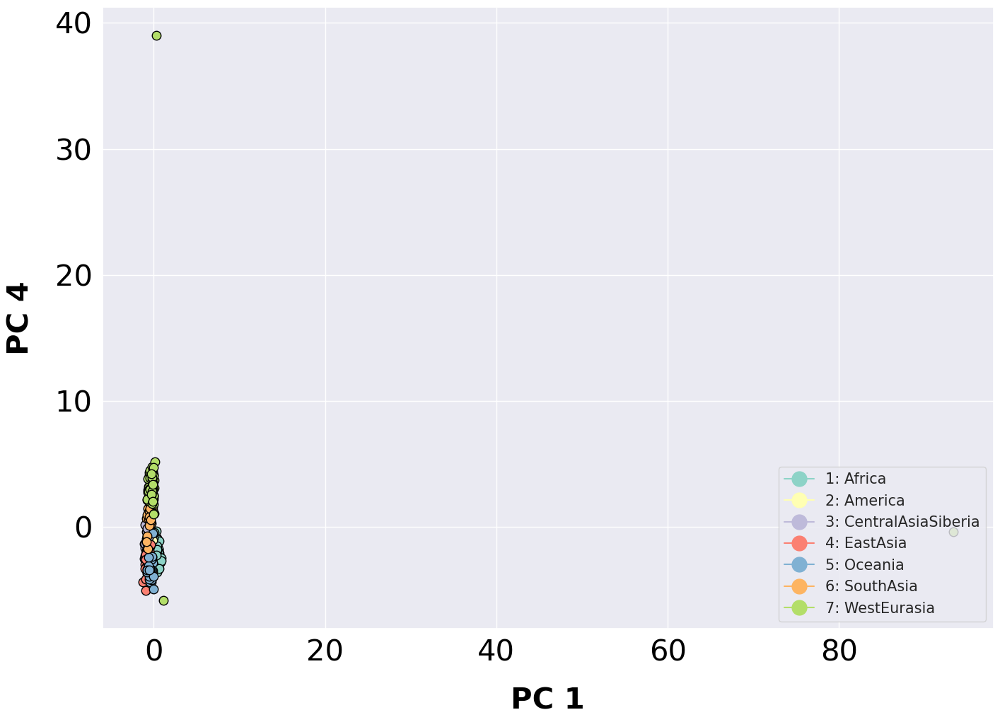

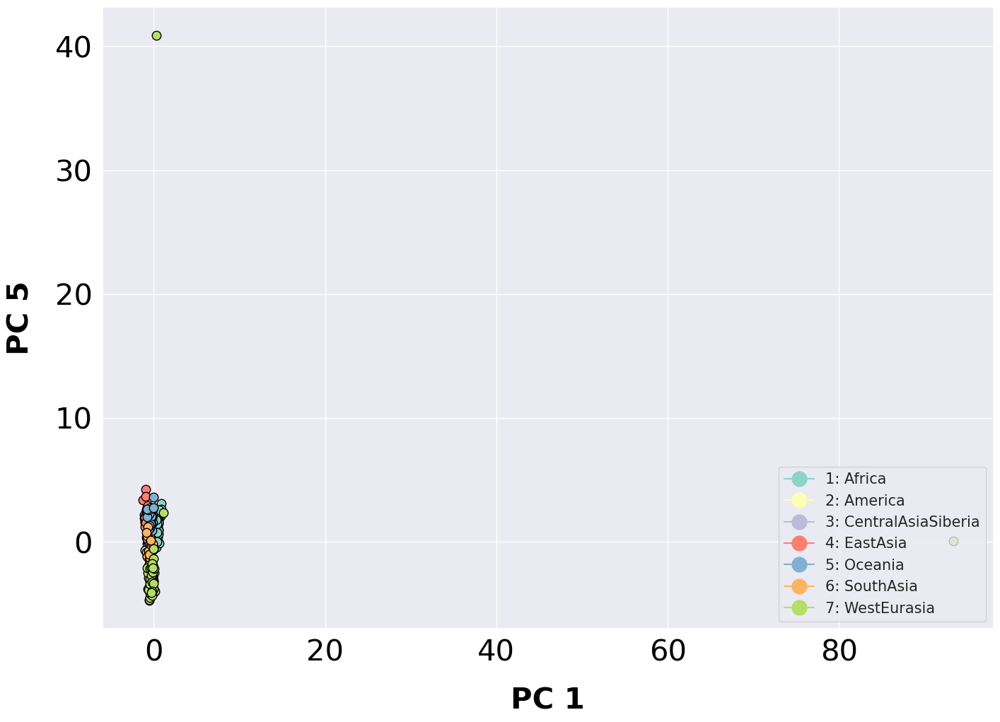

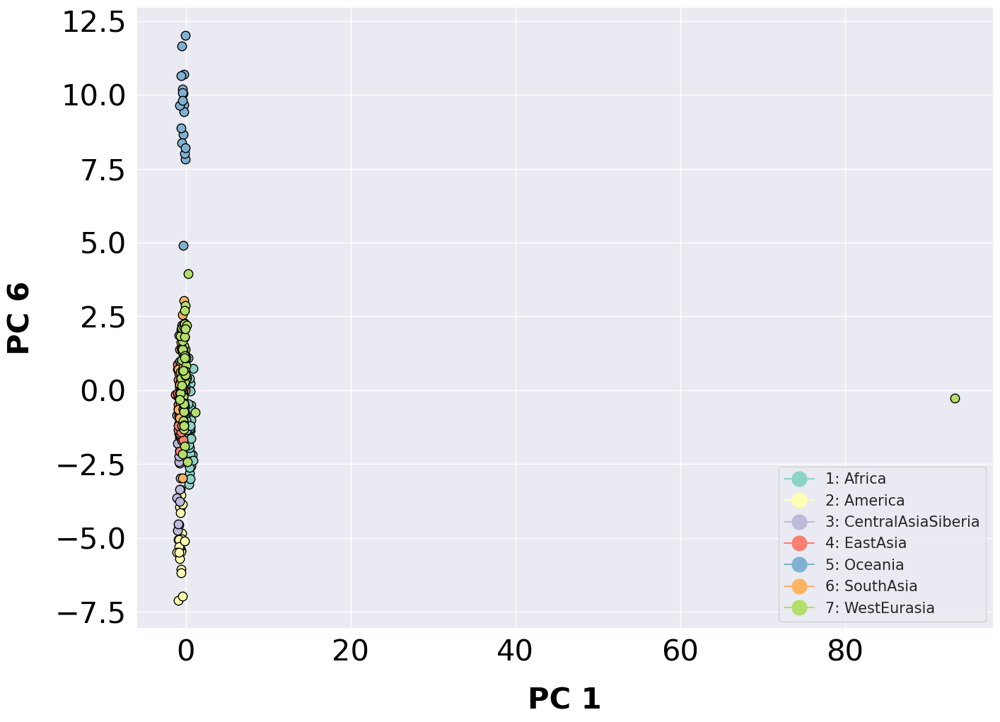

...

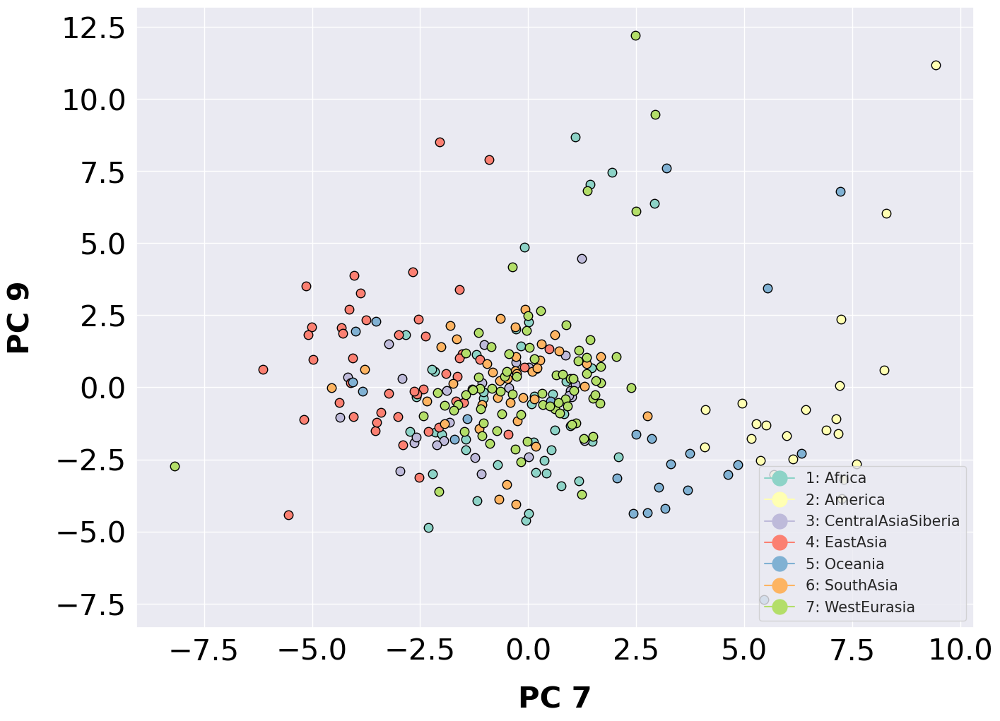

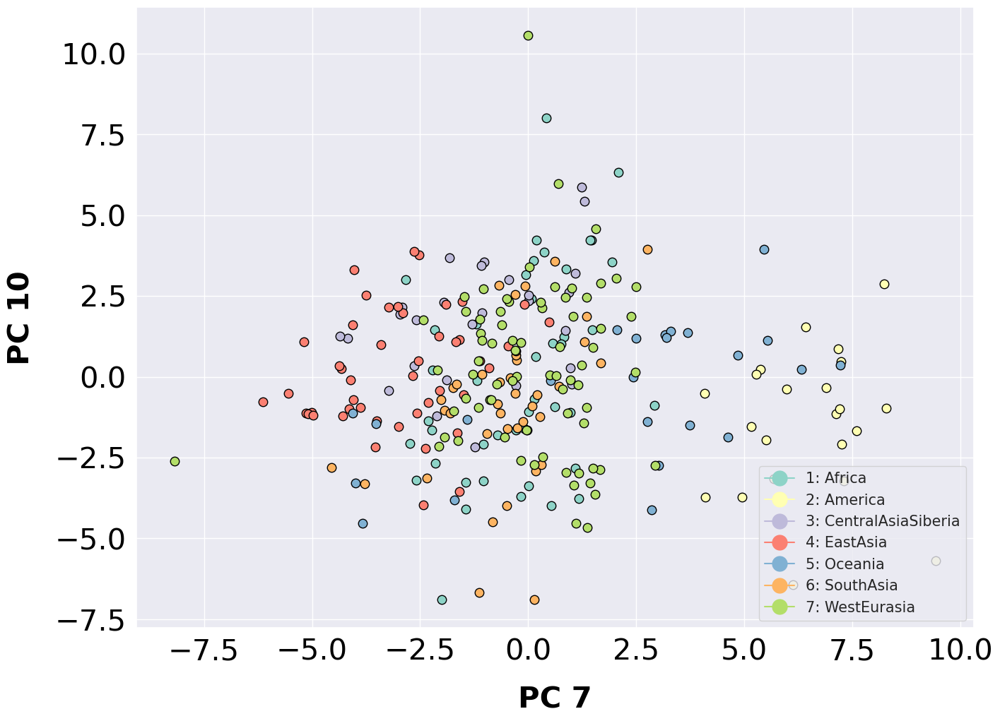

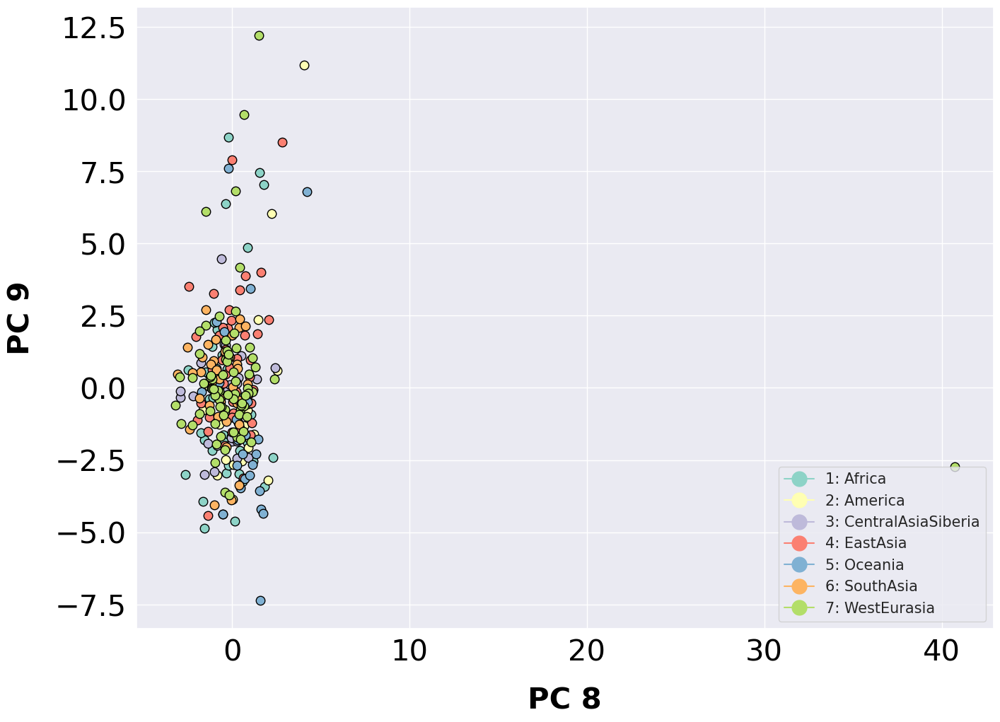

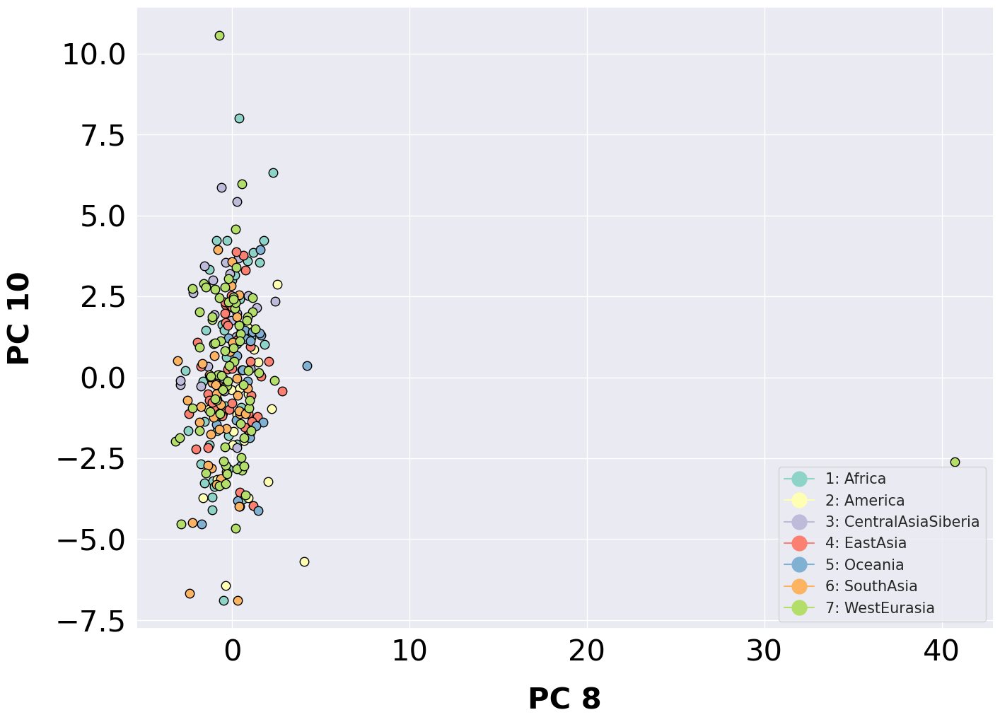

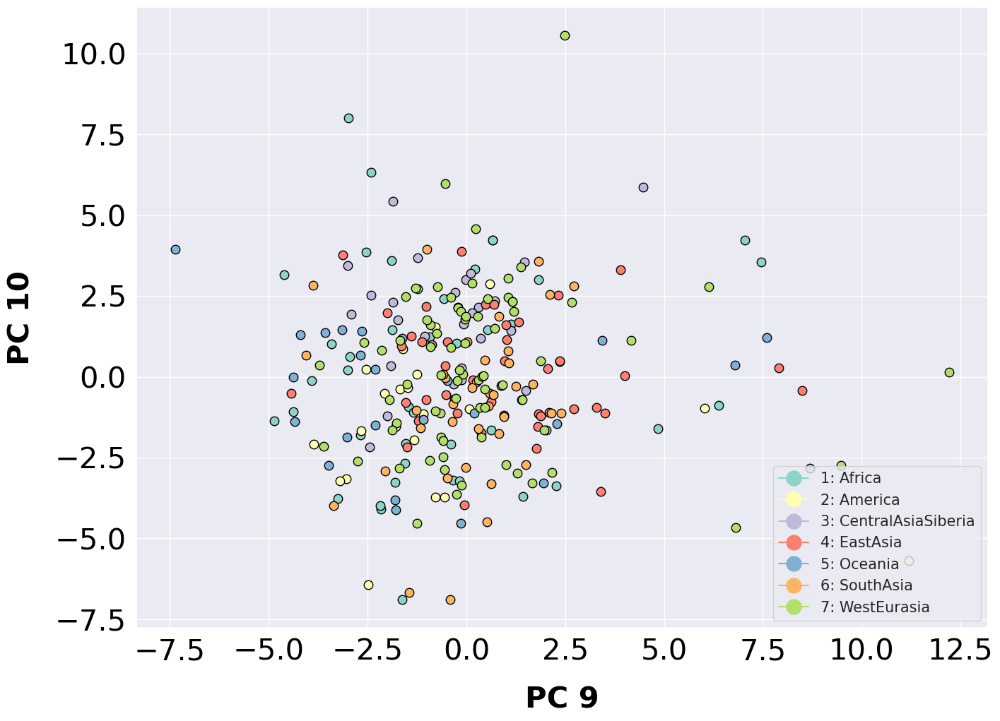

In [69]:
components = [1,2,3,4,5,6,7,8,9,10]

combinations_components = list(combinations(components,2))
for i in combinations_components:
    plot_scatter_cluster(data=df_pca, abscissa='component_'+str(i[0]), ordinate='component_'+str(i[1]), label_horizontal='PC '+ str(i[0]), label_vertical='PC '+str(i[1]), factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    #print(str(i[0]))
#    plot_scatter_cluster(data=df_pca, abscissa='component_8', ordinate='component_9', label_horizontal='Component 1', label_vertical='Component 3', factor='10-Region', fonts=define_font_properties(), colors=define_color_properties(), legend=True)
    

In [70]:
pca.explained_variance_ratio_

array([0.02588386, 0.01369235, 0.01196522, 0.01016751, 0.00927127,
       0.00808197, 0.00678781, 0.00603952, 0.00569341, 0.00514235])

In [75]:
qdnaseq_df = pd.read_csv("../data/cnvator_data_sudmant_overlapped.csv")
qdnaseq_df = qdnaseq_df.drop(columns=['Start_original', 'End_original'])
qdnaseq_df.to_csv("../data/GRCh37_cnvs.csv",  index= False)